Hello! Welcome to the autocalibration pipeline for SLAB superconducting qubits. This autocalibration code will run the following experiments in this order !!!!!!. The data will them be saved automatically to the configuration file <code>autocalibrate_cfg.yml</code> 

Initializations

In [1]:
# %matplotlib widget
%matplotlib inline

%load_ext autoreload
%autoreload 2

import numpy as np
import matplotlib.pyplot as plt

from qick import *
from qick.helpers import gauss
from tqdm import tqdm_notebook as tqdm

import time
import os
import sys
import scipy as sp
import json
import cProfile
import re 

from scipy.fft import fft, fftfreq

from slab.instruments.instrumentmanager import InstrumentManager
#from slab.instruments.instrumenttypes import Instrument
from slab.experiment import Experiment
from slab.datamanagement import SlabFile
from slab import get_next_filename, AttrDict
from datetime import datetime
import experiments as meas
import autocalib_config as cfg

import yaml
import config

# Figure params
plt.rcParams['figure.figsize'] = [10,6]
plt.rcParams.update({'font.size': 14})


Could not import QickSoc: No module named 'pynq'
Could not load InstrumentManagerWindow
Could not import QickInstrument, try install qick package
Could not load labbrick
Could not load Autonics TM4 Driver
imported experiments.clifford_averager_program
imported experiments.fitting
imported experiments.qram_protocol_timestepped
imported experiments.single_qubit.acstarkshift_spectroscopy
imported experiments.single_qubit.amplitude_rabi
imported experiments.single_qubit.DONOTUSE_ramsey_ef
imported experiments.single_qubit.DONOTUSE_randbench
imported experiments.single_qubit.length_rabi
imported experiments.single_qubit.pulse_probe_ef_spectroscopy
imported experiments.single_qubit.pulse_probe_spectroscopy
imported experiments.single_qubit.pulse_probe_spectroscopy_test
imported experiments.single_qubit.resonator_spectroscopy (1)
imported experiments.single_qubit.resonator_spectroscopy
imported experiments.single_qubit.rfsoc_tof_calibration
imported experiments.single_qubit.SingleRB
imported 

In [2]:

expt_path='C:\\_Data\\LLqub2\\Tuning_2024_04_10\\'
print('Data will be stored in', expt_path)


Data will be stored in C:\_Data\LLqub2\Tuning_2024_04_10\


In [3]:
import importlib 
importlib.reload(meas)


imported experiments.clifford_averager_program
imported experiments.fitting
imported experiments.qram_protocol_timestepped
imported experiments.single_qubit.acstarkshift_spectroscopy
imported experiments.single_qubit.amplitude_rabi
imported experiments.single_qubit.DONOTUSE_ramsey_ef
imported experiments.single_qubit.DONOTUSE_randbench
imported experiments.single_qubit.length_rabi
imported experiments.single_qubit.pulse_probe_ef_spectroscopy
imported experiments.single_qubit.pulse_probe_spectroscopy
imported experiments.single_qubit.pulse_probe_spectroscopy_test
imported experiments.single_qubit.resonator_spectroscopy (1)
imported experiments.single_qubit.resonator_spectroscopy
imported experiments.single_qubit.rfsoc_tof_calibration
imported experiments.single_qubit.SingleRB
imported experiments.single_qubit.single_shot (1)
imported experiments.single_qubit.single_shot
imported experiments.single_qubit.single_shot_ziqian
imported experiments.single_qubit.t1 (1)
imported experiments.sin

<module 'experiments' from 'c:\\_Lib\\python\\rfsoc\\elaine_rfsoc\\slab_rfsoc_expts\\experiments\\__init__.py'>

In [4]:
"""Reopen saved data"""
def prev_data(expt_path, filename):
    temp_data_file = expt_path+'/'+filename
    with SlabFile(temp_data_file) as a:
        attrs = dict()
        for key in list(a.attrs):
            attrs.update({key:json.loads(a.attrs[key])})
        keys = list(a)
        temp_data = dict()
        for key in keys:
            temp_data.update({key:np.array(a[key])})
        print(f'Extracted data and attrs {list(a.attrs)}')
    return temp_data, attrs

# Set the configuration file 

Note: make sure you set your ADC/DAC channels correctly. This code does not automatically fill in the ADC/DAC into your configuration file, so you should check yourself to make sure these values are correct. 

In [5]:
# Results config file:
cfg_file = 'autocalibration_cfg.yml'
#cfg_path = os.getcwd() + '\\' + cfg_file
#print('Results config will be', cfg_path)
cfg_path = expt_path + cfg_file
cfg_file = cfg_path 
auto_cfg = config.load(cfg_path)

auto_cfg

{'aliases': {'readout_LO': 'SC_26C1', 'soc': 'Qick233'},
 'device': {'qubit': {'T1': [100, 100, 100, 100, 100, 100],
   'f_EgGf': [2000, 2000, 2000, 2000, 2000, 2000],
   'f_ef': [4000, 4000, 4000, 4000, 4000, 4000],
   'f_ge': [3300, 3300, 3300, 3300, 3300, 3300],
   'kappa': [0, 0, 0, 0, 0, 0],
   'pulses': {'hpi_ge': {'gain': [500, 500, 500, 500, 500, 500],
     'sigma': [0.2, 0.2, 0.2, 0.2, 0.2, 0.2],
     'type': ['gauss', 'gauss', 'gauss', 'gauss', 'gauss', 'gauss']},
    'pi_EgGf': {'gain': 10000,
     'sigma': 0.1,
     'type': ['gauss', 'gauss', 'gauss', 'gauss', 'gauss', 'gauss']},
    'pi_ef': {'gain': 10000,
     'sigma': 0.1,
     'type': ['gauss', 'gauss', 'gauss', 'gauss', 'gauss', 'gauss']},
    'pi_ge': {'gain': [1000, 1000, 1000, 1000, 1000, 1000],
     'sigma': [0.01, 0.01, 0.01, 0.01, 0.01, 0.01],
     'type': ['gauss', 'gauss', 'gauss', 'gauss', 'gauss', 'gauss']}}},
  'readout': {'Max_amp': [1, 1, 1, 1, 1, 1],
   'frequency': [7096.2465,
    7130.083,
    7142.48,

In [6]:

# Connect to instruments 

im = InstrumentManager(ns_address='192.168.137.1') # SLAC lab

soc = QickConfig(im[auto_cfg['aliases']['soc']].get_cfg())
print(soc)
print(auto_cfg['aliases']['soc'])
print(soc.description())


QICK configuration:

	Board: ZCU216

	Global clocks (MHz): tProcessor 430.080, RF reference 245.760

	7 signal generator channels:
	0:	axis_signal_gen_v4 - tProc output 1, envelope memory 65536 samples
		DAC tile 2, ch 0, 32-bit DDS, fabric=430.080 MHz, fs=6881.280 MHz
	1:	axis_signal_gen_v4 - tProc output 2, envelope memory 65536 samples
		DAC tile 2, ch 1, 32-bit DDS, fabric=430.080 MHz, fs=6881.280 MHz
	2:	axis_signal_gen_v4 - tProc output 3, envelope memory 65536 samples
		DAC tile 2, ch 2, 32-bit DDS, fabric=430.080 MHz, fs=6881.280 MHz
	3:	axis_signal_gen_v4 - tProc output 4, envelope memory 65536 samples
		DAC tile 2, ch 3, 32-bit DDS, fabric=430.080 MHz, fs=6881.280 MHz
	4:	axis_signal_gen_v4 - tProc output 5, envelope memory 65536 samples
		DAC tile 3, ch 0, 32-bit DDS, fabric=430.080 MHz, fs=6881.280 MHz
	5:	axis_signal_gen_v4 - tProc output 6, envelope memory 65536 samples
		DAC tile 3, ch 1, 32-bit DDS, fabric=430.080 MHz, fs=6881.280 MHz
	6:	axis_signal_gen_v4 - tProc out

In [7]:
num_qubits = 6

# Time of Flight (TOF)

TOF measures the time it takes for the signal to run through the wires. It will give us the time in clock ticks that we should wait to make a measurements 

215 307
readout freq 0 +/- 7096.2465


  0%|          | 0/1000 [00:00<?, ?it/s]

Saving C:\_Data\LLqub2\Tuning_2024_04_10\00003_adc_trig_offset_calibration_qubit0.h5


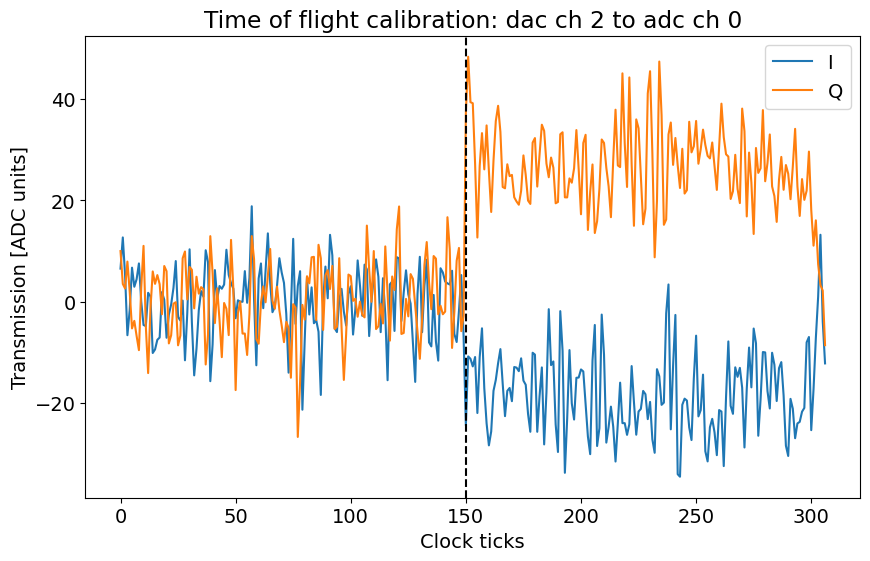

In [8]:
qubit_i = 0
tof = cfg.make_tof(soc, expt_path, cfg_path, qubit_i)

import Pyro4.util
try: 
    tof.go(analyze=False, display=False, progress=True, save=True)
except Exception:
    print("Pyro traceback:")
    print("".join(Pyro4.util.getPyroTraceback()))


tof.display(adc_trig_offset=150) 

# Coarse Resonator Spectroscopy 

Run resonator spectroscopy for all resonators by choosing a large frequency scan to look over. The scan will then find the different resonators and fill in the config file with their respective frequencies. In the autocalibration, there will be a finer sweep of each resonator to more accurately find its frequency. The frequencies are saved in <code>auto_cfg.device.readout.frequency</code>

  0%|          | 0/2500 [00:00<?, ?it/s]

Saving C:\_Data\LLqub2\Tuning_2024_04_10\00015_resonator_spectroscopy_coarse.h5
number of peaks: 4


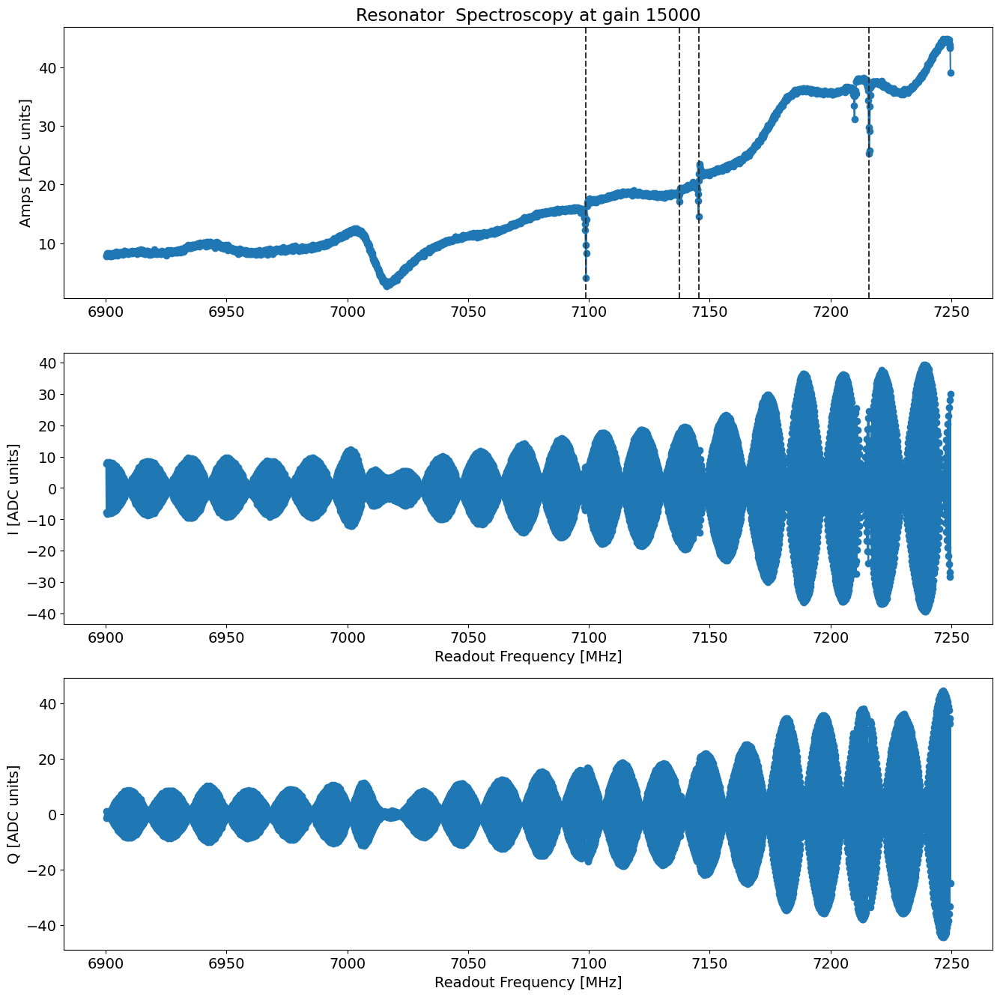

In [125]:
qubit_i=0
config.update_readout(cfg_file, 'gain', 15000, 0)
rspec = cfg.make_rspec_coarse(soc, expt_path, cfg_path, qubit_i, start=6900, span=350, reps=2000, npts=2500)
rspec.go(analyze=False, display=False, progress=True, save=True)
rspec.analyze(fit=False, coarse_scan = True)
rspec.display(fit=False, coarse_scan = True)

res_values = rspec.data['coarse_peaks']

number of peaks: 7


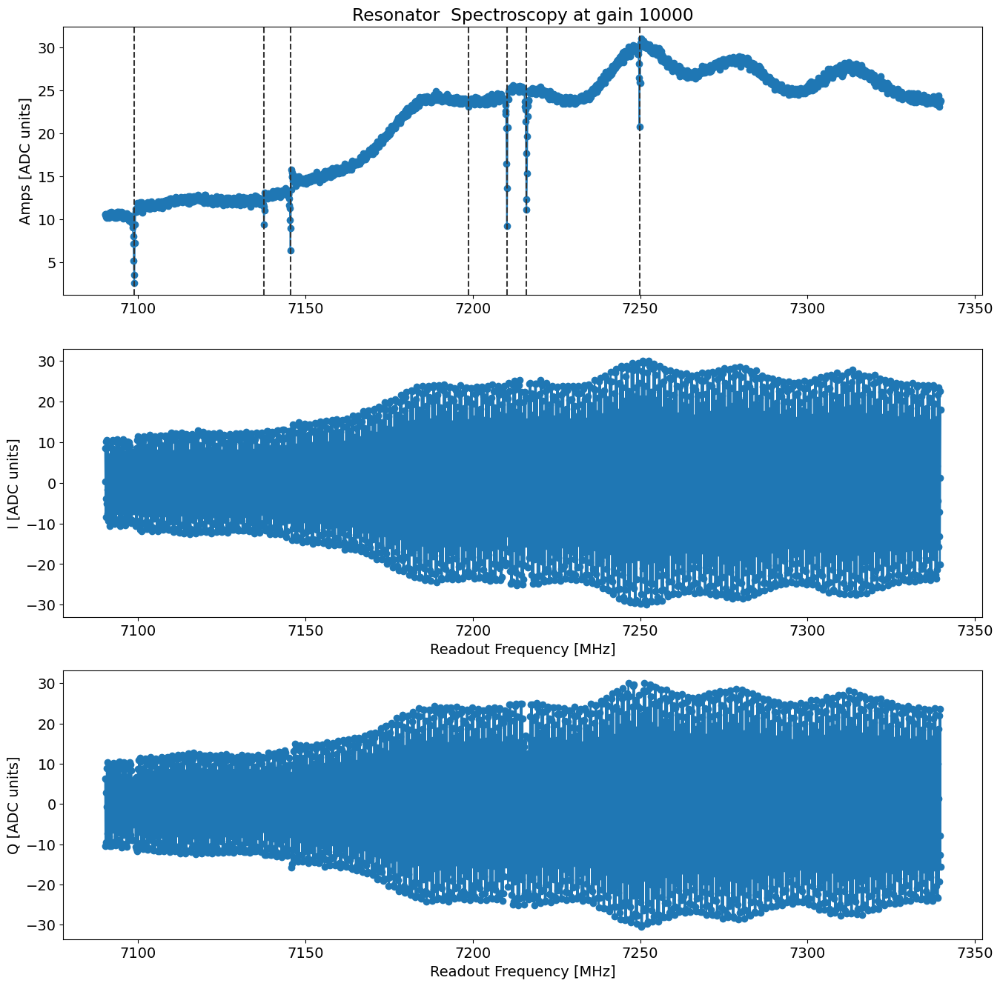

In [10]:
rspec.analyze(fit=False, findpeaks=False, coarse_scan = True)
rspec.display(fit=False, findpeaks=False, coarse_scan = True)

In [46]:
res_fine = []
kappa_fine = []
#for i in range(len(res_values)):
for i in range(0):
    # Next, run the fine scan for each to make sure they are good. 
    rspec = cfg.make_rspec_fine(soc, expt_path, cfg_path, qubit_i, i, center=res_values[i])
    rspec.go(analyze=False, display=False, progress=True, save=True)
    rspec.analyze(fit=True, findpeaks=False, coarse_scan = False)
    rspec.display(fit=True, findpeaks=False, coarse_scan = False)

    auto_cfg = config.update_readout(cfg_file, 'frequency', float(rspec.data['lorentz_fit'][2]), i)
    auto_cfg = config.update_readout(cfg_file, 'kappa', 2*rspec.data['lorentz_fit'][3], i)
    


*Set cfg resonator 5 gain to 4000*


  0%|          | 0/1000 [00:00<?, ?it/s]

Saving C:\_Data\LLqub2\Tuning_2024_04_10\00007_resonator_spectroscopy_res5.h5
From Fit:
	f0: 7249.8754434795765
	kappa[MHz]: 0.21144869329929125


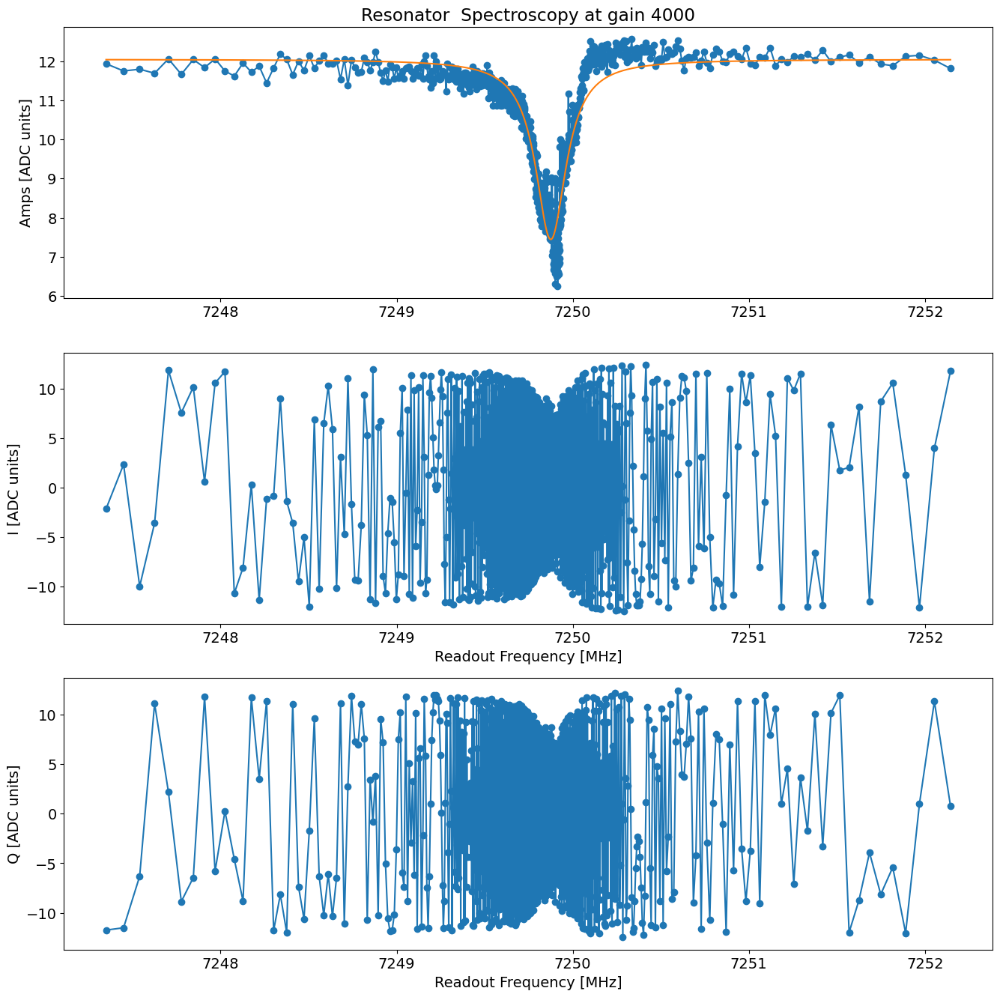

*Set cfg resonator 5 frequency to 7249.8754434795765*
*Set cfg resonator 5 kappa to 0.21144869329929125*


In [139]:
# Just run one qubit 
qubit_i = 5
config.update_readout(cfg_file, 'gain', 4000, qubit_i)

rspec = cfg.make_rspec_fine(soc, expt_path, cfg_path, qubit_i, qubit_i, center=auto_cfg['device']['readout']['frequency'][qubit_i], reps=2000)
rspec.go(analyze=False, display=False, progress=True, save=True)
rspec.analyze(fit=True, findpeaks=False, coarse_scan = False)
rspec.display(fit=True)
auto_cfg = config.update_readout(cfg_file, 'frequency', float(rspec.data['lorentz_fit'][2]), i)
auto_cfg = config.update_readout(cfg_file, 'kappa', float(2*rspec.data['lorentz_fit'][3]), i)



In [30]:
# assign the resonator frequency to the results config file
for i in range(len(res_values)):
    config.update_readout(cfg_file, 'frequency', float(res_fine[i]), i)
    config.update_readout(cfg_file, 'kappa', float(res_fine[i]), i)

    print(f'*Set cfg res {i} freq to {res_fine[i]}*')

*Set cfg res 0 freq to 7098.818504483798*
*Set cfg res 1 freq to 7137.582485492751*
*Set cfg res 2 freq to 7145.514833831296*
*Set cfg res 3 freq to 7210.194260332338*
*Set cfg res 4 freq to 7216.068856495034*
*Set cfg res 5 freq to 7249.79725344826*


If you are okay with the peaks, save data to <code>auto_cfg.device.readout.frequency</code>

# Resonator Power Spectroscopy 

Find a good value for gain to park your readout at until you run readout optimization. From the 2D sweep that is produced, choose a value for gain that is right before the resonator 'breaks' (goes from e -> f). Want to choose a high value for gain because we want to be in the shot noise limited regime which increases our signal:noise ratio. The gain value should be saved in <code>auto_cfg.device.readout.gain</code>

  0%|          | 0/21 [00:00<?, ?it/s]

Saving C:\_Data\LLqub2\Tuning_2024_04_10\00002_ResonatorPowerSweepSpectroscopyExperiment_qubit1.h5


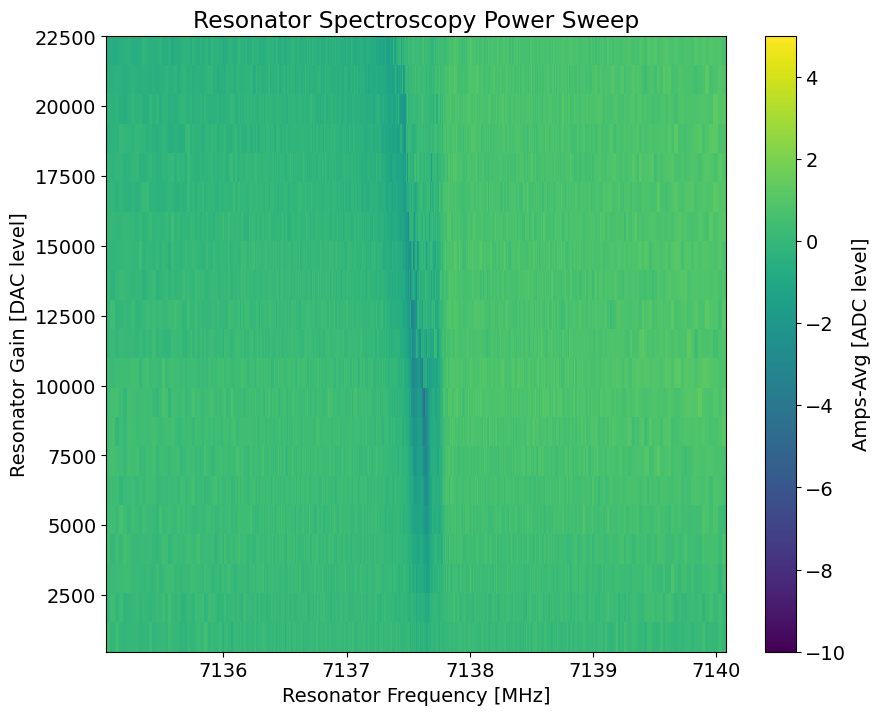

In [83]:
i = 1
rpowspec=cfg.make_rpowspec(soc, expt_path, cfg_path, i, auto_cfg['device']['readout']['frequency'][i], npts_f=1000, npts_gain=20, start_gain=1000, span_gain=21000, smart=True, reps=2000)
rpowspec.go(analyze=False, display=False, progress=True, save=True)

# Testing 
rpowspec.analyze(fit=False, lowgain=None, highgain=None)
rpowspec.display(fit=False)

In [96]:
# assign the resonator gain to the results config file
gain_values = [12000, 4000, 8000, 6000, 8750, 4000]
for i in range(num_qubits):
    auto_cfg = config.update_readout(cfg_file, 'gain', int(gain_values[i]), i)
    print(f'*Set cfg res {i} gain to {gain_values[i]}*')

*Set cfg res 0 gain to 12000*
*Set cfg res 1 gain to 4000*
*Set cfg res 2 gain to 8000*
*Set cfg res 3 gain to 6000*
*Set cfg res 4 gain to 8750*
*Set cfg res 5 gain to 4000*


In [95]:
auto_cfg['device']['readout']['gain']

[12000.0, 4000.0, 8000.0, 6000.0, 8750.0, 4000.0]

# Qubit Spectroscopy Coarse Scan 

Running qubit spectroscopy for qubit 5


  0%|          | 0/20 [00:00<?, ?it/s]

Saving C:\_Data\LLqub2\Tuning_2024_04_10\00002_qubit_spectroscopy_coarse_qubit5.h5
Found peak in amps at [MHz] [3134.8, 9.771058959269489]


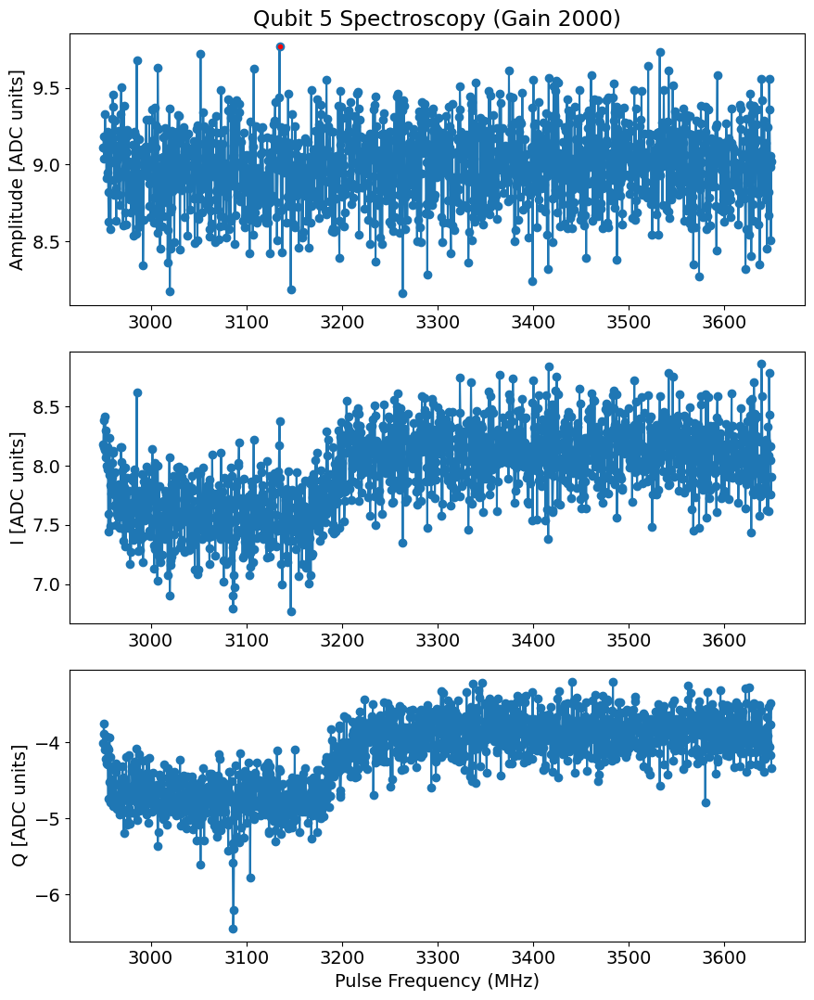

  0%|          | 0/20 [00:00<?, ?it/s]

Saving C:\_Data\LLqub2\Tuning_2024_04_10\00003_qubit_spectroscopy_coarse_qubit5.h5
Found peak in amps at [MHz] 3135.0853459814657, HWHM -0.11408282630662836
Found peak in I at [MHz] 3134.9276323353492, HWHM 0.32954351089789835
Found peak in Q at [MHz] 3134.6759520990763, HWHM -0.0030112902207110586


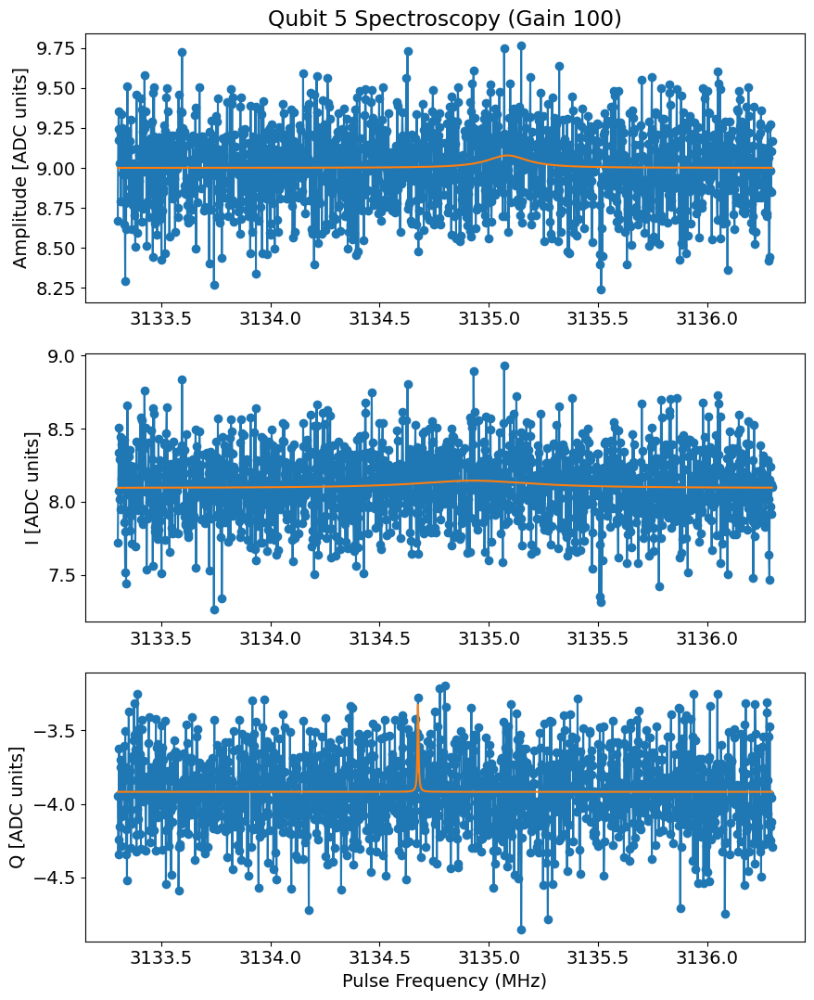

In [129]:
qspec_list = []
#for i in range(num_qubits): 
#for i in range(1):
i=5
auto_cfg = config.update_qubit(cfg_file, 'f_ge', float(3300), i)

print('Running qubit spectroscopy for qubit', i)
qspec = cfg.make_qspec(soc, expt_path, cfg_path, i, coarse=True)
qspec.go(analyze=False, display=False, progress=True, save=True)

qspec.analyze(fit=False, coarse=True)
qspec.display(fit=False, coarse=True)
auto_cfg = config.update_qubit(cfg_file, 'f_ge', float(qspec.data["fit_amps"][0]), i)


qspec = cfg.make_qspec(soc, expt_path, cfg_path, i, coarse=False)
qspec.go(analyze=False, display=False, progress=True, save=True)

qspec.analyze(fit=True, signs = [1,-1,1])
qspec.display(fit=True, signs= [1, -1, 1])
#qspec_list[i]=qspec.data["fit_amps"][2]  
auto_cfg = config.update_qubit(cfg_file, 'f_ge', float(qspec.data["fit_amps"][2]), i)
auto_cfg = config.update_qubit(cfg_file, 'kappa', float(2*qspec.data["fit_amps"][3]), i)

print(f'*Set cfg qubit {i} freq to {auto_cfg.device.qubit.f_ge[i]} MHz*')
print(f'*Set cfg qubit {i} kappa to {auto_cfg.device.qubit.kappa[i]} MHz*')

In [121]:
auto_cfg['device']['readout']['frequency']

[7098.818504483798,
 7137.582485492751,
 7145.514833831296,
 7210.194260332338,
 7216.068856495034,
 7249.79725344826]

In [122]:
auto_cfg['device']['qubit']['f_ge']

[3308.967679200794,
 3075.591168213095,
 3347.558604972893,
 3547.54063003987,
 3266.0283125304486,
 3233.842766043342]

# Autocalibration 

We have now completed the necessary steps to run the full autocalibration of the qubits. The code below will run xxx and save all results to <code>autocalibration_cfg.yml</code>

Running analysis for qubit:  0 ...


  0%|          | 0/500 [00:00<?, ?it/s]

From Fit:
	f0: 7098.805179516283
	kappa[MHz]: 0.29627055450327905


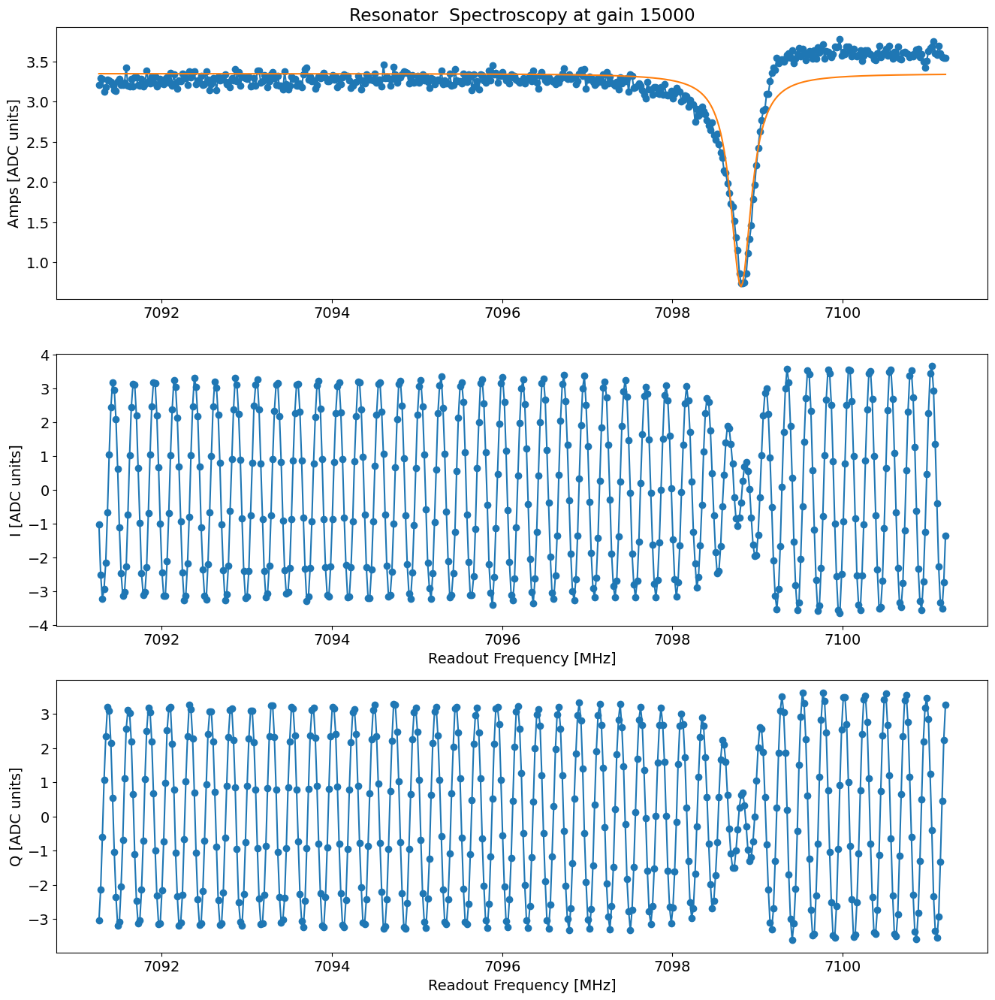

*Set cfg res 0 freq to 7098.805179516283 Mhz*
*Set cfg res 0 kappa to 0.29627055450327905 MHz*


  0%|          | 0/20 [00:00<?, ?it/s]

Found peak in amps at [MHz] 3297.2944222365104, HWHM 3.3697191376531497
Found peak in I at [MHz] 3295.9003293457185, HWHM 0.036898501140038585
Found peak in Q at [MHz] 3303.718764381412, HWHM 4.932161569992266


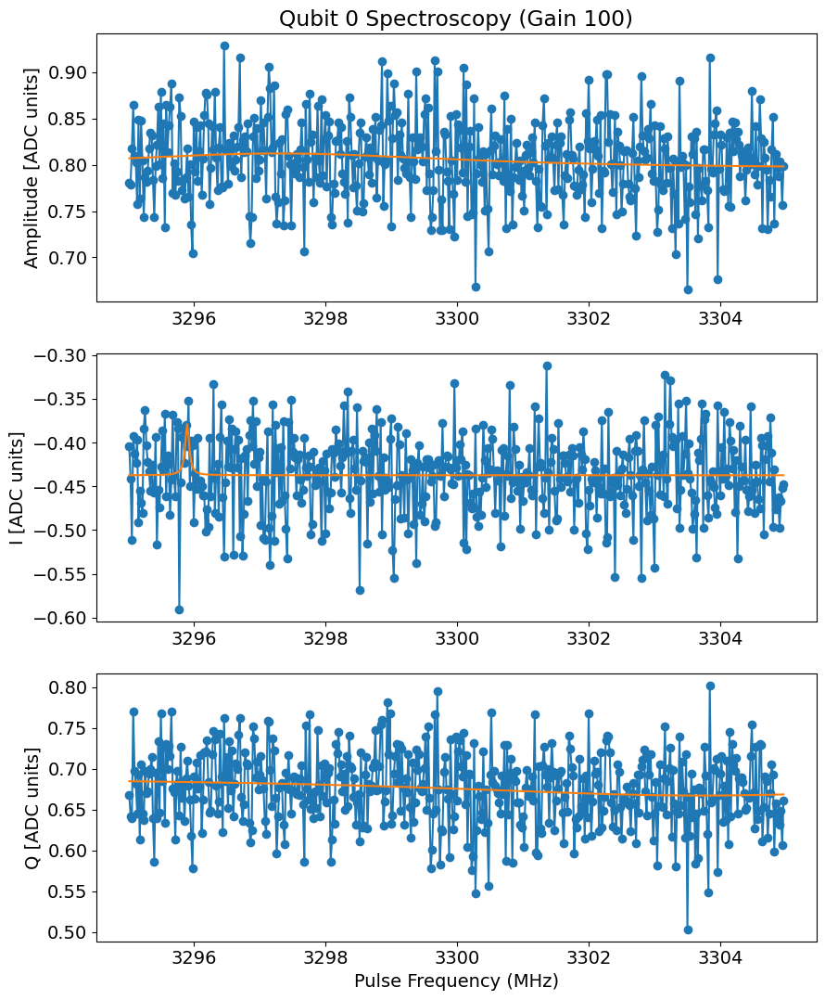

*Set cfg qubit 0 freq to 3297.2944222365104 MHz*
*Set cfg qubit 0 kappa to 6.739438275306299 MHz*


  0%|          | 0/100 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 69.50787878787878, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Attempted to init fitparam 1 to 199.8351515151515, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Attempted to init fitparam 1 to 199.8351515151515, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Decay from avgi [us] 0.06835937500000001
Pi length from avgi data [us]: 0.018513243663657867
	Pi/2 length from avgi data [us]: 0.009256621831828933

Decay from avgq [us] 0.06835937500000001
Pi length from avgq data [us]: 0.011608796142989783
Pi/2 length from avgq data [us]: 0.005804398071494891


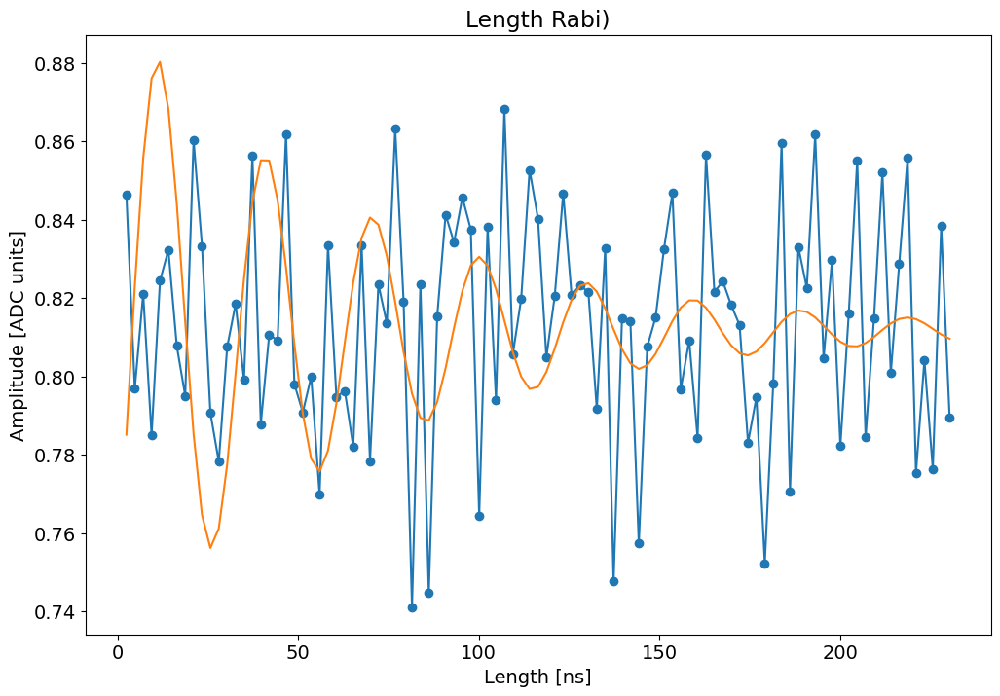

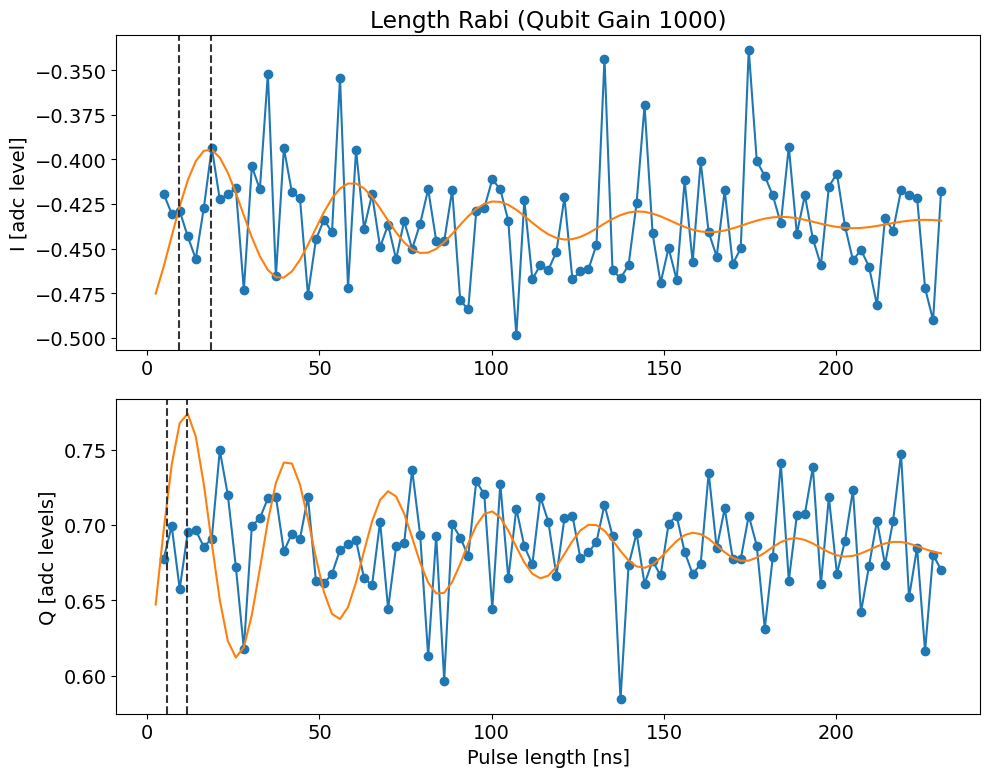

*Set cfg qubit 0 rabi length to 0.018513243663657867* us
qTest =  0.018513243663657867
gauss


  0%|          | 0/200000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.019095477386934675, which is out of bounds 5.0505050505050505e-05 to 0.005050505050505051. Instead init to 0.002550505050505051
Attempted to init fitparam 1 to 0.04572864321608041, which is out of bounds 5.0505050505050505e-05 to 0.005050505050505051. Instead init to 0.002550505050505051
Attempted to init fitparam 1 to 0.04572864321608041, which is out of bounds 5.0505050505050505e-05 to 0.005050505050505051. Instead init to 0.002550505050505051
Pi gain from amps data [dac units]: 121
	Pi/2 gain from amps data [dac units]: 60
Pi gain from avgi data [dac units]: 112
	Pi/2 gain from avgi data [dac units]: 56
Pi gain from avgq data [dac units]: 134
	Pi/2 gain from avgq data [dac units]: 67


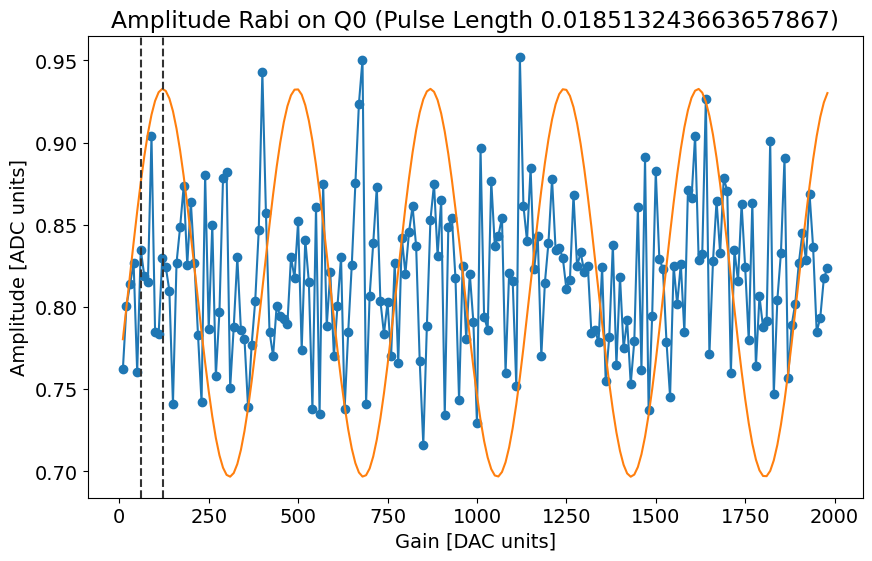

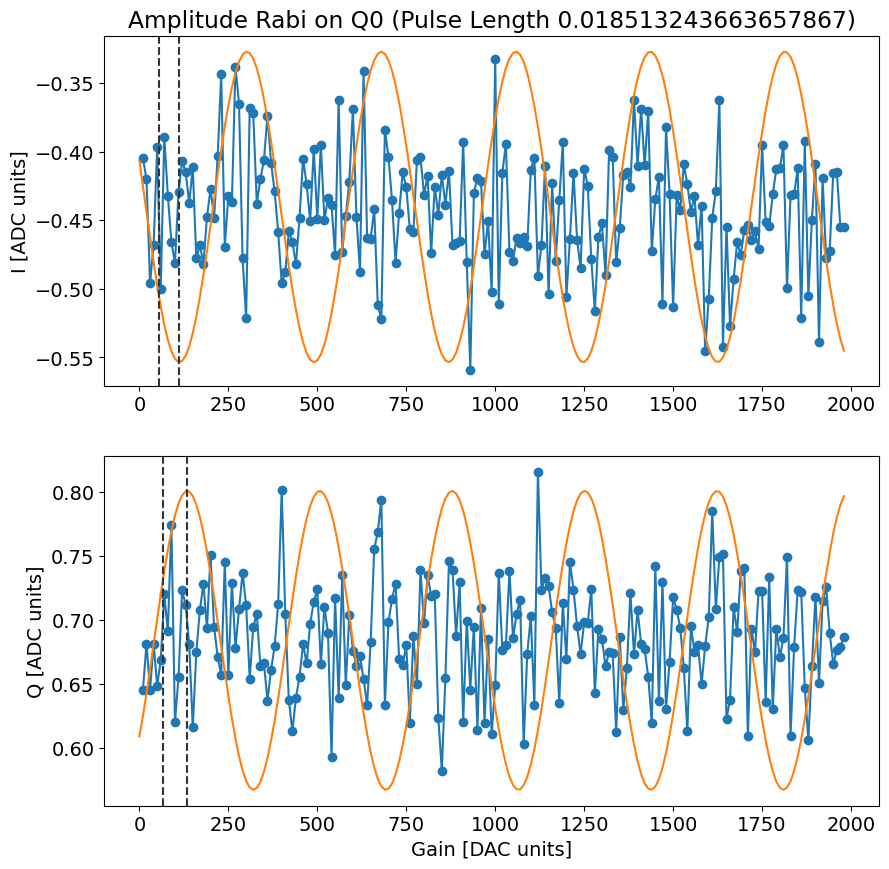

*Set cfg qubit 0 rabi amplitude to 112* DAC units


  0%|          | 0/60000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.28762541806020064, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Attempted to init fitparam 1 to 0.1605351170568562, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Attempted to init fitparam 1 to 0.5284280936454849, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Current pi pulse frequency: 3297.2944222365104
Fit frequency from amps [MHz]: 0.012292194061963453 +/- 0.004555668856532672
Suggested new pi pulse frequencies from fit amps [MHz]:
 	3299.2821300424484
 	3295.2821300424484
T2 Ramsey from fit amps [us]: 44.7
Current pi pulse frequency: 3297.2944222365104
Fit frequency from I [MHz]: 0.0433914395177654 +/- 0.0005200815919418183
Suggested new pi pulse frequency from fit I [MHz]:
 	3299.251030796993
 	3295.251030796993
T2 Ramsey from fit I [us]: 44.7
Fit frequency from Q [MHz]: 

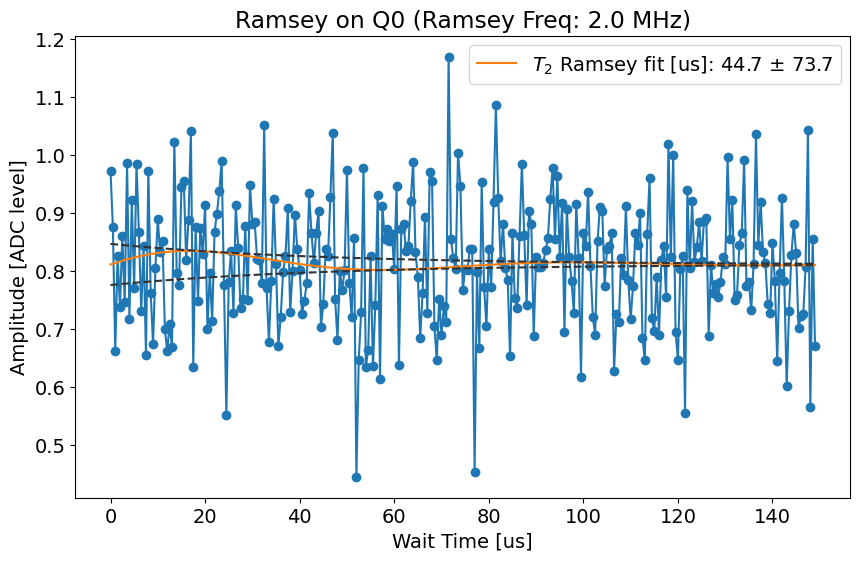

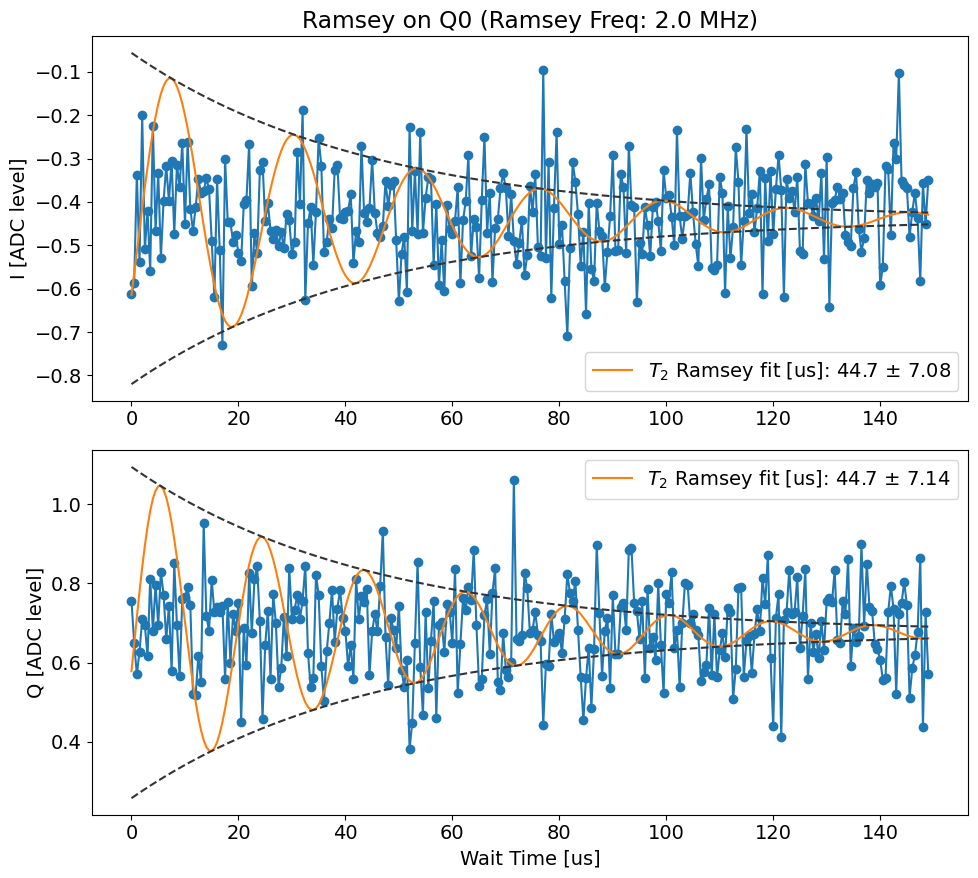

Replacing 3297.2944222365104 with 3295.251030796993 in results cfg file
qTest =  0.018513243663657867
gauss


  0%|          | 0/200000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.030485762144053602, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Attempted to init fitparam 1 to 0.02613065326633166, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Attempted to init fitparam 1 to 0.02747068676716918, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Pi gain from amps data [dac units]: 326
	Pi/2 gain from amps data [dac units]: 163
Pi gain from avgi data [dac units]: 273
	Pi/2 gain from avgi data [dac units]: 136
Pi gain from avgq data [dac units]: 329
	Pi/2 gain from avgq data [dac units]: 164


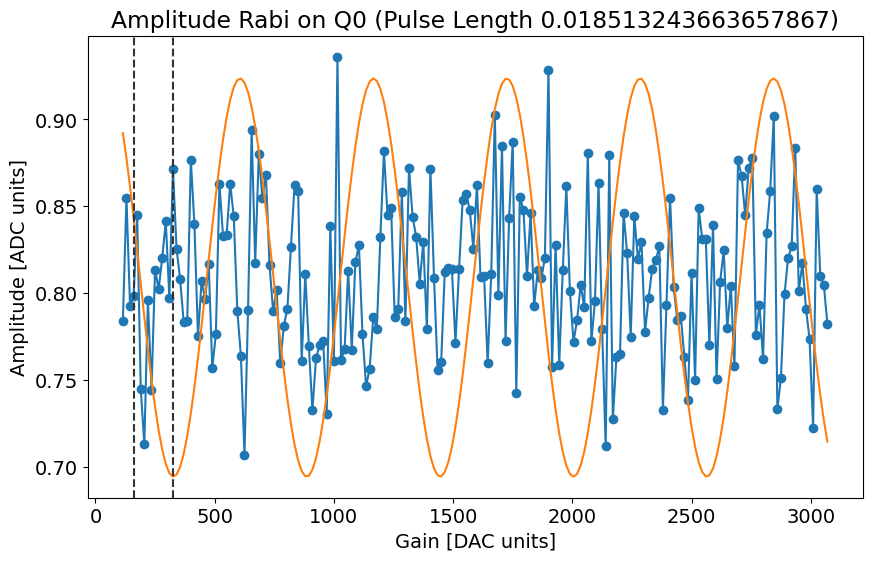

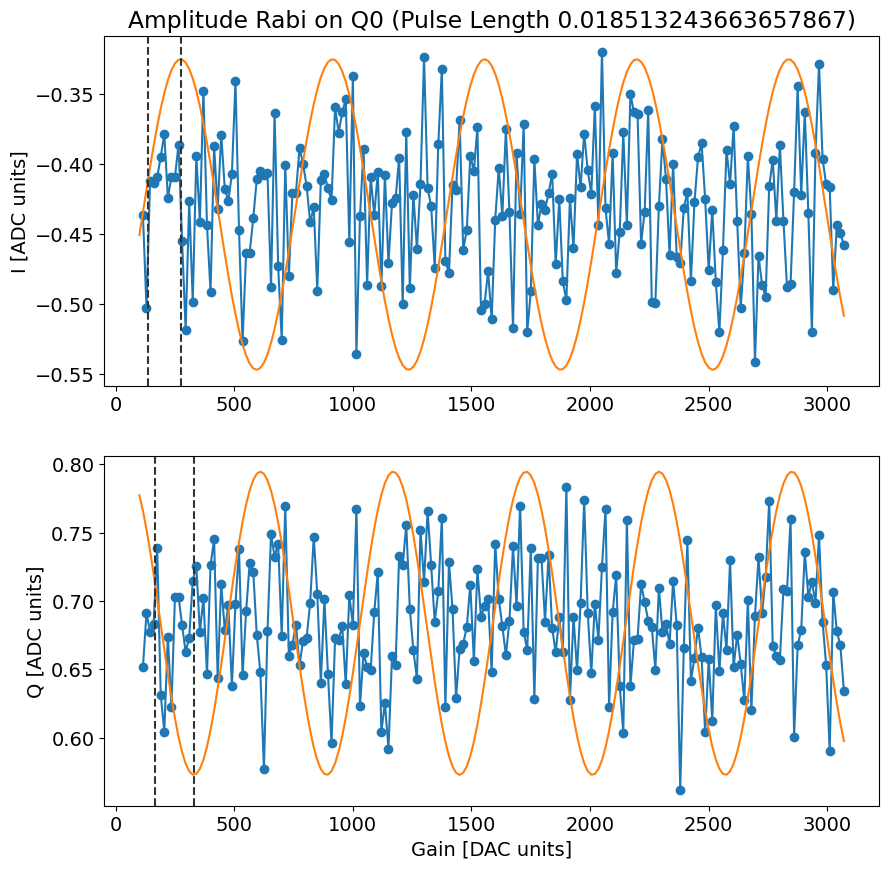

*Set cfg qubit 0 rabi amplitude to 273* DAC units


  0%|          | 0/200000 [00:00<?, ?it/s]

c:\_Lib\python\rfsoc\elaine_rfsoc\slab_rfsoc_expts\experiments\fitting.py:65: RuntimeWarning: overflow encountered in exp
  return y0 + yscale*np.exp(-(x-x0)/decay)


Fit T1 avgi [us]: 202332.747367787
Fit T1 avgq [us]: 173184.03228585364


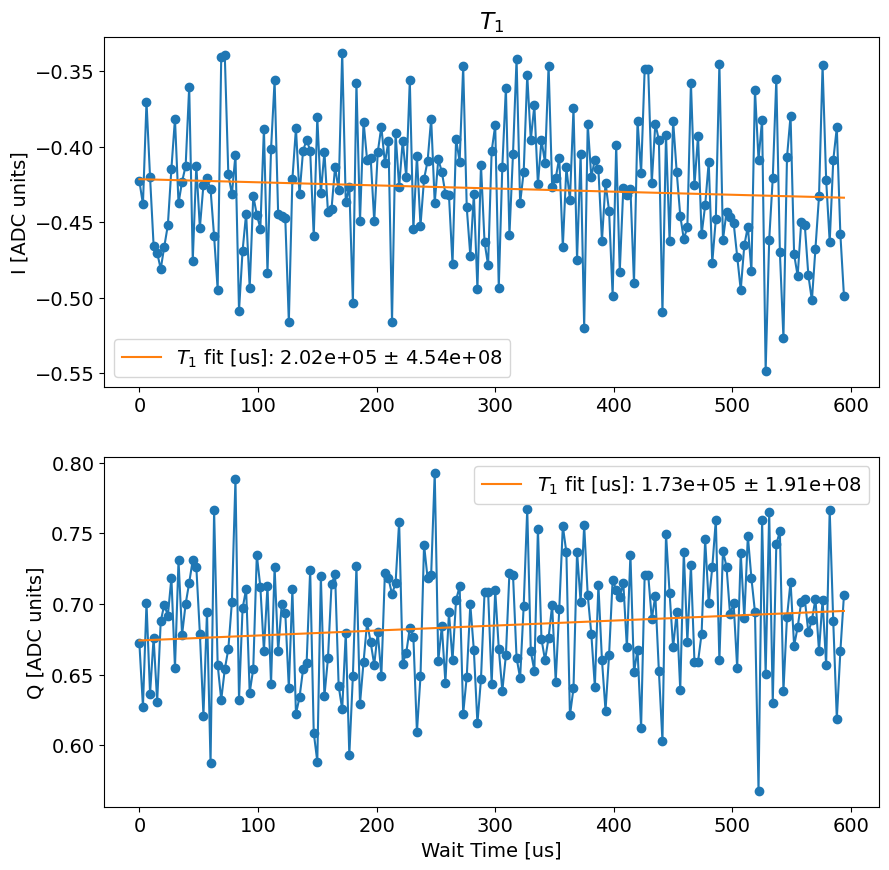

t1_i error:fit ratio= 2245.697680142248
t1_q error:fit ratio= 1101.3000173886244
t1_q is better, saving t1_q to results cfg file
*Set cfg qubit 0 T1 to 173184.03228585364* us
Running analysis for qubit:  1 ...


  0%|          | 0/500 [00:00<?, ?it/s]

From Fit:
	f0: 7123.050751442349
	kappa[MHz]: 748.1508156384285


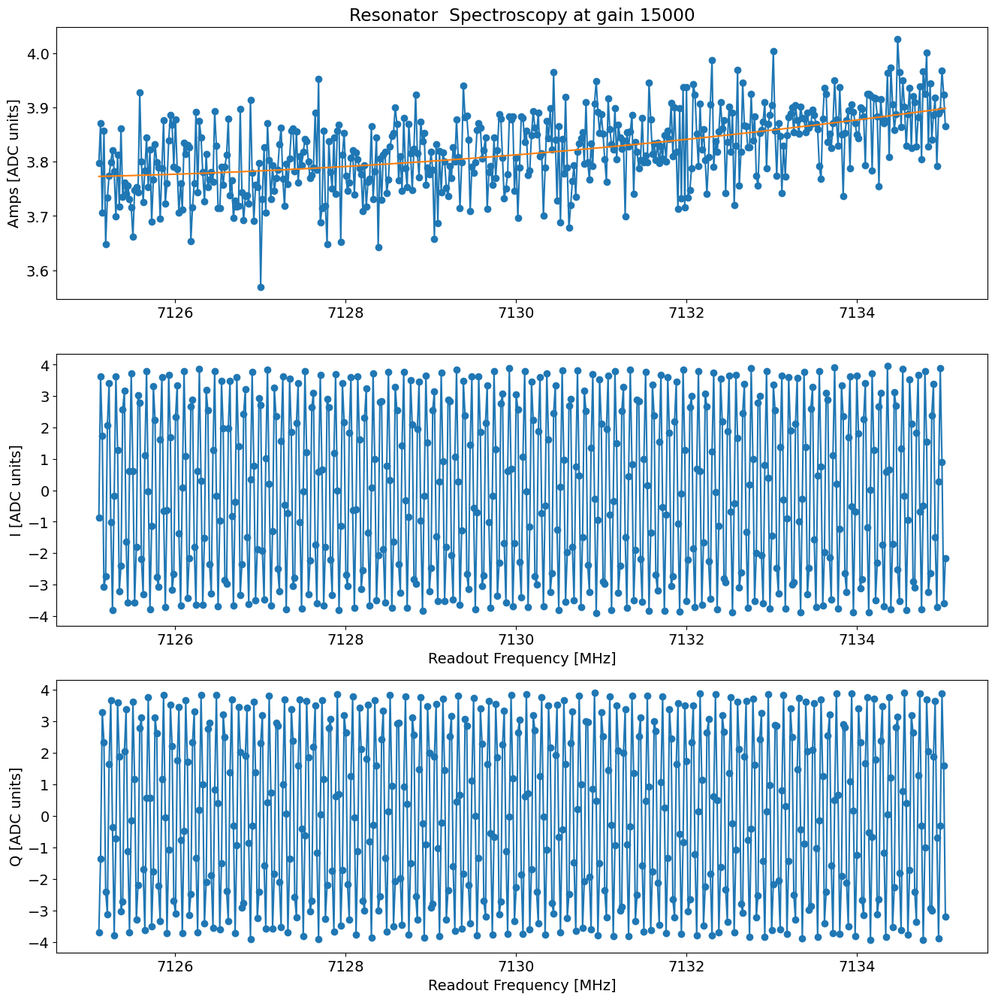

*Set cfg res 1 freq to 7123.050751442349 Mhz*
*Set cfg res 1 kappa to 748.1508156384285 MHz*


  0%|          | 0/20 [00:00<?, ?it/s]

Found peak in amps at [MHz] 3296.2085800452605, HWHM 0.12648496332988426
Found peak in I at [MHz] 3299.764103303798, HWHM 0.18522504591661562
Found peak in Q at [MHz] 3296.217293002395, HWHM 0.11423979920441056


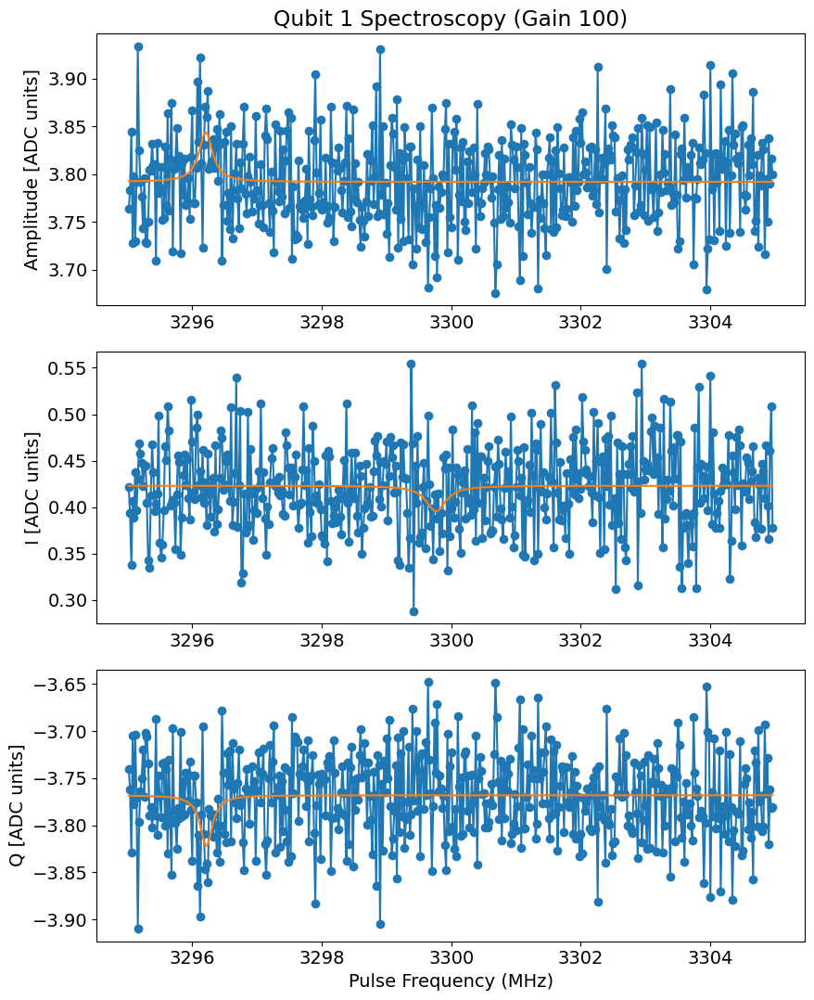

*Set cfg qubit 1 freq to 3296.2085800452605 MHz*
*Set cfg qubit 1 kappa to 0.25296992665976853 MHz*


  0%|          | 0/100 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 169.42545454545453, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Attempted to init fitparam 1 to 199.8351515151515, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Attempted to init fitparam 1 to 191.14666666666665, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Decay from avgi [us] 0.06835937500000001
Pi length from avgi data [us]: 0.009642640521443995
	Pi/2 length from avgi data [us]: 0.004821320260721997

Decay from avgq [us] 0.06835937500000001
Pi length from avgq data [us]: 0.013686622570891078
Pi/2 length from avgq data [us]: 0.006843311285445539


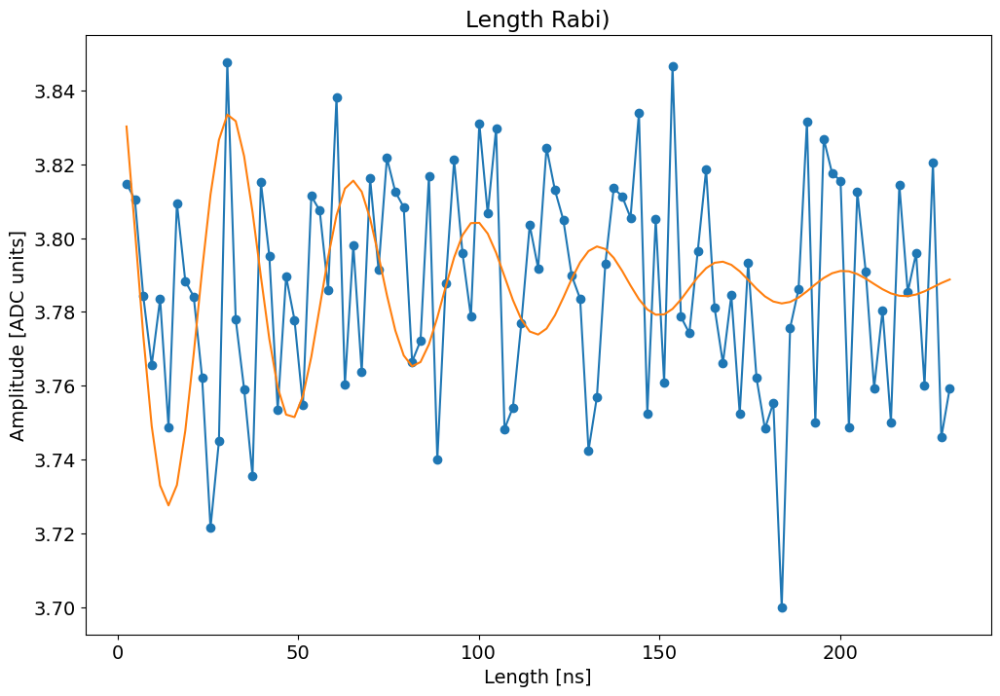

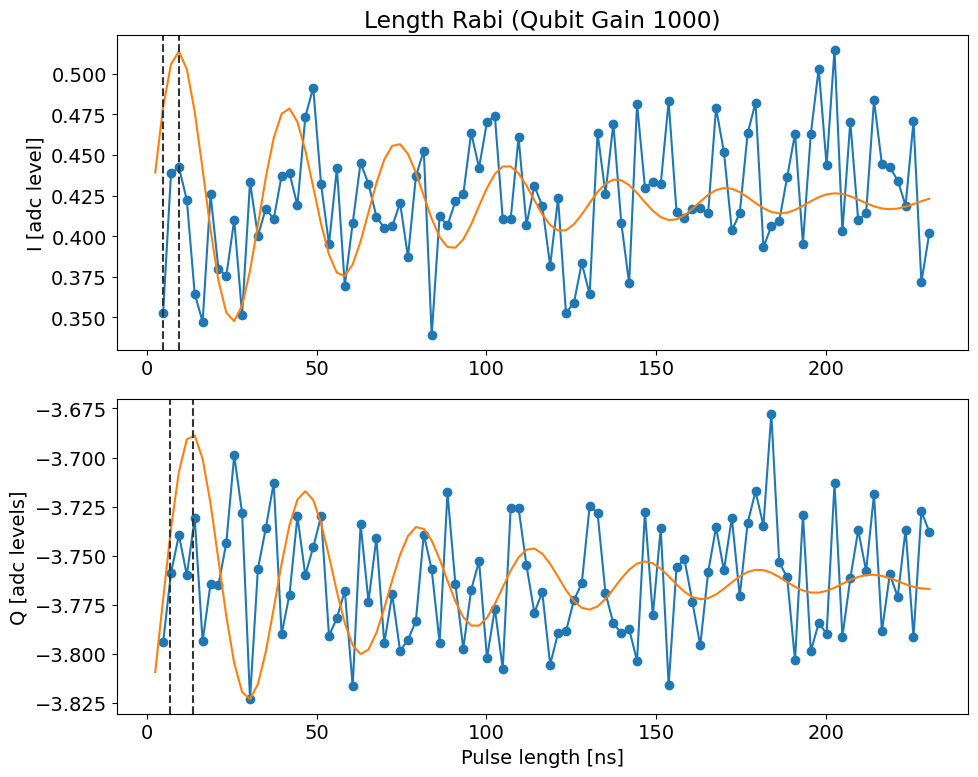

*Set cfg qubit 1 rabi length to 0.009642640521443995* us
qTest =  0.009642640521443995
gauss


  0%|          | 0/200000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.030150753768844223, which is out of bounds 5.0505050505050505e-05 to 0.005050505050505051. Instead init to 0.002550505050505051
Attempted to init fitparam 1 to 0.008542713567839196, which is out of bounds 5.0505050505050505e-05 to 0.005050505050505051. Instead init to 0.002550505050505051
Attempted to init fitparam 1 to 0.008542713567839196, which is out of bounds 5.0505050505050505e-05 to 0.005050505050505051. Instead init to 0.002550505050505051
Pi gain from amps data [dac units]: 103
	Pi/2 gain from amps data [dac units]: 51
Pi gain from avgi data [dac units]: 147
	Pi/2 gain from avgi data [dac units]: 73
Pi gain from avgq data [dac units]: 98
	Pi/2 gain from avgq data [dac units]: 49


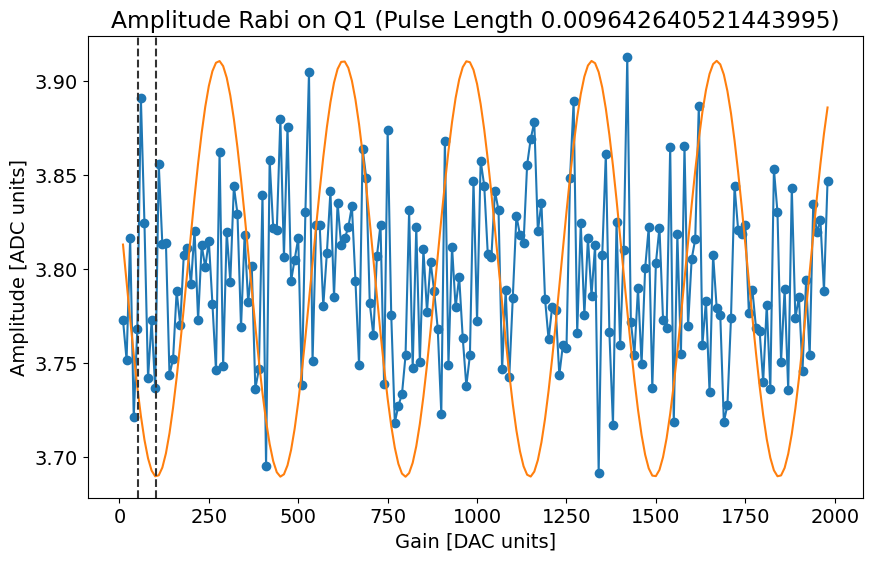

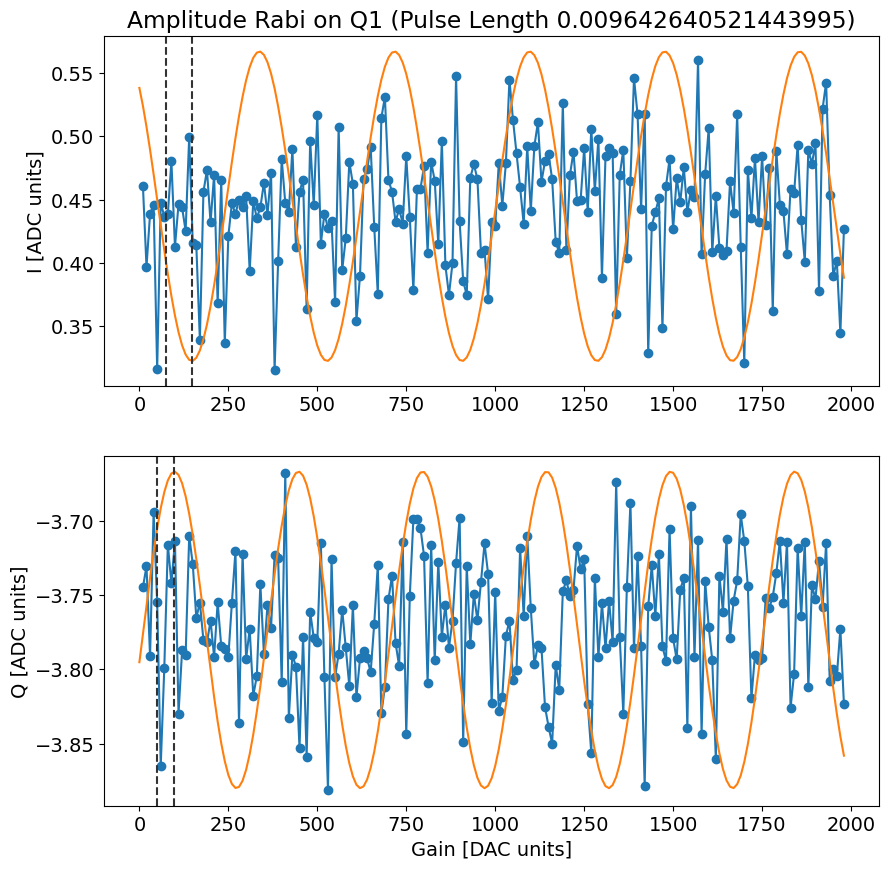

*Set cfg qubit 1 rabi amplitude to 147* DAC units


  0%|          | 0/60000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.1806020066889632, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Attempted to init fitparam 1 to 0.6287625418060201, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Attempted to init fitparam 1 to 0.3210702341137124, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Current pi pulse frequency: 3296.2085800452605
Fit frequency from amps [MHz]: 0.05551095538125147 +/- 0.0005918011837926597
Suggested new pi pulse frequencies from fit amps [MHz]:
 	3298.1530690898794
 	3294.1530690898794
T2 Ramsey from fit amps [us]: 44.7
Current pi pulse frequency: 3296.2085800452605
Fit frequency from I [MHz]: 0.04159887930044983 +/- 0.0006117160968017722
Suggested new pi pulse frequency from fit I [MHz]:
 	3298.16698116596
 	3294.16698116596
T2 Ramsey from fit I [us]: 44.7
Fit frequency from Q [MHz]: 0.

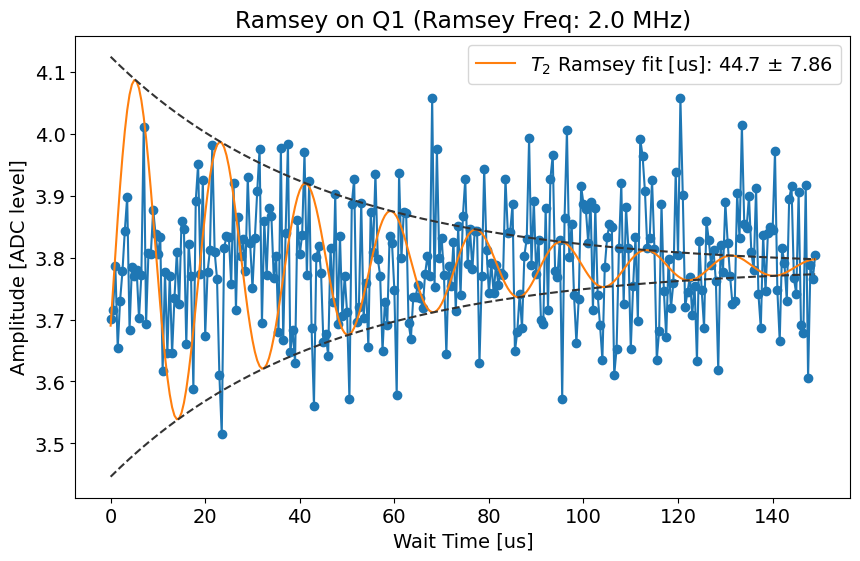

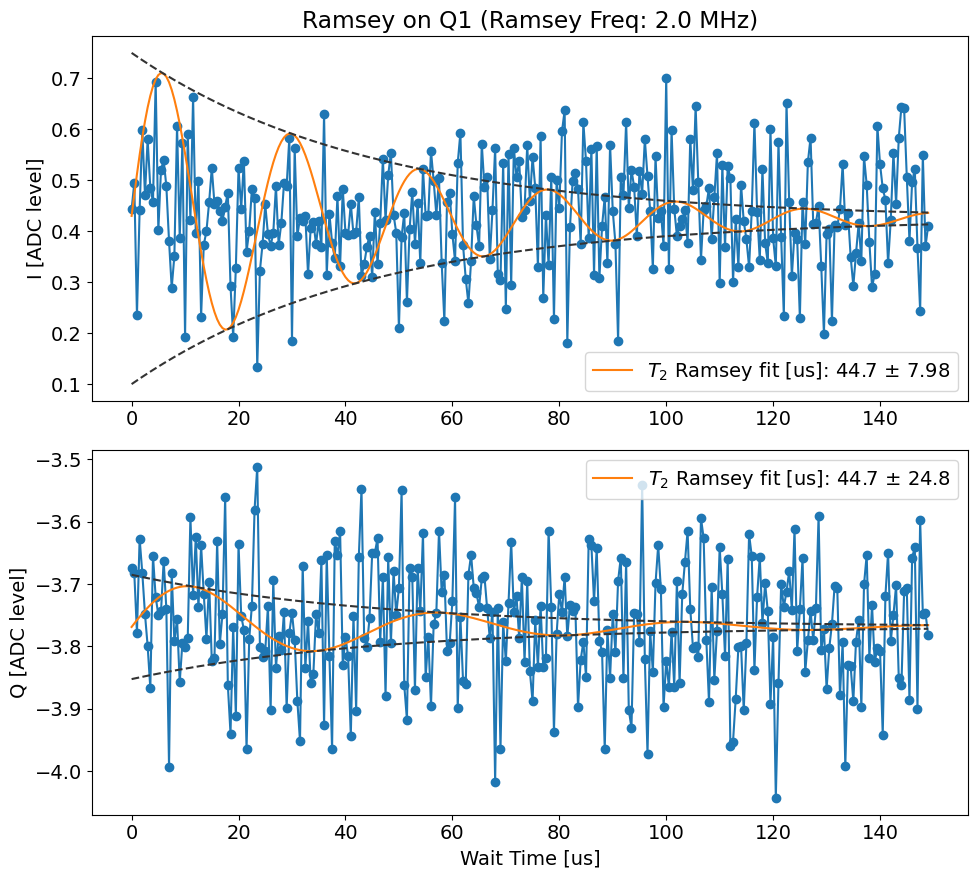

Replacing 3296.2085800452605 with 3294.1530690898794 in results cfg file
qTest =  0.009642640521443995
gauss


  0%|          | 0/200000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.006700167504187605, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Attempted to init fitparam 1 to 0.017085427135678392, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Pi gain from amps data [dac units]: 336
	Pi/2 gain from amps data [dac units]: 168
Pi gain from avgi data [dac units]: 13567
	Pi/2 gain from avgi data [dac units]: 6783
Pi gain from avgq data [dac units]: 333
	Pi/2 gain from avgq data [dac units]: 166


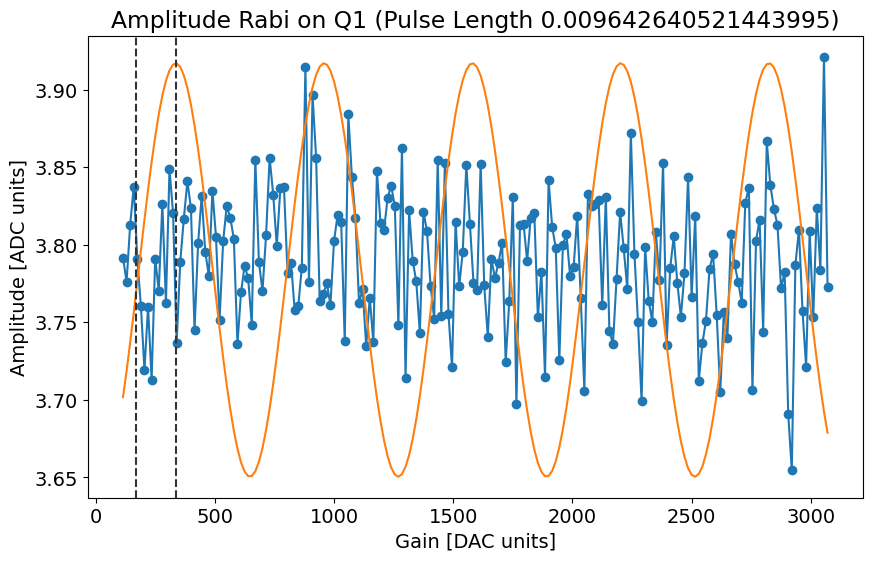

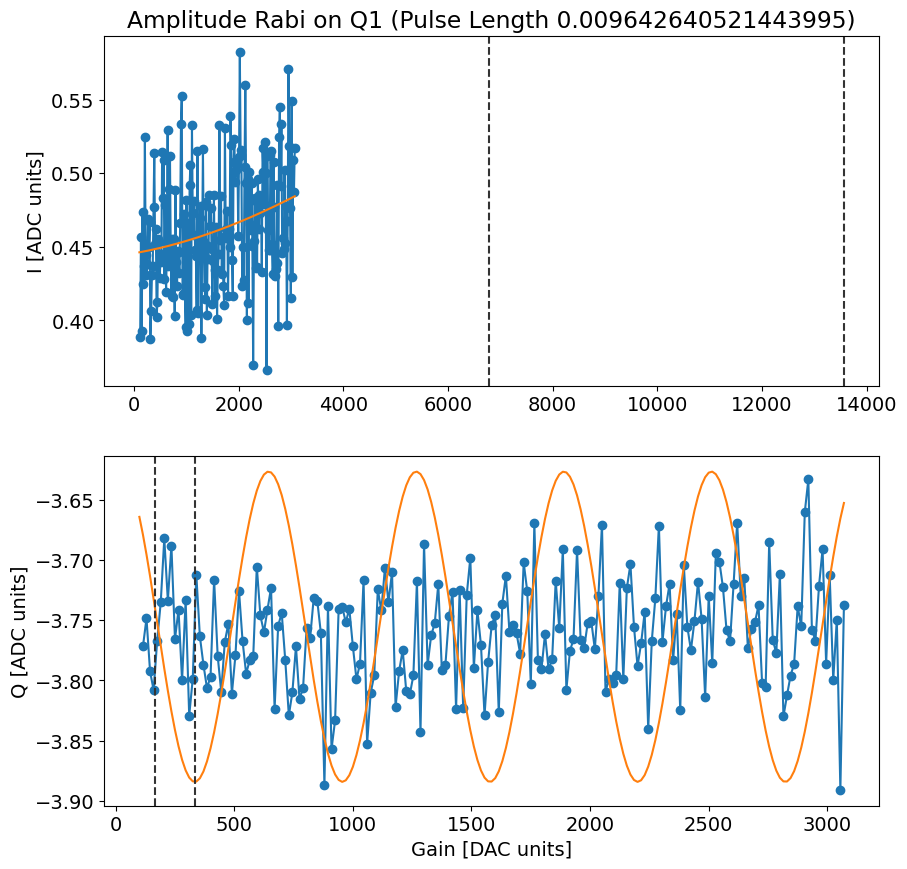

*Set cfg qubit 1 rabi amplitude to 13567* DAC units


  0%|          | 0/200000 [00:00<?, ?it/s]

c:\Users\slab\anaconda3\envs\slab\lib\site-packages\scipy\optimize\_minpack_py.py:881: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


Fit T1 avgi [us]: -28.99439105667561
Fit T1 avgq [us]: 226771.83929557732


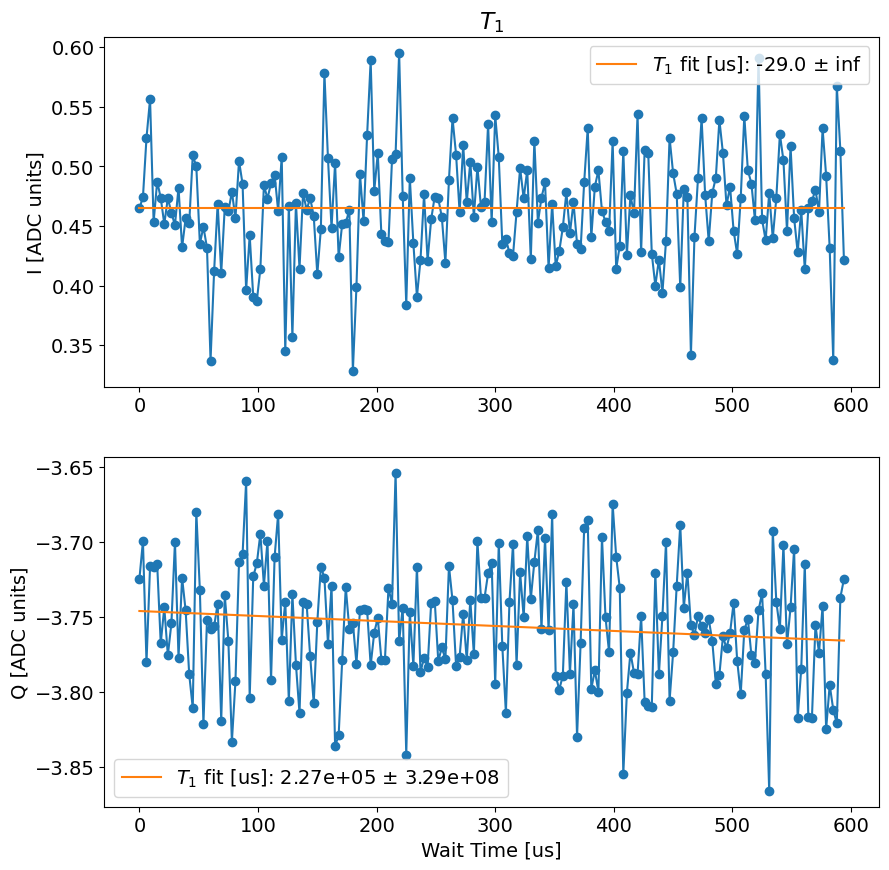

t1_i error:fit ratio= -inf
t1_q error:fit ratio= 1452.4740874805111
t1_i is better, saving T1_i to results cfg file
*Set cfg qubit 1 T1 to -28.99439105667561* us
Running analysis for qubit:  2 ...


  0%|          | 0/500 [00:00<?, ?it/s]

From Fit:
	f0: 7145.387519574982
	kappa[MHz]: 0.17485313479913492


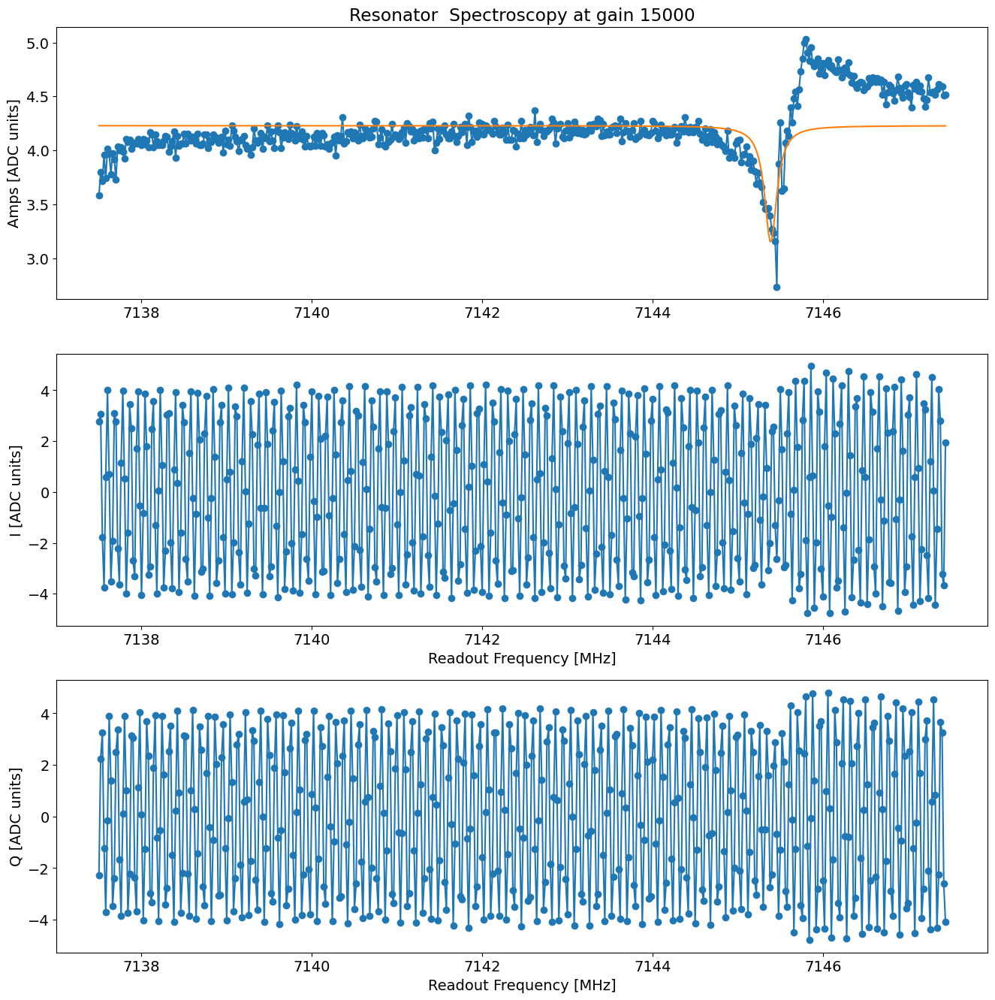

*Set cfg res 2 freq to 7145.387519574982 Mhz*
*Set cfg res 2 kappa to 0.17485313479913492 MHz*


  0%|          | 0/20 [00:00<?, ?it/s]

Found peak in amps at [MHz] 3299.5509642599905, HWHM -0.00022387111424441533
Found peak in I at [MHz] 3302.4466961153266, HWHM 289.6721962598812
Found peak in Q at [MHz] 3299.5527595651038, HWHM 0.01435125394756625


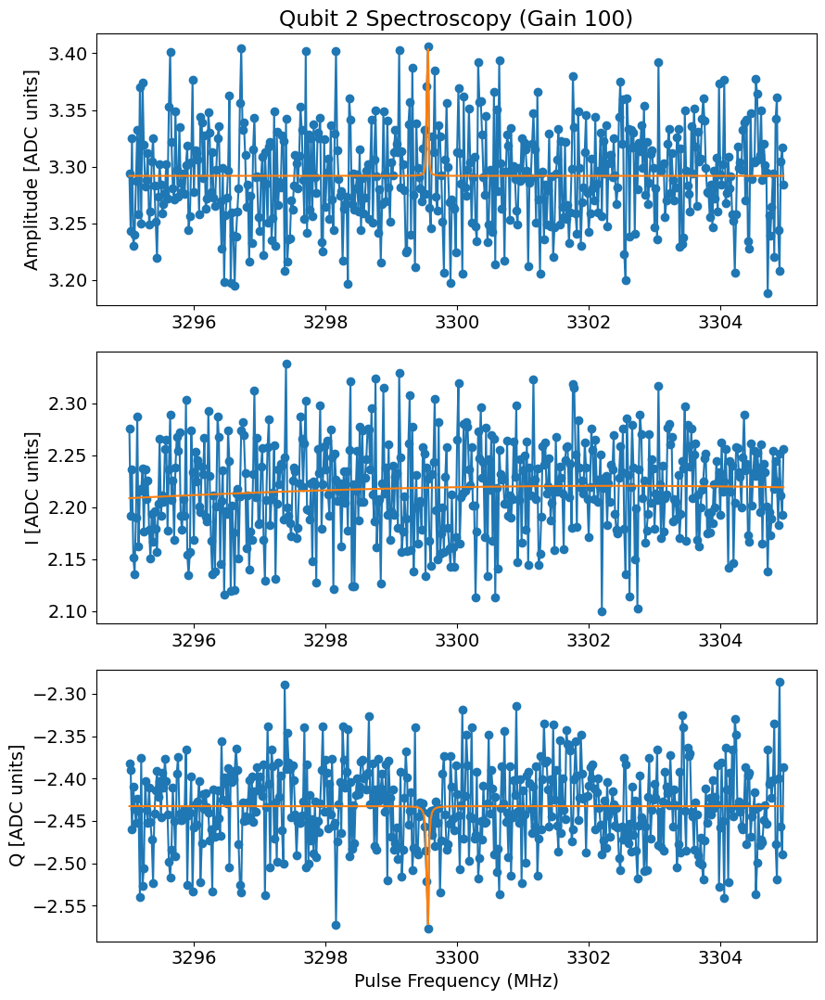

*Set cfg qubit 2 freq to 3299.5509642599905 MHz*
*Set cfg qubit 2 kappa to -0.00044774222848883066 MHz*


  0%|          | 0/100 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 86.88484848484848, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Attempted to init fitparam 1 to 204.17939393939392, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Attempted to init fitparam 1 to 86.88484848484848, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Decay from avgi [us] 0.06835937500000001
Pi length from avgi data [us]: 0.011372110499991744
	Pi/2 length from avgi data [us]: 0.005686055249995872

Decay from avgq [us] 0.06835937500000001
Pi length from avgq data [us]: 0.012111321357239321
Pi/2 length from avgq data [us]: 0.0060556606786196605


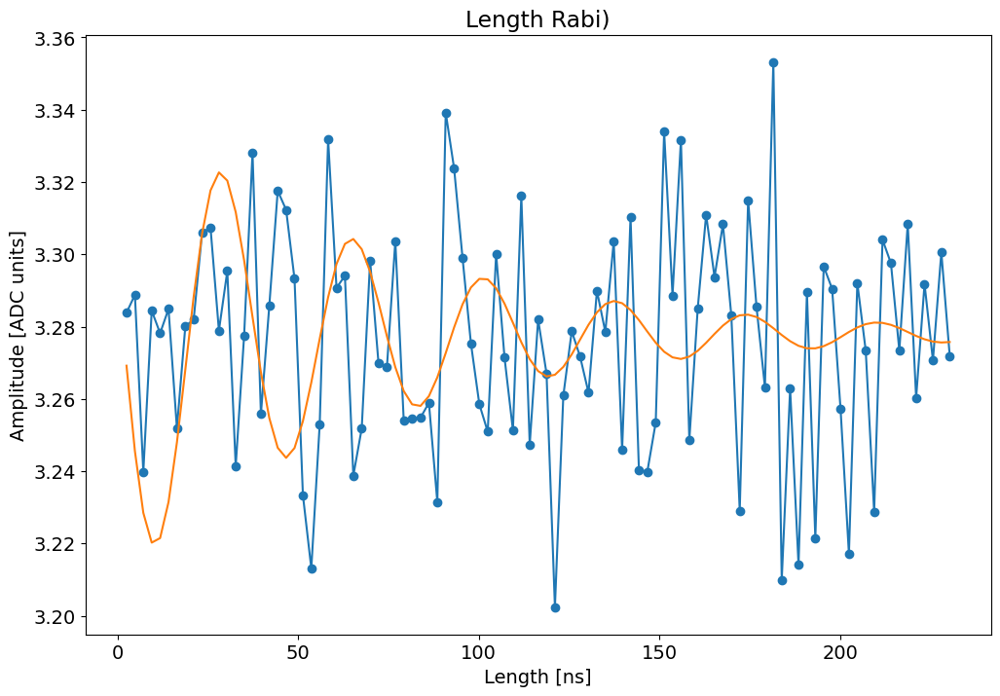

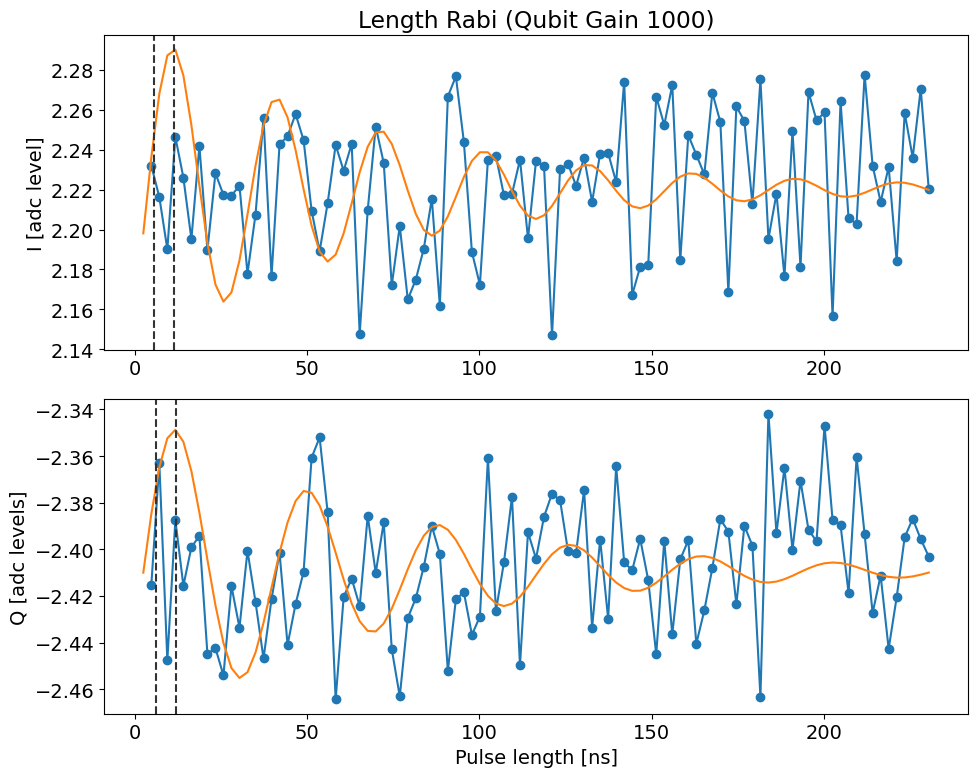

*Set cfg qubit 2 rabi length to 0.011372110499991744* us
qTest =  0.011372110499991744
gauss


  0%|          | 0/200000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.007035175879396985, which is out of bounds 5.0505050505050505e-05 to 0.005050505050505051. Instead init to 0.002550505050505051
Attempted to init fitparam 1 to 0.007537688442211056, which is out of bounds 5.0505050505050505e-05 to 0.005050505050505051. Instead init to 0.002550505050505051
Attempted to init fitparam 1 to 0.035678391959799, which is out of bounds 5.0505050505050505e-05 to 0.005050505050505051. Instead init to 0.002550505050505051
Pi gain from amps data [dac units]: 168
	Pi/2 gain from amps data [dac units]: 84
Pi gain from avgi data [dac units]: 171
	Pi/2 gain from avgi data [dac units]: 85
Pi gain from avgq data [dac units]: 168
	Pi/2 gain from avgq data [dac units]: 84


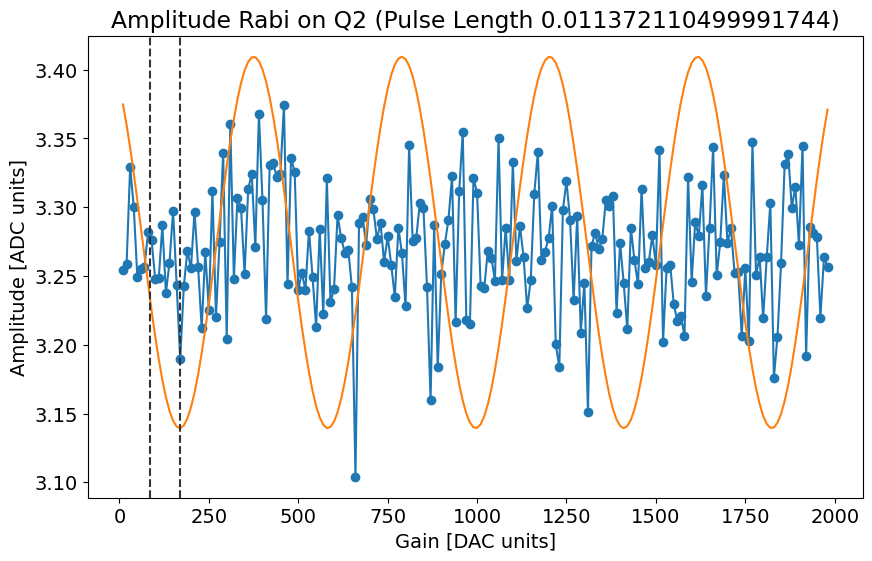

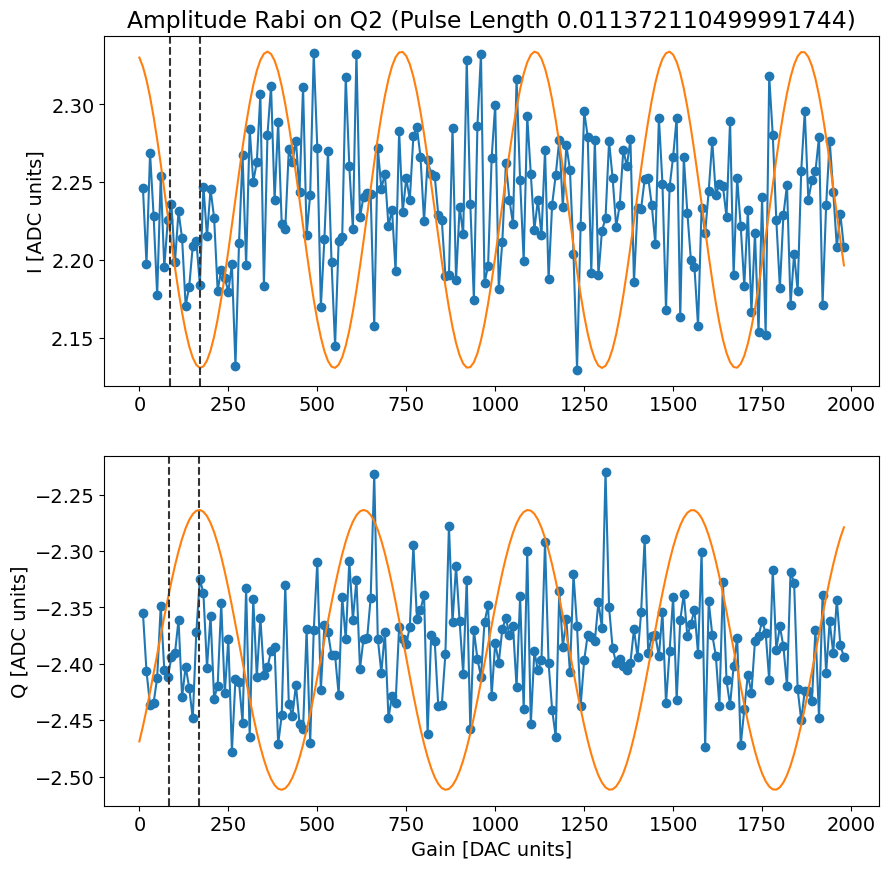

*Set cfg qubit 2 rabi amplitude to 171* DAC units


  0%|          | 0/60000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.20735785953177258, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Attempted to init fitparam 1 to 0.5150501672240803, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Attempted to init fitparam 1 to 0.6020066889632107, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Current pi pulse frequency: 3299.5509642599905
Fit frequency from amps [MHz]: 0.04217881250670803 +/- 0.0008274610003719287
Suggested new pi pulse frequencies from fit amps [MHz]:
 	3301.5087854474837
 	3297.5087854474837
T2 Ramsey from fit amps [us]: 44.7
Current pi pulse frequency: 3299.5509642599905
Fit frequency from I [MHz]: 0.041289363137298085 +/- 0.000808763881476063
Suggested new pi pulse frequency from fit I [MHz]:
 	3301.509674896853
 	3297.509674896853
T2 Ramsey from fit I [us]: 44.7
Fit frequency from Q [MHz]:

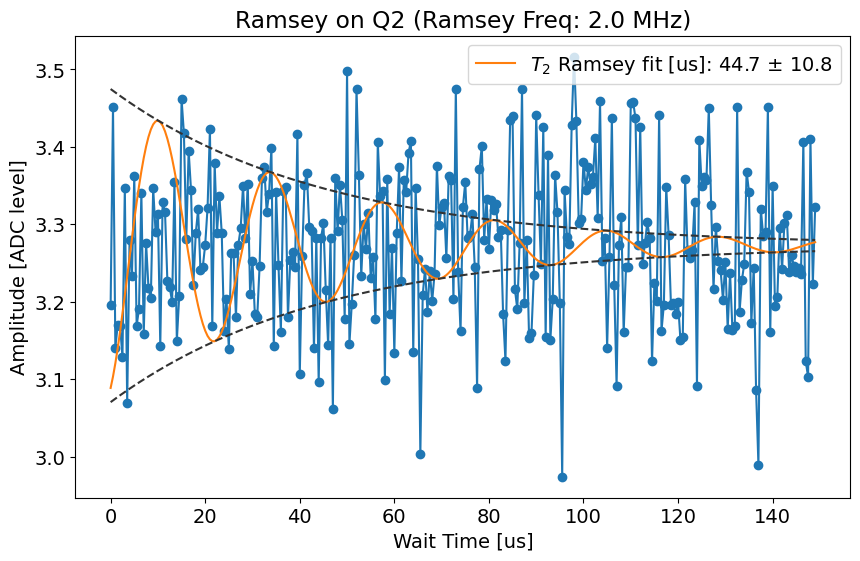

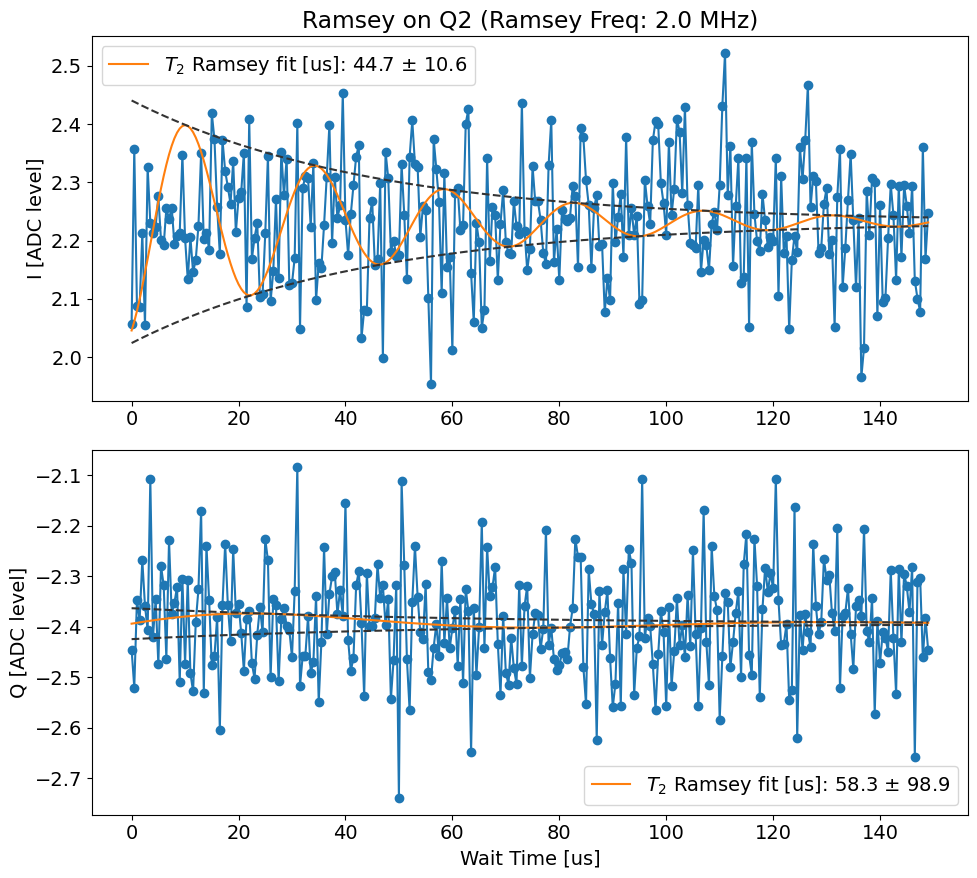

Replacing 3299.5509642599905 with 3297.509674896853 in results cfg file
qTest =  0.011372110499991744
gauss


  0%|          | 0/200000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.008375209380234507, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Attempted to init fitparam 1 to 0.031825795644891124, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Attempted to init fitparam 1 to 0.031825795644891124, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Pi gain from amps data [dac units]: 315
	Pi/2 gain from amps data [dac units]: 157
Pi gain from avgi data [dac units]: 339
	Pi/2 gain from avgi data [dac units]: 169
Pi gain from avgq data [dac units]: 370
	Pi/2 gain from avgq data [dac units]: 185


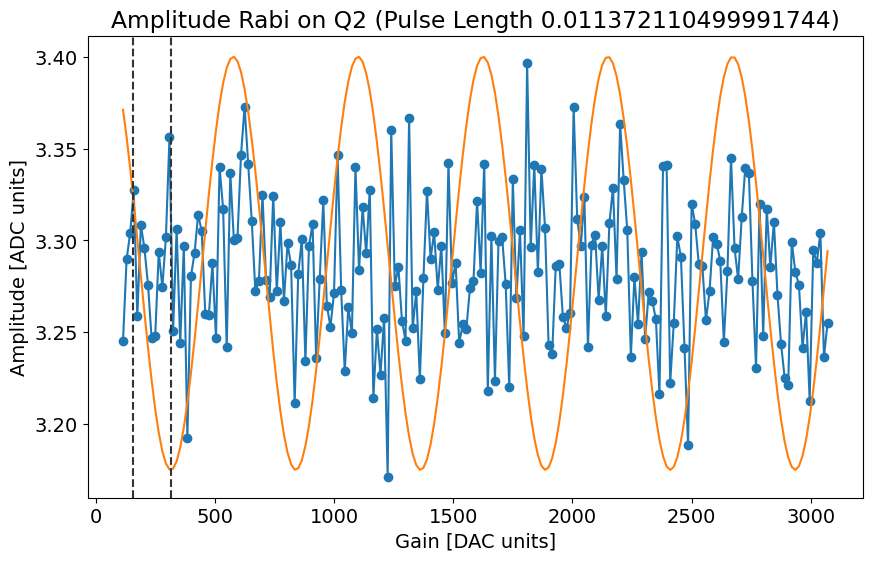

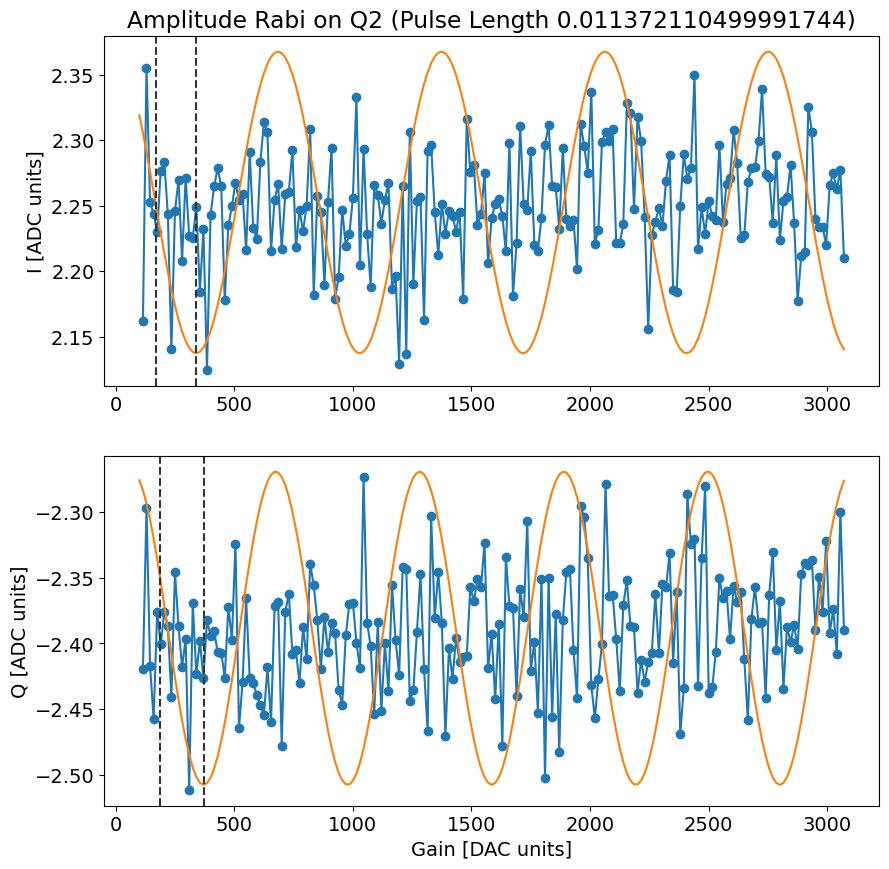

*Set cfg qubit 2 rabi amplitude to 339* DAC units


  0%|          | 0/200000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 753.836516413076
Fit T1 avgq [us]: 131.3204939998238


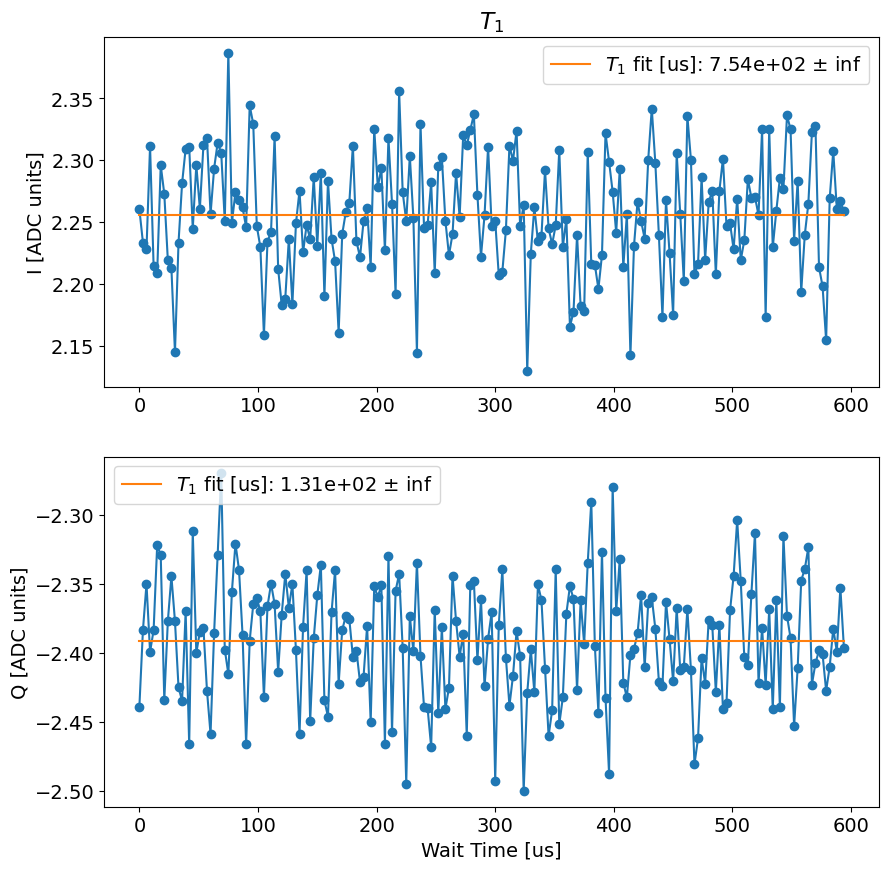

t1_i error:fit ratio= inf
t1_q error:fit ratio= inf
t1_q is better, saving t1_q to results cfg file
*Set cfg qubit 2 T1 to 131.3204939998238* us
Running analysis for qubit:  3 ...


  0%|          | 0/500 [00:00<?, ?it/s]

From Fit:
	f0: 7193.997892927423
	kappa[MHz]: 908.5044325069257


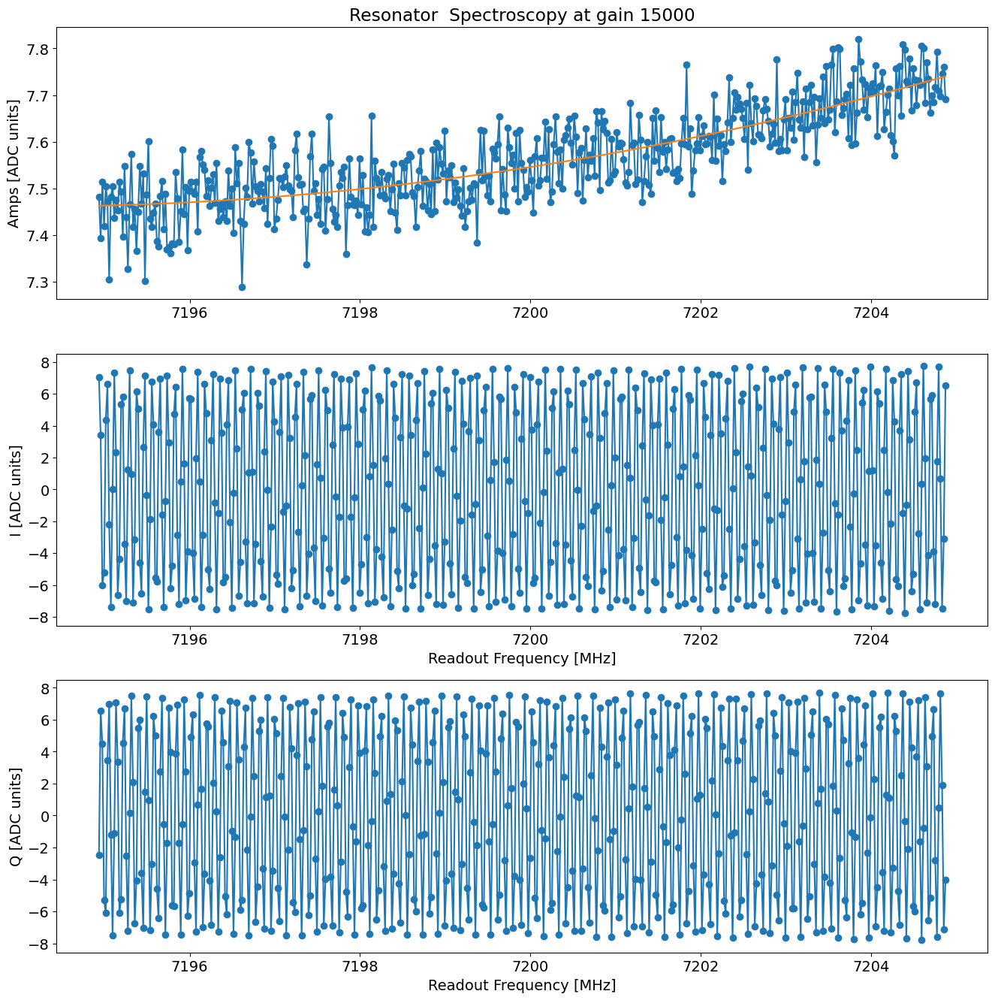

*Set cfg res 3 freq to 7193.997892927423 Mhz*
*Set cfg res 3 kappa to 908.5044325069257 MHz*


  0%|          | 0/20 [00:00<?, ?it/s]

Found peak in amps at [MHz] 3297.513029821287, HWHM 0.006204901995580665
Found peak in I at [MHz] 3299.6735938330453, HWHM 0.8792821285358254
Found peak in Q at [MHz] 3299.78, HWHM 0.9940000000000054


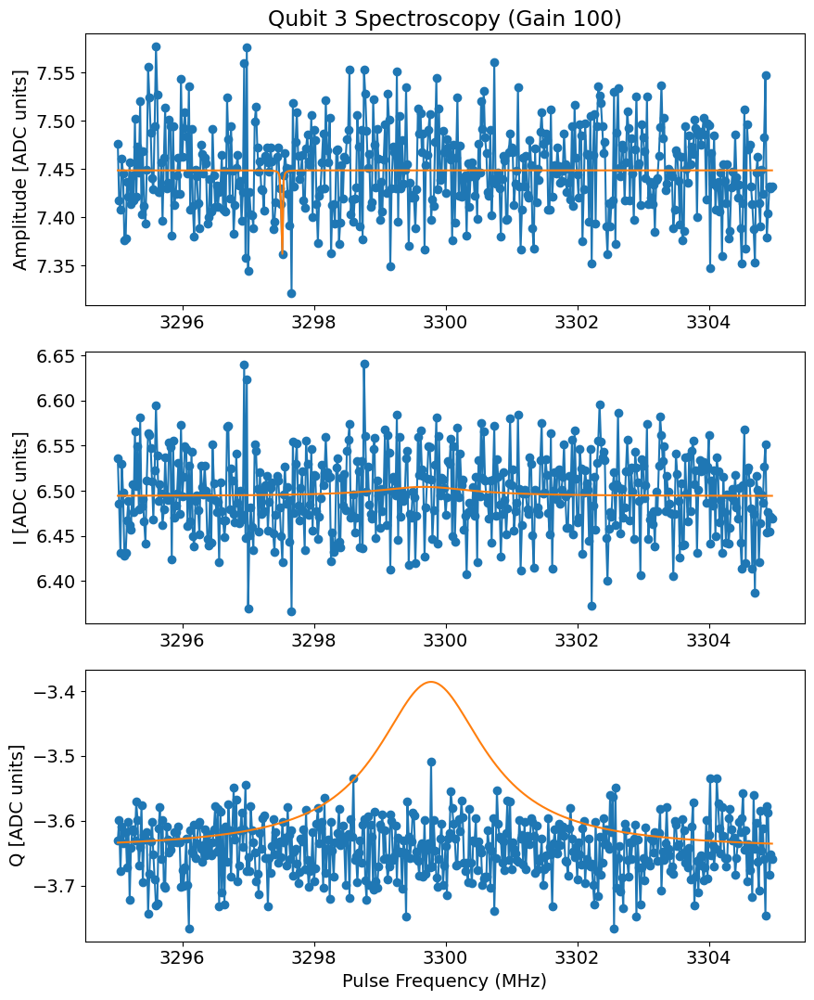

*Set cfg qubit 3 freq to 3297.513029821287 MHz*
*Set cfg qubit 3 kappa to 0.01240980399116133 MHz*


  0%|          | 0/100 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 130.3272727272727, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Attempted to init fitparam 1 to 156.39272727272726, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Attempted to init fitparam 1 to 73.8521212121212, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Decay from avgi [us] 0.06835937500000001
Pi length from avgi data [us]: 0.010788386499362396
	Pi/2 length from avgi data [us]: 0.005394193249681198

Decay from avgq [us] 0.06835937500000001
Pi length from avgq data [us]: 0.01378915071879969
Pi/2 length from avgq data [us]: 0.006894575359399845


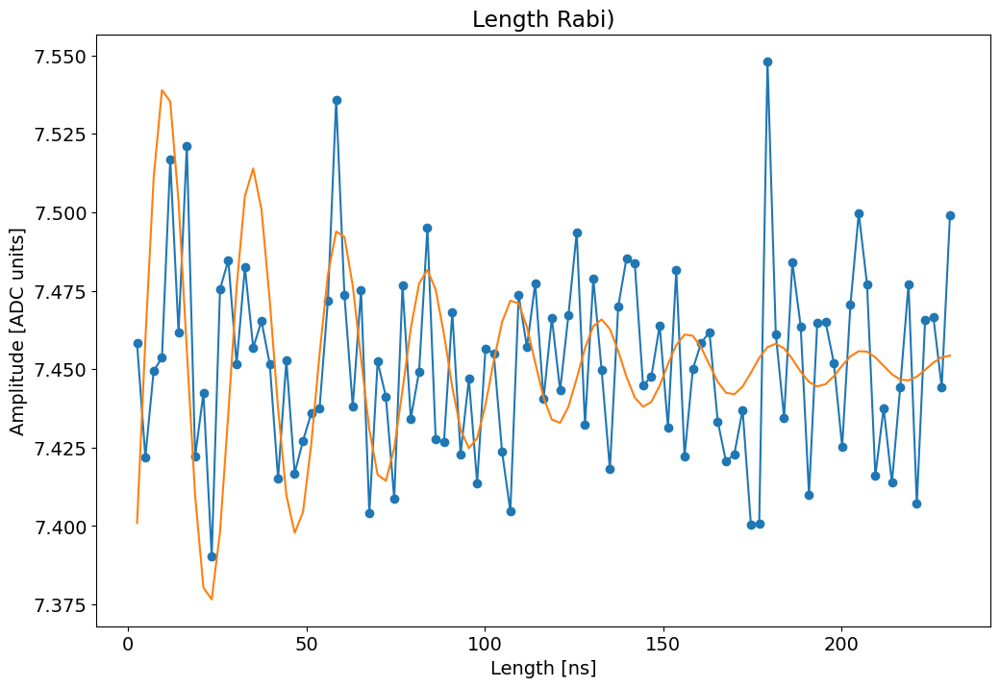

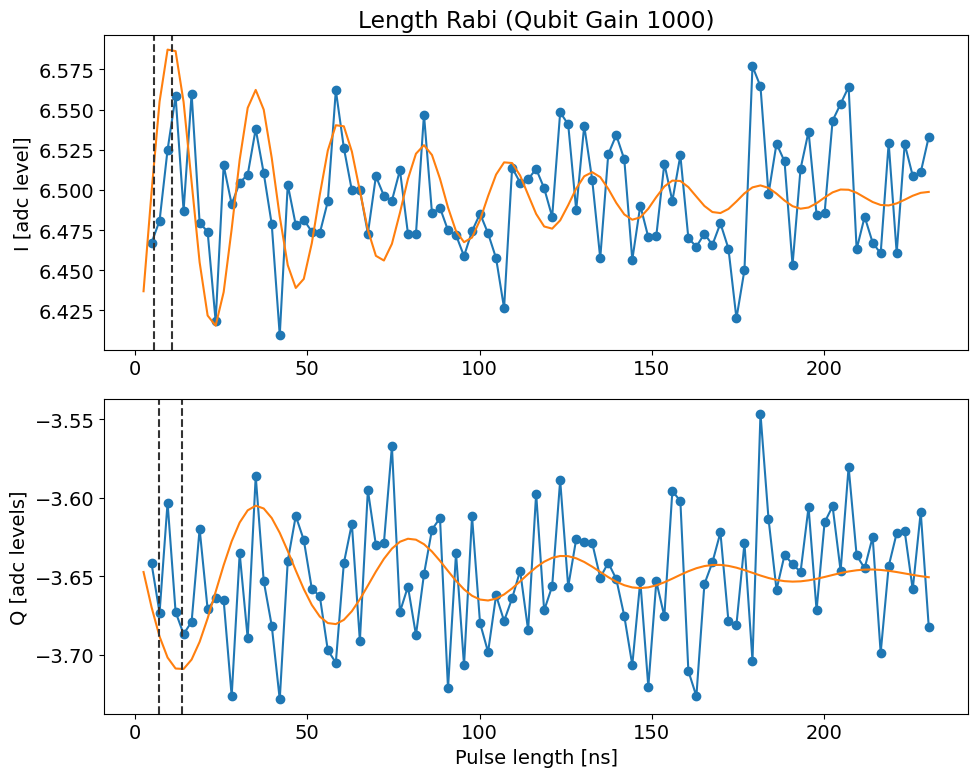

*Set cfg qubit 3 rabi length to 0.010788386499362396* us
qTest =  0.010788386499362396
gauss


  0%|          | 0/200000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.04572864321608041, which is out of bounds 5.0505050505050505e-05 to 0.005050505050505051. Instead init to 0.002550505050505051
Attempted to init fitparam 1 to 0.015577889447236183, which is out of bounds 5.0505050505050505e-05 to 0.005050505050505051. Instead init to 0.002550505050505051
Attempted to init fitparam 1 to 0.04572864321608041, which is out of bounds 5.0505050505050505e-05 to 0.005050505050505051. Instead init to 0.002550505050505051
Pi gain from amps data [dac units]: 137
	Pi/2 gain from amps data [dac units]: 68
Pi gain from avgi data [dac units]: 142
	Pi/2 gain from avgi data [dac units]: 71
Pi gain from avgq data [dac units]: 130
	Pi/2 gain from avgq data [dac units]: 65


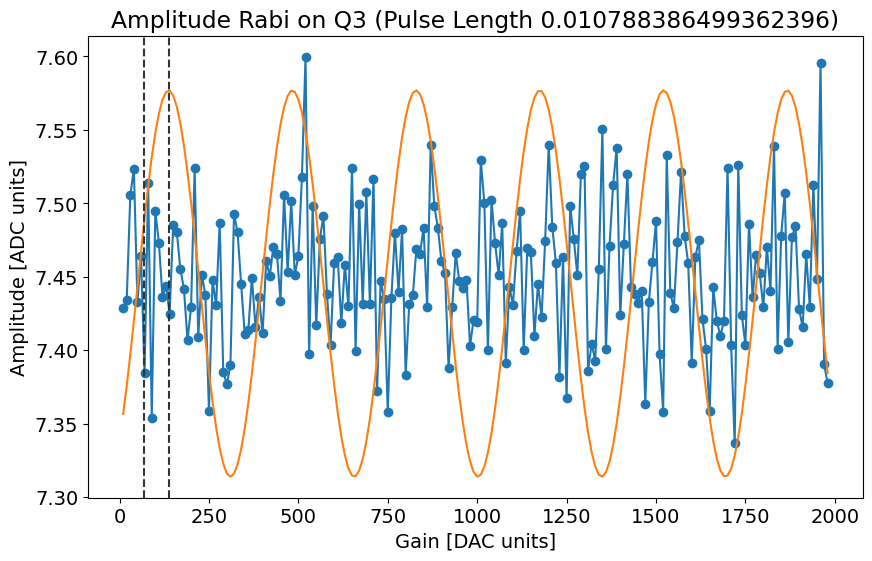

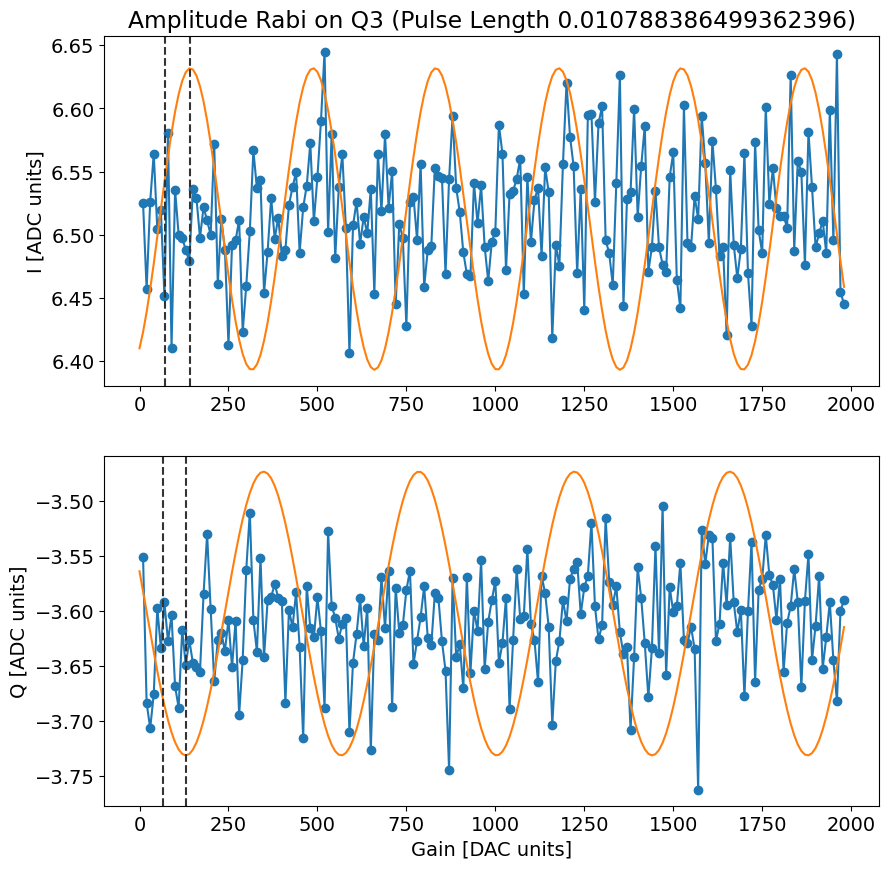

*Set cfg qubit 3 rabi amplitude to 142* DAC units


  0%|          | 0/60000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.5618729096989966, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Attempted to init fitparam 1 to 0.34782608695652173, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Current pi pulse frequency: 3297.513029821287
Fit frequency from amps [MHz]: 0.052630961200192214 +/- 0.0005617302275830891
Suggested new pi pulse frequencies from fit amps [MHz]:
 	3299.460398860087
 	3295.460398860087
T2 Ramsey from fit amps [us]: 44.7
Current pi pulse frequency: 3297.513029821287
Fit frequency from I [MHz]: 0.0011239672816466117 +/- 0.04003926375496236
Suggested new pi pulse frequency from fit I [MHz]:
 	3299.5119058540054
 	3295.5119058540054
T2 Ramsey from fit I [us]: 1332.0006673679852
Fit frequency from Q [MHz]: 0.0012989827660705288 +/- 504101.87453189964
Suggested new pi pulse frequencies from fit Q [MHz]:
 	3299.511730838521
 	3295.511730838521
T2 Ra

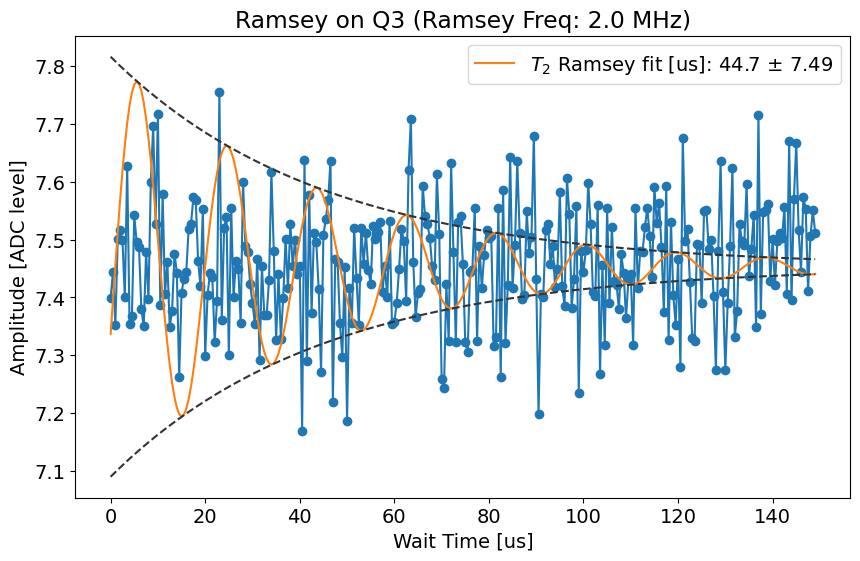

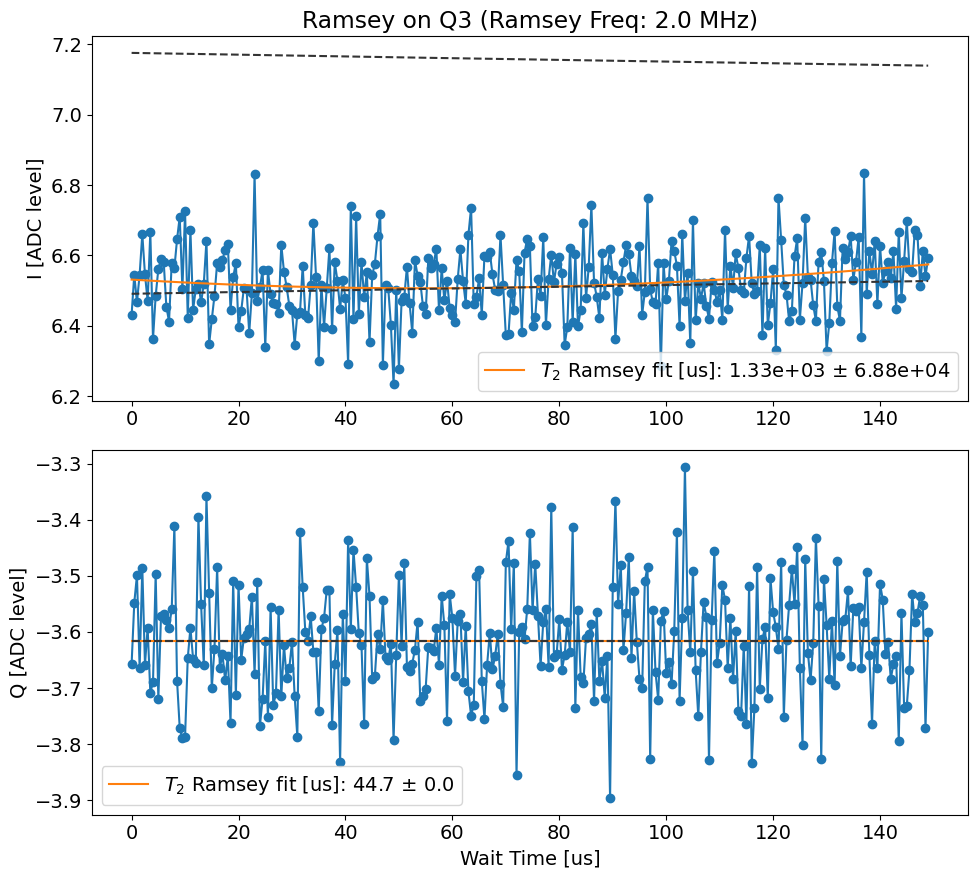

Replacing 3297.513029821287 with 3295.460398860087 in results cfg file
qTest =  0.010788386499362396
gauss


  0%|          | 0/200000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.003685092127303183, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Attempted to init fitparam 1 to 0.03283082077051926, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Attempted to init fitparam 1 to 0.028475711892797323, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Pi gain from amps data [dac units]: 305
	Pi/2 gain from amps data [dac units]: 152
Pi gain from avgi data [dac units]: 349
	Pi/2 gain from avgi data [dac units]: 174
Pi gain from avgq data [dac units]: 348
	Pi/2 gain from avgq data [dac units]: 174


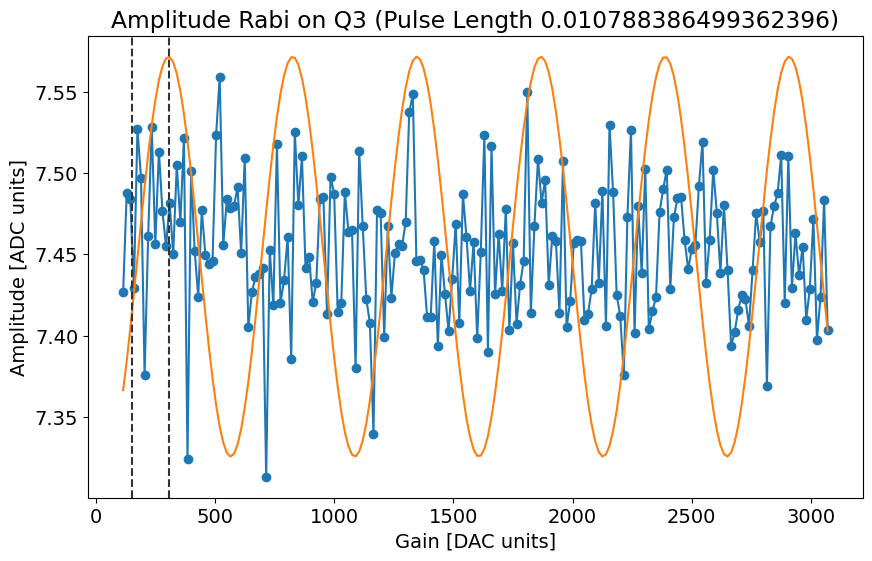

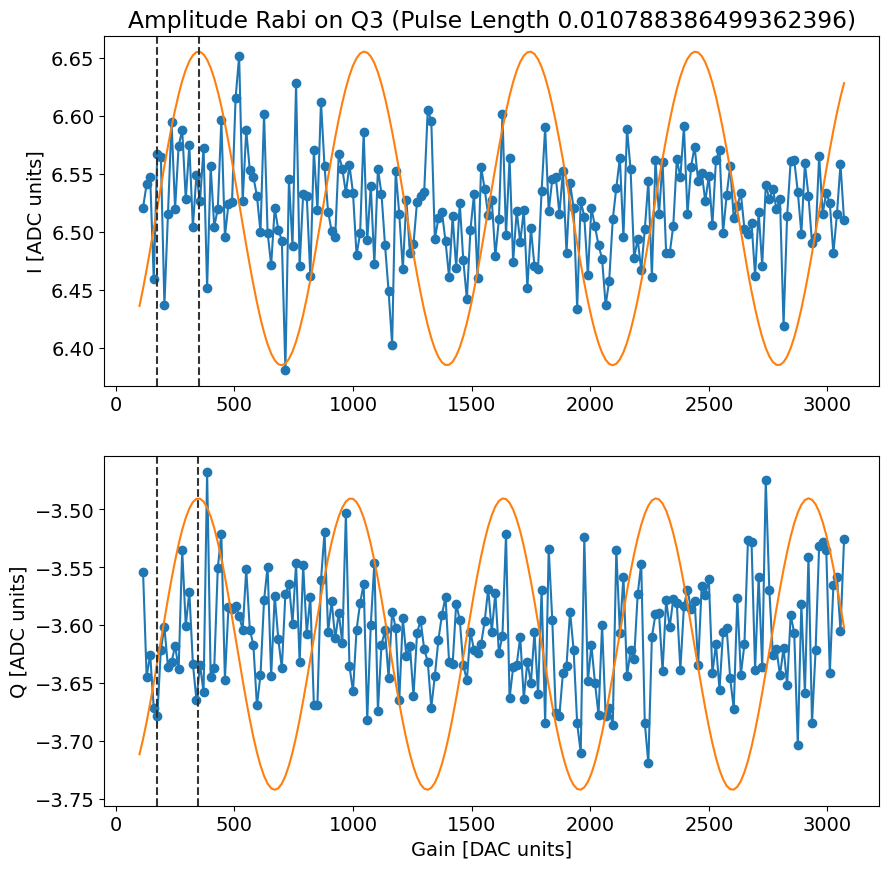

*Set cfg qubit 3 rabi amplitude to 349* DAC units


  0%|          | 0/200000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 82.9437267448866
Fit T1 avgq [us]: 34167.57877722368


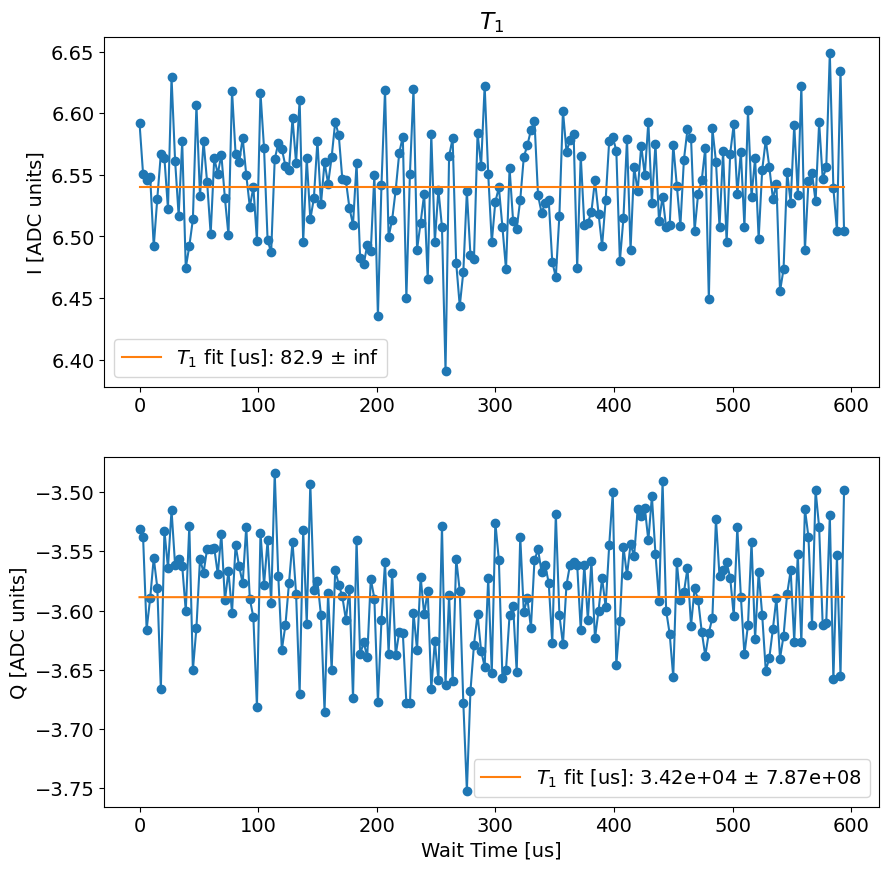

t1_i error:fit ratio= inf
t1_q error:fit ratio= 23024.69334004118
t1_q is better, saving t1_q to results cfg file
*Set cfg qubit 3 T1 to 34167.57877722368* us
Running analysis for qubit:  4 ...


  0%|          | 0/500 [00:00<?, ?it/s]

From Fit:
	f0: 7216.078499426919
	kappa[MHz]: 0.5743019820313581


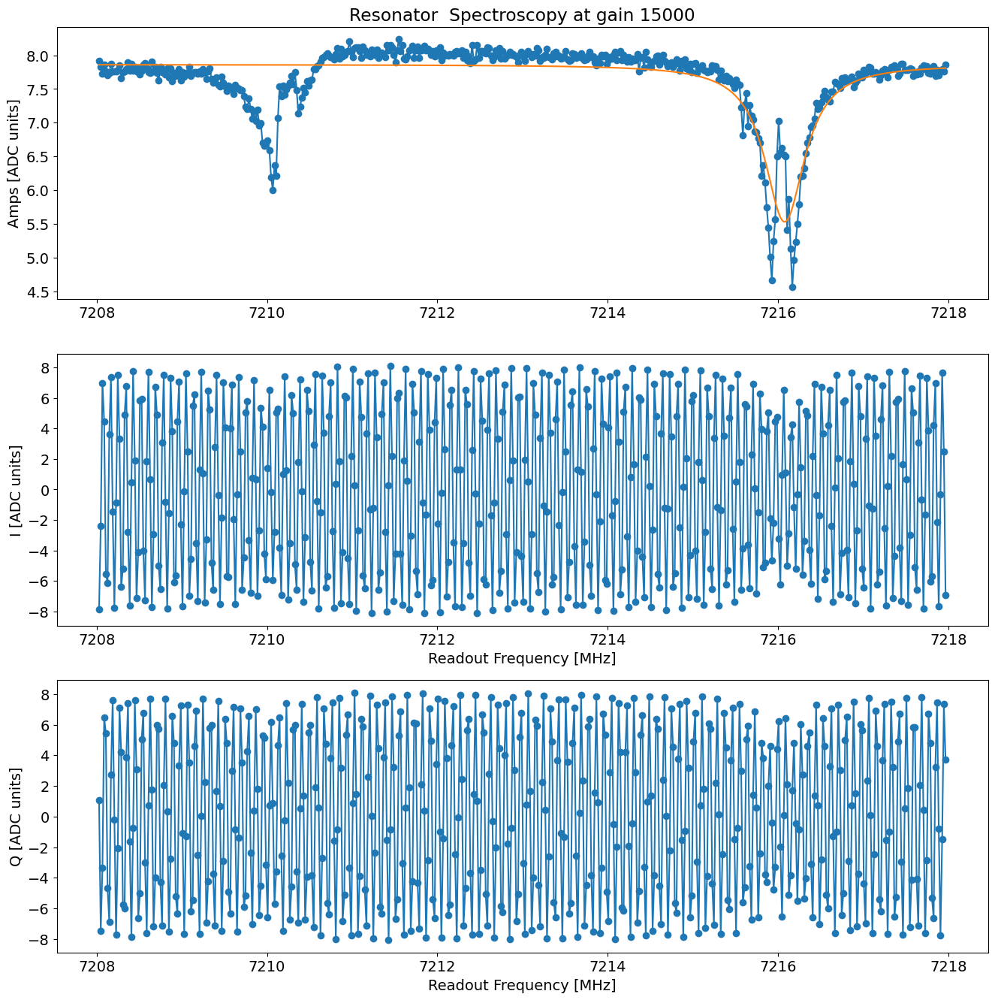

*Set cfg res 4 freq to 7216.078499426919 Mhz*
*Set cfg res 4 kappa to 0.5743019820313581 MHz*


  0%|          | 0/20 [00:00<?, ?it/s]

Found peak in amps at [MHz] 3303.346644452807, HWHM -0.15741961106273547
Found peak in I at [MHz] 3299.5288947400277, HWHM 1.1538971511646616
Found peak in Q at [MHz] 3303.342275481445, HWHM 0.1410166984440859


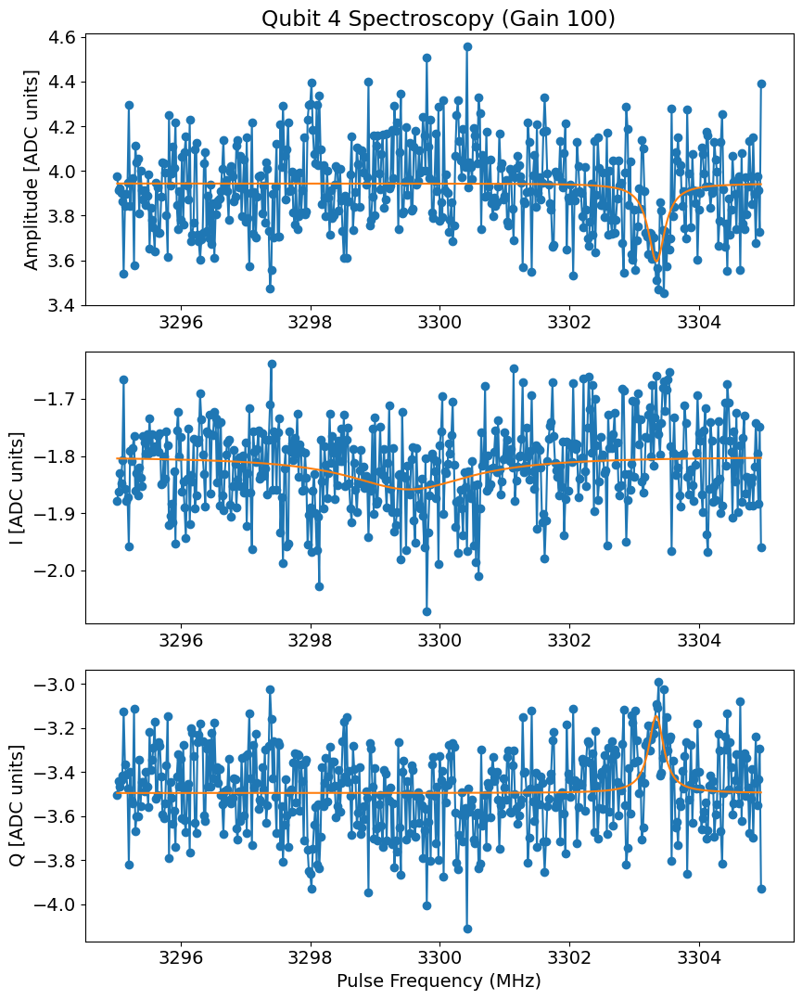

*Set cfg qubit 4 freq to 3303.346644452807 MHz*
*Set cfg qubit 4 kappa to -0.31483922212547094 MHz*


  0%|          | 0/100 [00:00<?, ?it/s]

Decay from avgi [us] 0.4966265155352648
Pi length from avgi data [us]: 0.09592980564650719
	Pi/2 length from avgi data [us]: 0.047964902823253594

Decay from avgq [us] 0.7521538889410759
Pi length from avgq data [us]: 0.09009860046715032
Pi/2 length from avgq data [us]: 0.04504930023357516


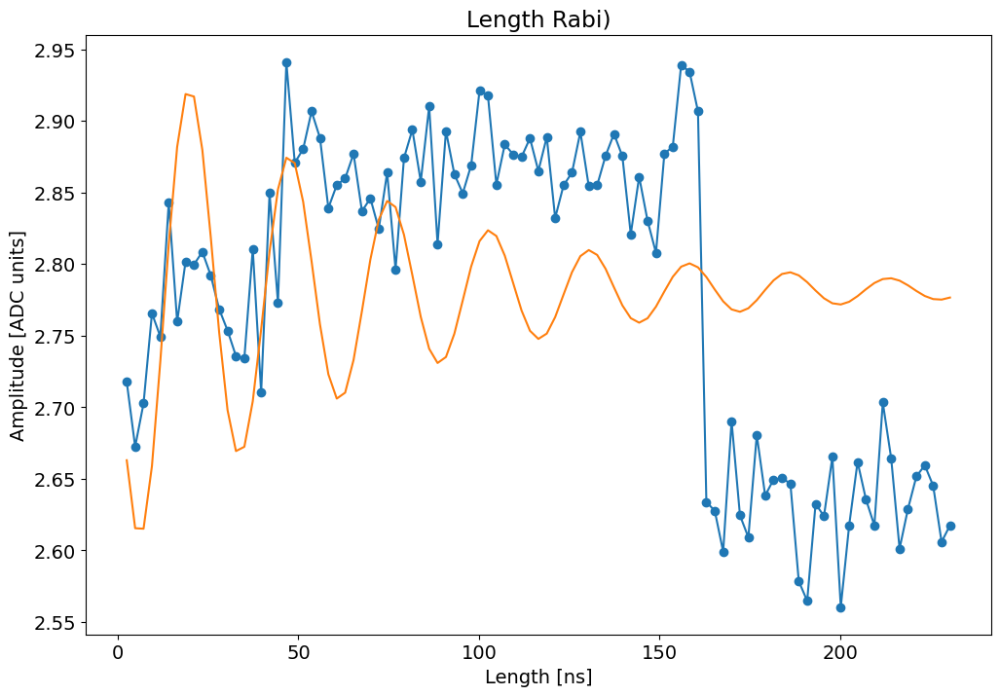

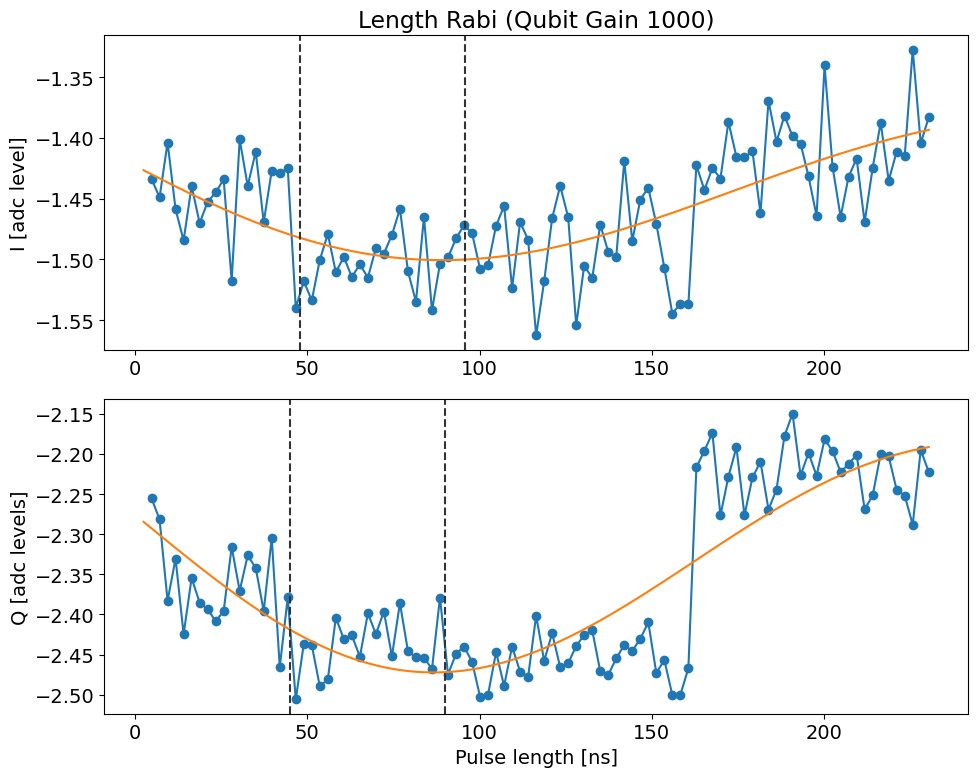

*Set cfg qubit 4 rabi length to 0.09592980564650719* us
qTest =  0.09592980564650719
gauss


  0%|          | 0/200000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.040703517587939705, which is out of bounds 5.0505050505050505e-05 to 0.005050505050505051. Instead init to 0.002550505050505051
Attempted to init fitparam 1 to 0.040703517587939705, which is out of bounds 5.0505050505050505e-05 to 0.005050505050505051. Instead init to 0.002550505050505051
Pi gain from amps data [dac units]: 193
	Pi/2 gain from amps data [dac units]: 96
Pi gain from avgi data [dac units]: 11839
	Pi/2 gain from avgi data [dac units]: 5919
Pi gain from avgq data [dac units]: 182
	Pi/2 gain from avgq data [dac units]: 91


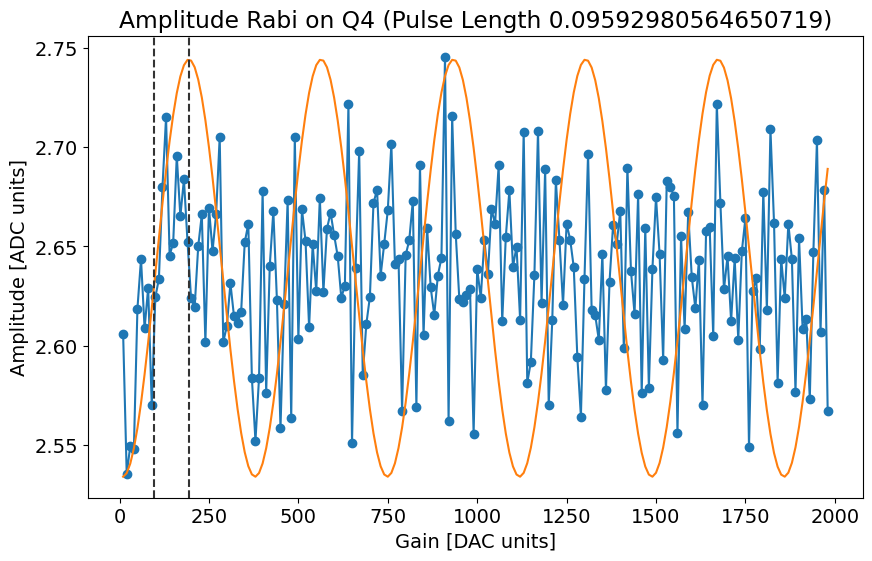

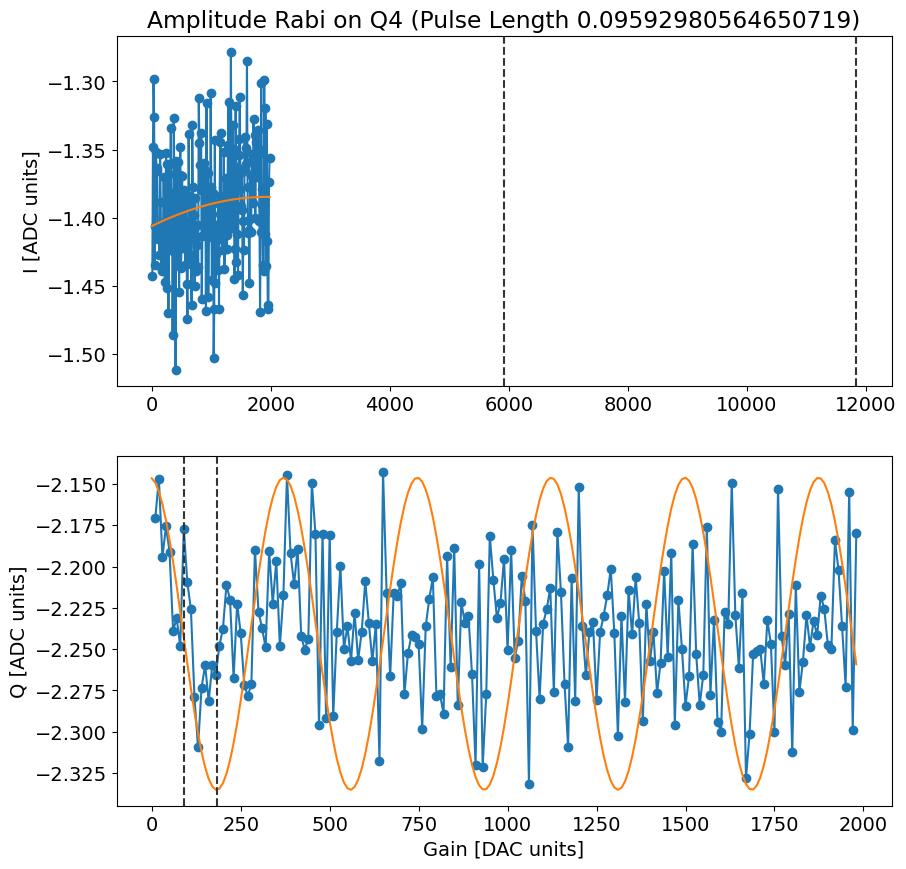

*Set cfg qubit 4 rabi amplitude to 11839* DAC units


  0%|          | 0/60000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.35451505016722407, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Current pi pulse frequency: 3303.346644452807
Fit frequency from amps [MHz]: 0.002574370240364371 +/- 0.0047571623540253495
Suggested new pi pulse frequencies from fit amps [MHz]:
 	3305.3440700825668
 	3301.3440700825668
T2 Ramsey from fit amps [us]: 407.67194065487024
Current pi pulse frequency: 3303.346644452807
Fit frequency from I [MHz]: 0.0006711653151642719 +/- 0.09728827876273849
Suggested new pi pulse frequency from fit I [MHz]:
 	3305.345973287492
 	3301.345973287492
T2 Ramsey from fit I [us]: 922.5242954215139
Fit frequency from Q [MHz]: 0.04614753647255425 +/- 0.0005259770844836375
Suggested new pi pulse frequencies from fit Q [MHz]:
 	3305.3004969163344
 	3301.3004969163344
T2 Ramsey from fit Q [us]: 44.7


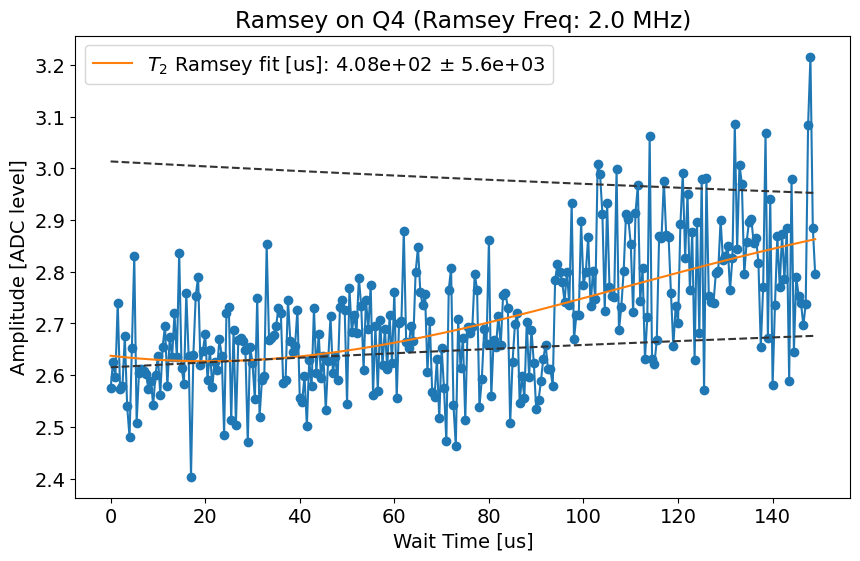

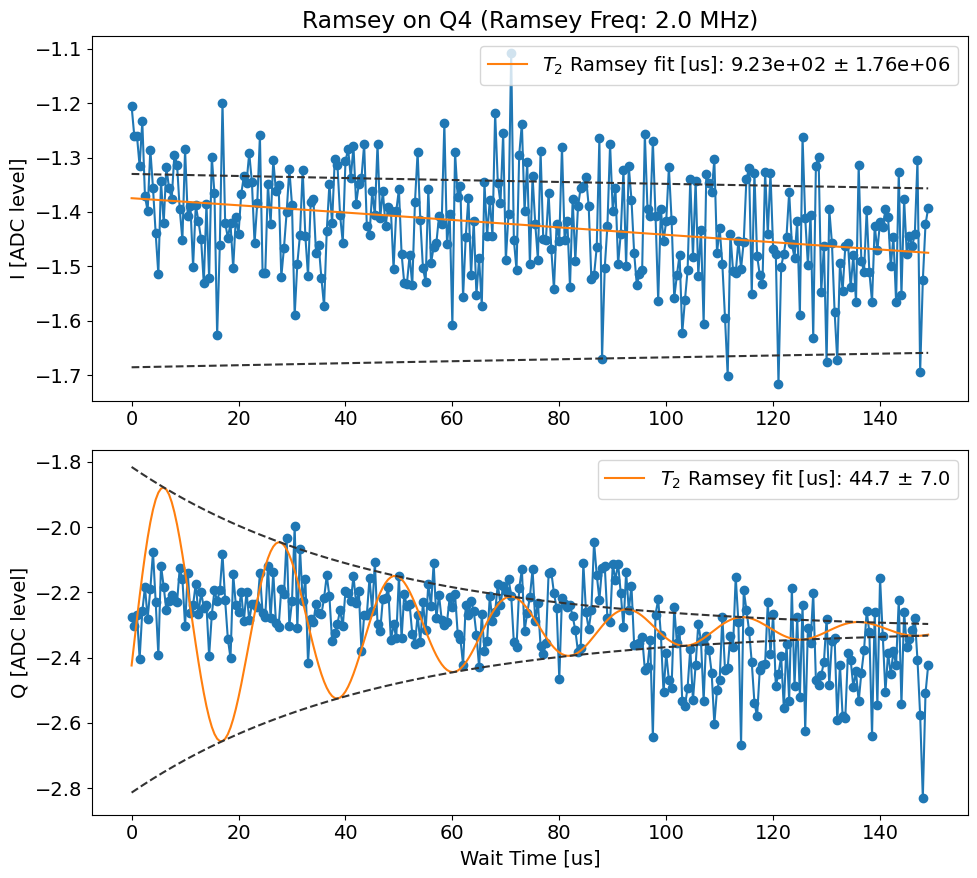

Replacing 3303.346644452807 with 3301.3004969163344 in results cfg file
qTest =  0.09592980564650719
gauss


  0%|          | 0/200000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.022110552763819097, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Attempted to init fitparam 1 to 0.022110552763819097, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Pi gain from amps data [dac units]: 429
	Pi/2 gain from amps data [dac units]: 214
Pi gain from avgi data [dac units]: 9405
	Pi/2 gain from avgi data [dac units]: 4702
Pi gain from avgq data [dac units]: 380
	Pi/2 gain from avgq data [dac units]: 190


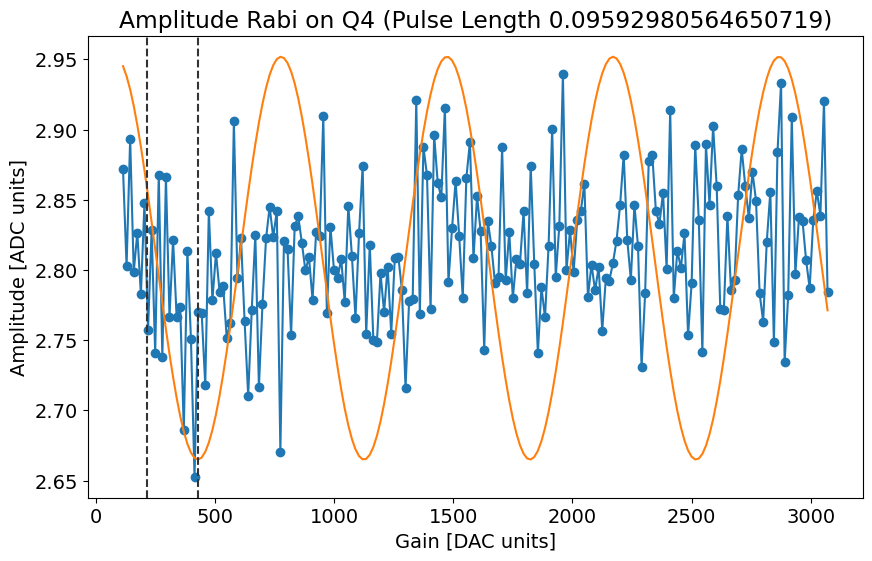

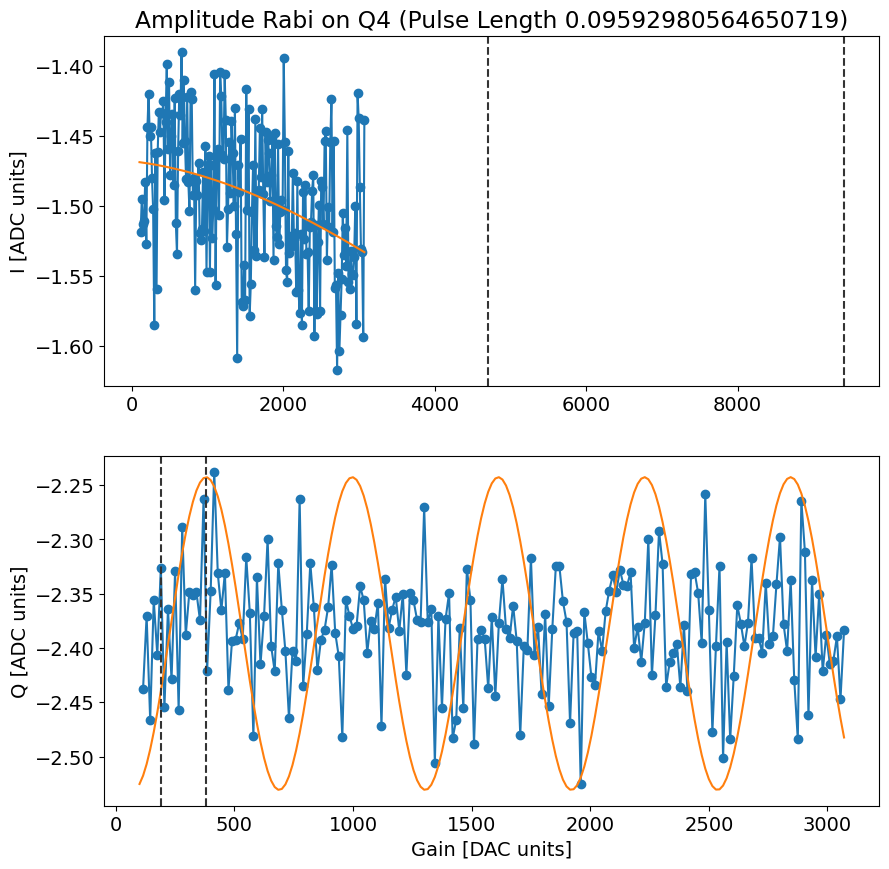

*Set cfg qubit 4 rabi amplitude to 9405* DAC units


  0%|          | 0/200000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 147.91390049659066
Fit T1 avgq [us]: 99.00131784637448


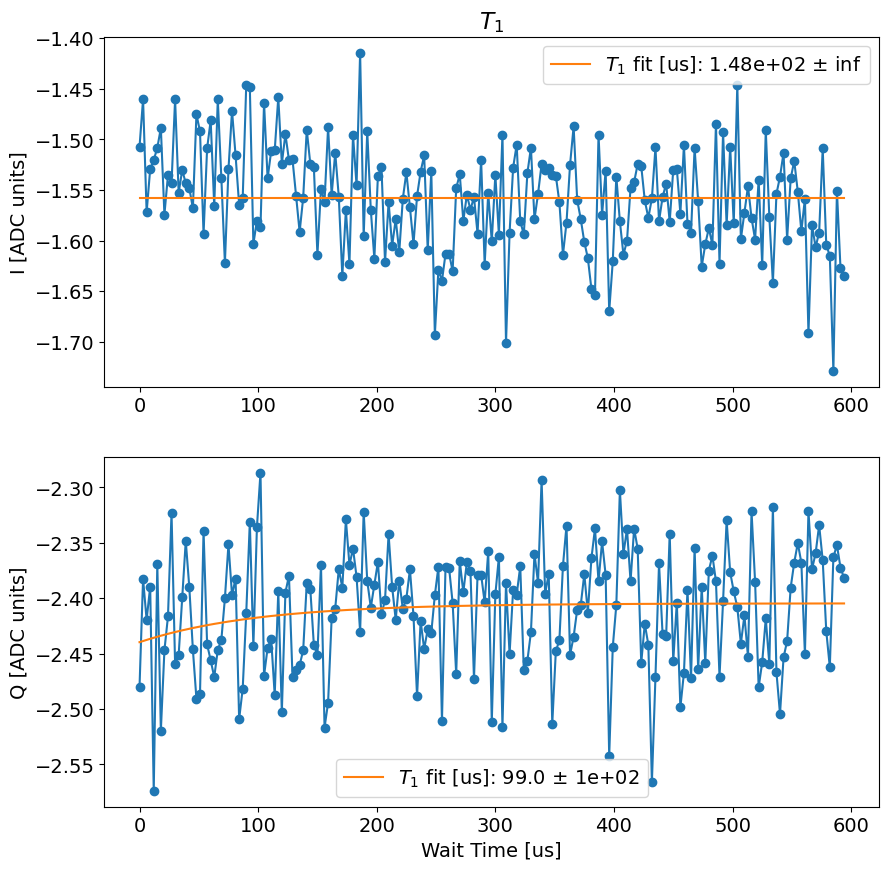

t1_i error:fit ratio= inf
t1_q error:fit ratio= 1.0137115575601272
t1_q is better, saving t1_q to results cfg file
*Set cfg qubit 4 T1 to 99.00131784637448* us
Running analysis for qubit:  5 ...


  0%|          | 0/500 [00:00<?, ?it/s]

From Fit:
	f0: 7235.872136837041
	kappa[MHz]: 13.301548950259875


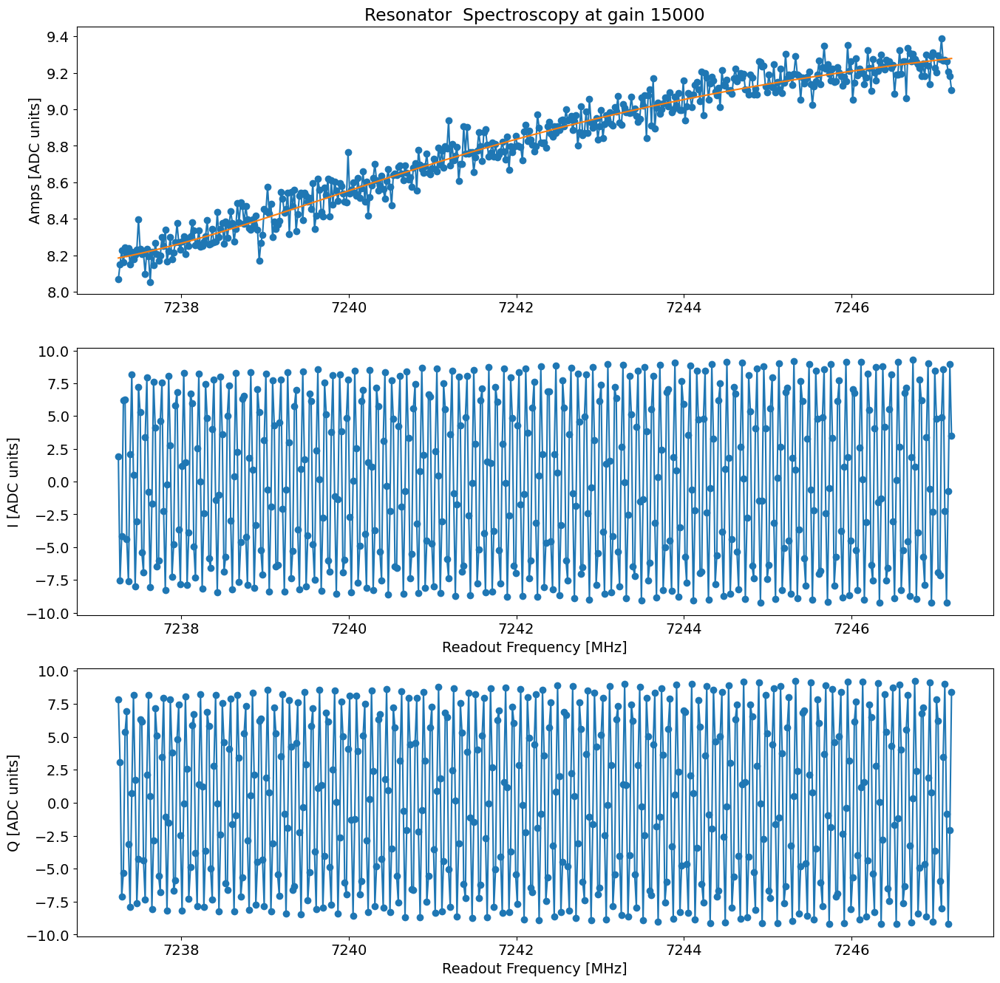

*Set cfg res 5 freq to 7235.872136837041 Mhz*
*Set cfg res 5 kappa to 13.301548950259875 MHz*


  0%|          | 0/20 [00:00<?, ?it/s]

Found peak in amps at [MHz] 3293.4711914611735, HWHM 510.3588499278492
Found peak in I at [MHz] 3301.1784824661263, HWHM 0.163895921098349
Found peak in Q at [MHz] 3256.8901989669826, HWHM 299.5861171595088


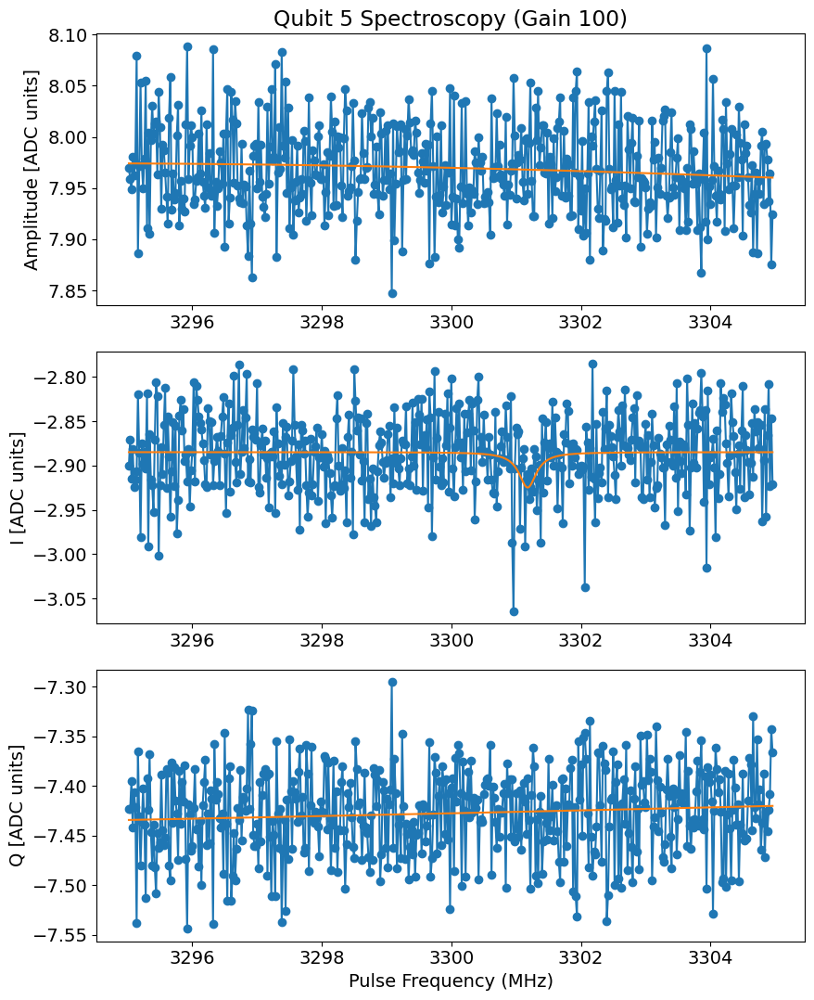

*Set cfg qubit 5 freq to 3293.4711914611735 MHz*
*Set cfg qubit 5 kappa to 1020.7176998556984 MHz*


  0%|          | 0/100 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 139.01575757575756, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Attempted to init fitparam 1 to 165.0812121212121, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Attempted to init fitparam 1 to 95.57333333333332, which is out of bounds 0.4388571428571429 to 65.82857142857142. Instead init to 33.133714285714284
Decay from avgi [us] 0.06835937500000001
Pi length from avgi data [us]: 0.015606751327390422
	Pi/2 length from avgi data [us]: 0.007803375663695211

Decay from avgq [us] 0.06835937500000001
Pi length from avgq data [us]: 0.01026304712551631
Pi/2 length from avgq data [us]: 0.005131523562758155


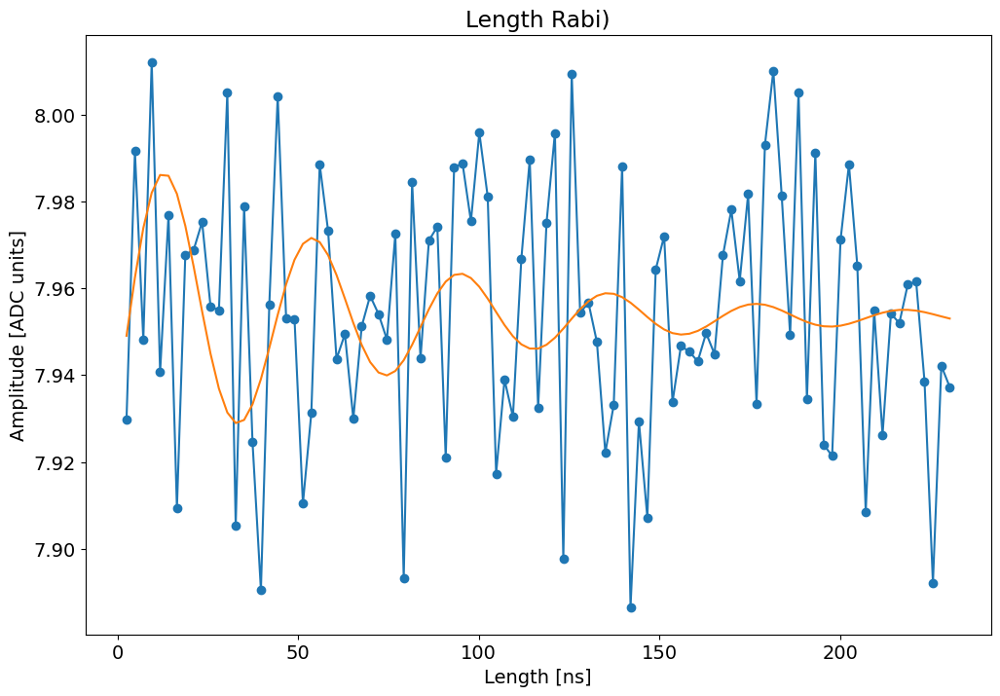

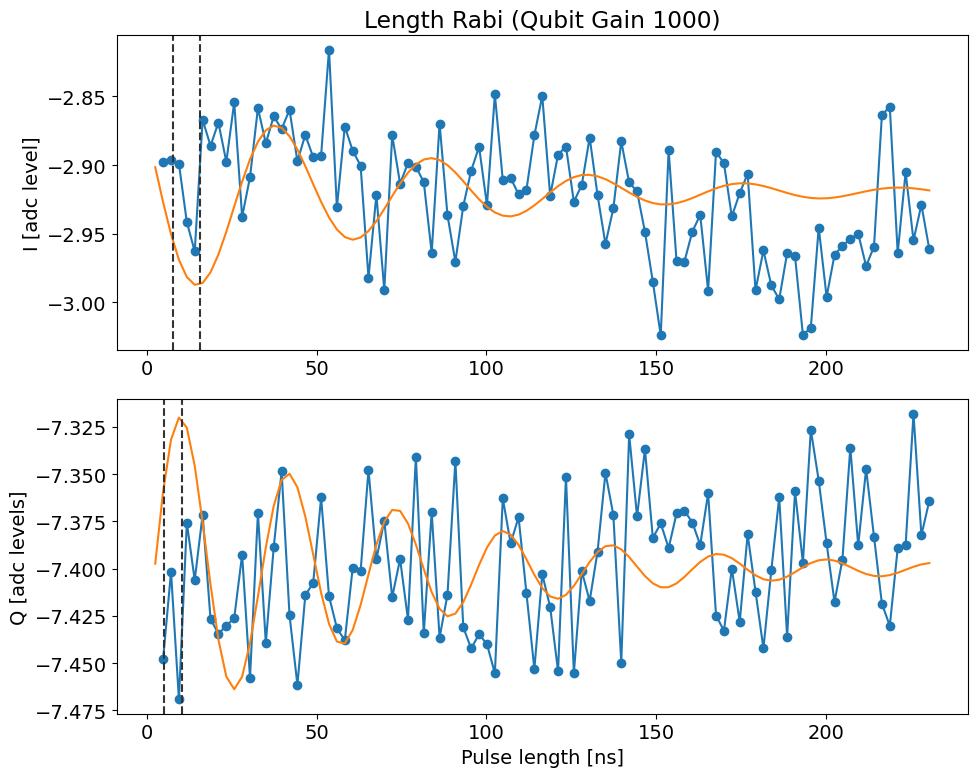

*Set cfg qubit 5 rabi length to 0.015606751327390422* us
qTest =  0.015606751327390422
gauss


  0%|          | 0/200000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.017587939698492466, which is out of bounds 5.0505050505050505e-05 to 0.005050505050505051. Instead init to 0.002550505050505051
Pi gain from amps data [dac units]: 114
	Pi/2 gain from amps data [dac units]: 57
Pi gain from avgi data [dac units]: 276
	Pi/2 gain from avgi data [dac units]: 138
Pi gain from avgq data [dac units]: 11763
	Pi/2 gain from avgq data [dac units]: 5881


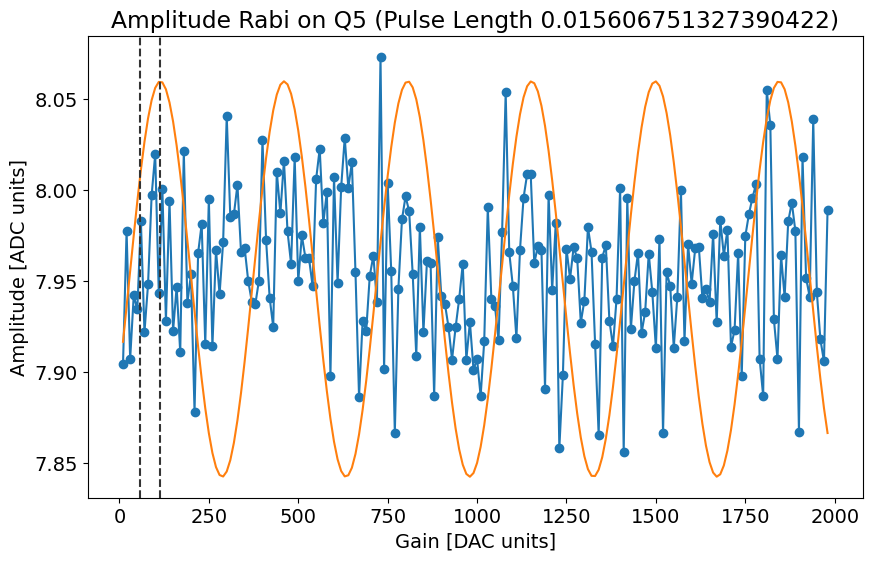

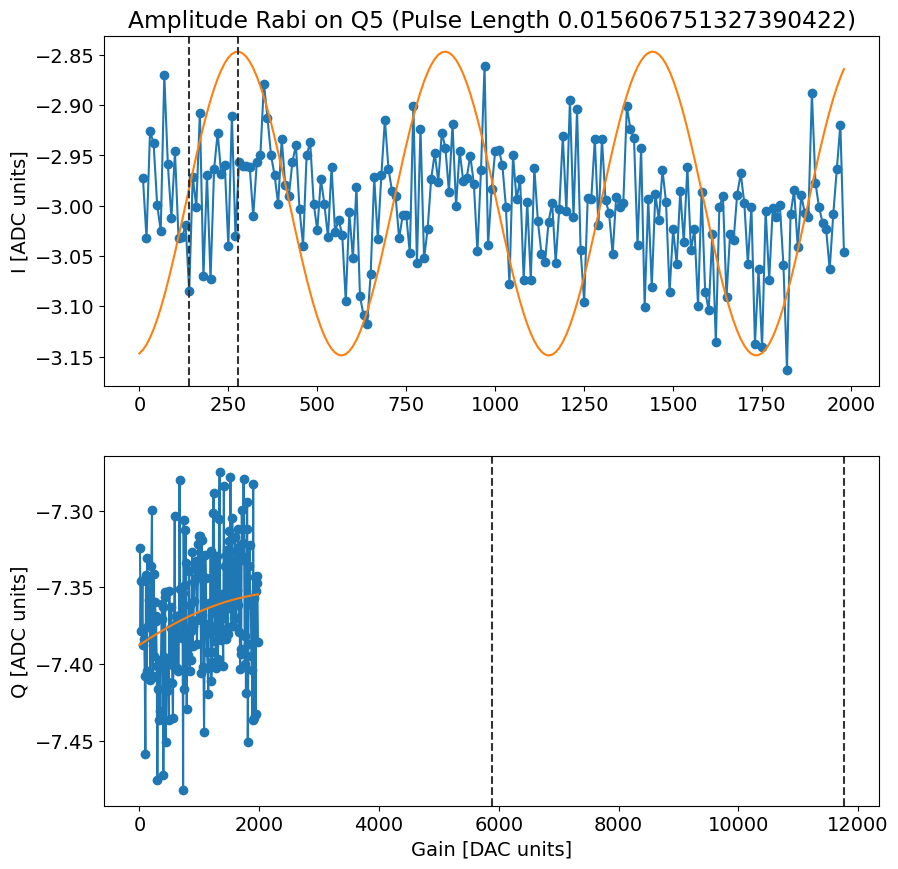

*Set cfg qubit 5 rabi amplitude to 276* DAC units


  0%|          | 0/60000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.4414715719063545, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Attempted to init fitparam 1 to 0.2140468227424749, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Attempted to init fitparam 1 to 0.24749163879598662, which is out of bounds 0.0006711409395973155 to 0.10067114093959731. Instead init to 0.05067114093959731
Current pi pulse frequency: 3293.4711914611735
Fit frequency from amps [MHz]: 0.02344812857931723 +/- 0.0015748677474493314
Suggested new pi pulse frequencies from fit amps [MHz]:
 	3295.447743332594
 	3291.447743332594
T2 Ramsey from fit amps [us]: 44.7
Current pi pulse frequency: 3293.4711914611735
Fit frequency from I [MHz]: 0.0544140562756375 +/- 0.0004809294183806218
Suggested new pi pulse frequency from fit I [MHz]:
 	3295.416777404898
 	3291.416777404898
T2 Ramsey from fit I [us]: 44.7
Fit frequency from Q [MHz]: 0.

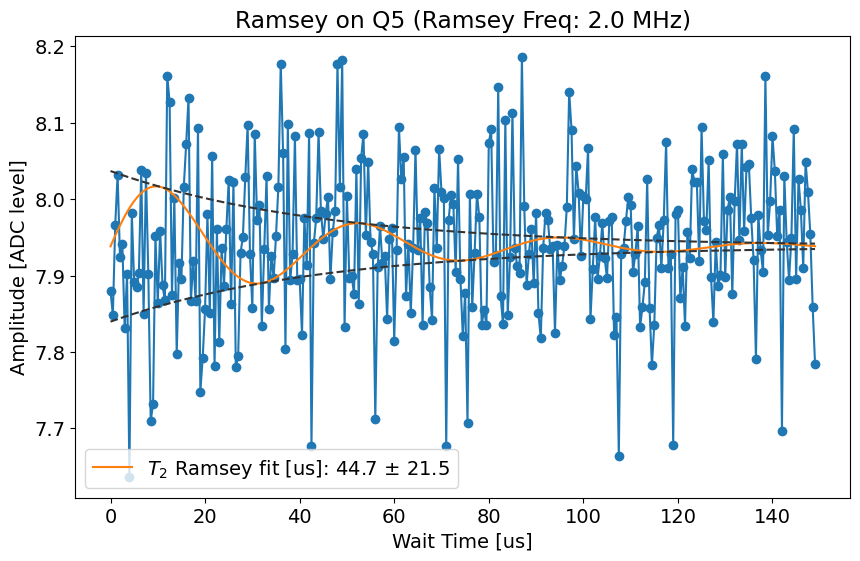

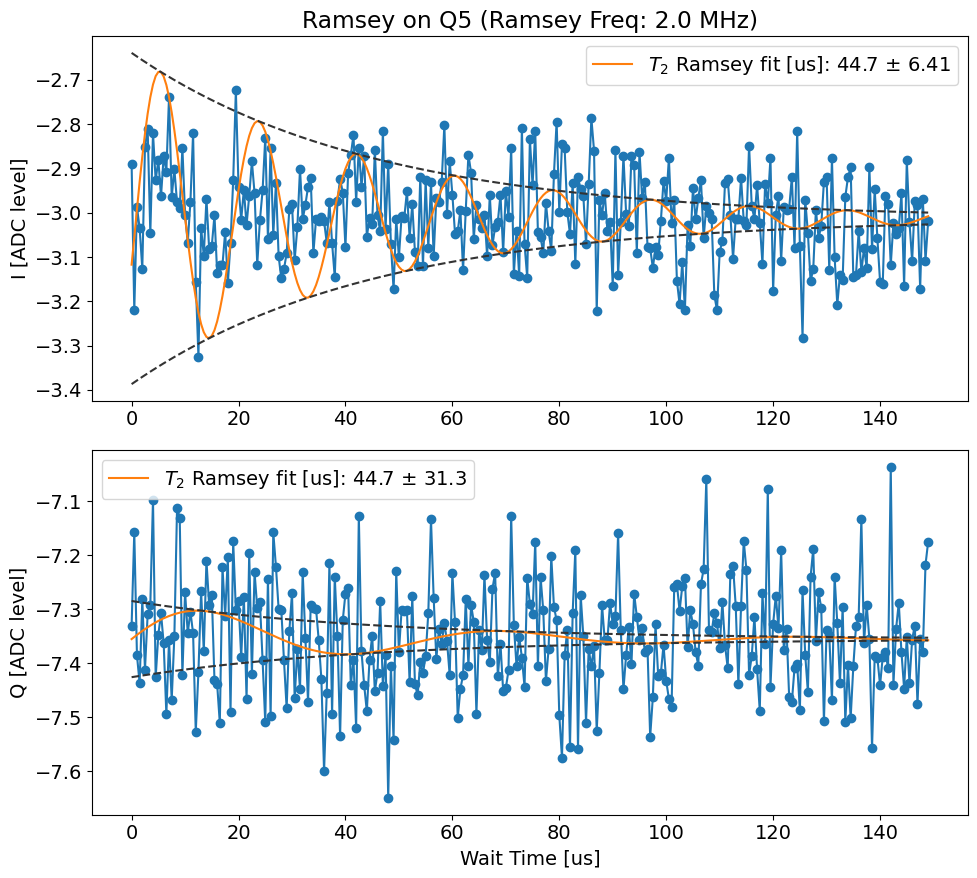

Replacing 3293.4711914611735 with 3291.416777404898 in results cfg file
qTest =  0.015606751327390422
gauss


  0%|          | 0/200000 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 0.023115577889447236, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Attempted to init fitparam 1 to 0.023115577889447236, which is out of bounds 3.3670033670033675e-05 to 0.003367003367003367. Instead init to 0.0017003367003367003
Pi gain from amps data [dac units]: 278
	Pi/2 gain from amps data [dac units]: 139
Pi gain from avgi data [dac units]: 14106
	Pi/2 gain from avgi data [dac units]: 7053
Pi gain from avgq data [dac units]: 272
	Pi/2 gain from avgq data [dac units]: 136


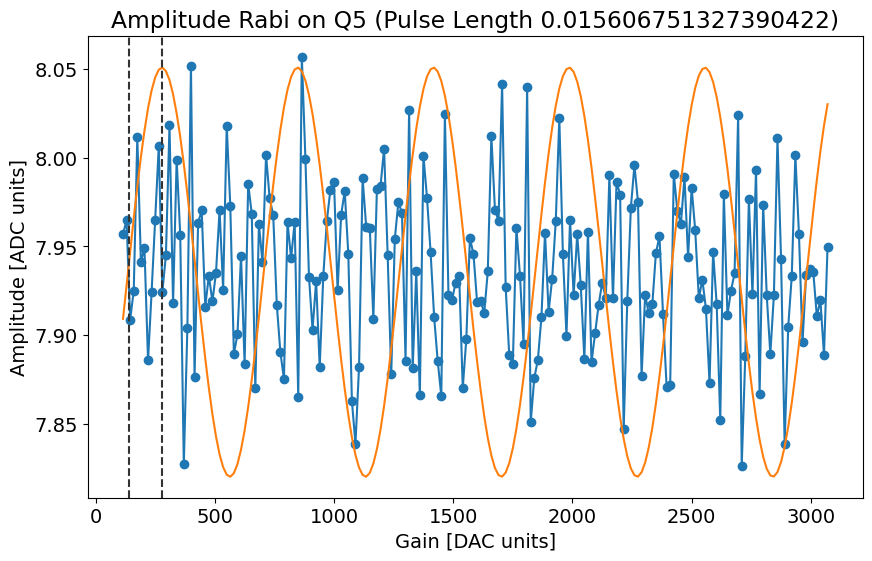

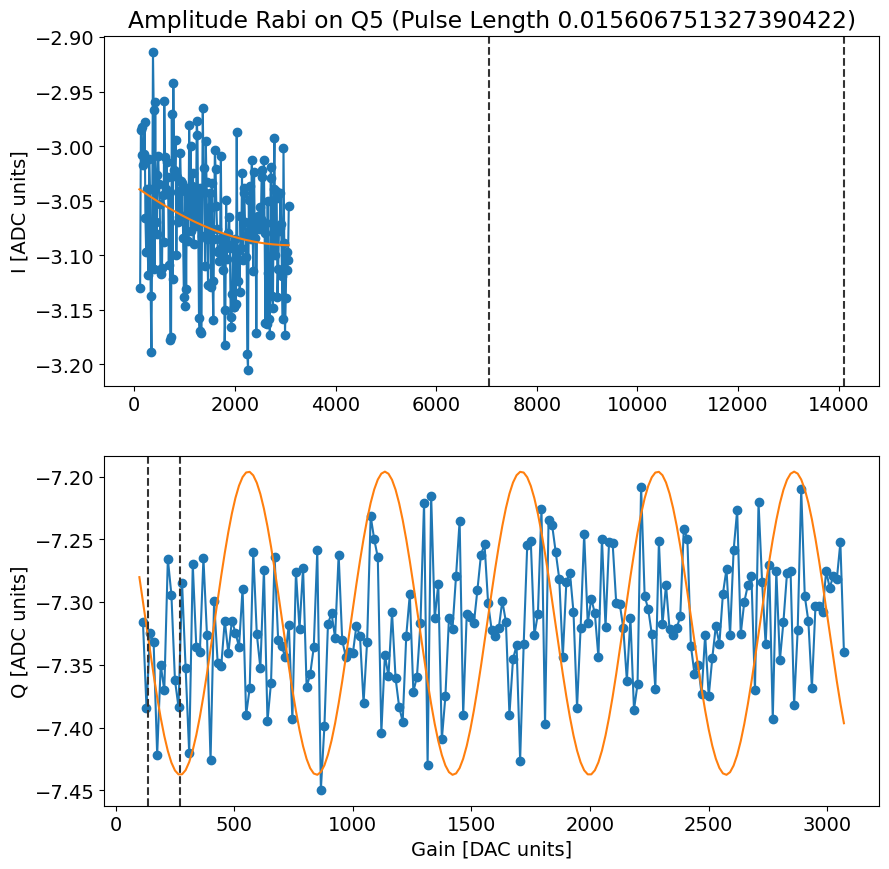

*Set cfg qubit 5 rabi amplitude to 14106* DAC units


  0%|          | 0/200000 [00:00<?, ?it/s]

Fit T1 avgi [us]: -5.8141446128099545
Fit T1 avgq [us]: 164.14371756645087


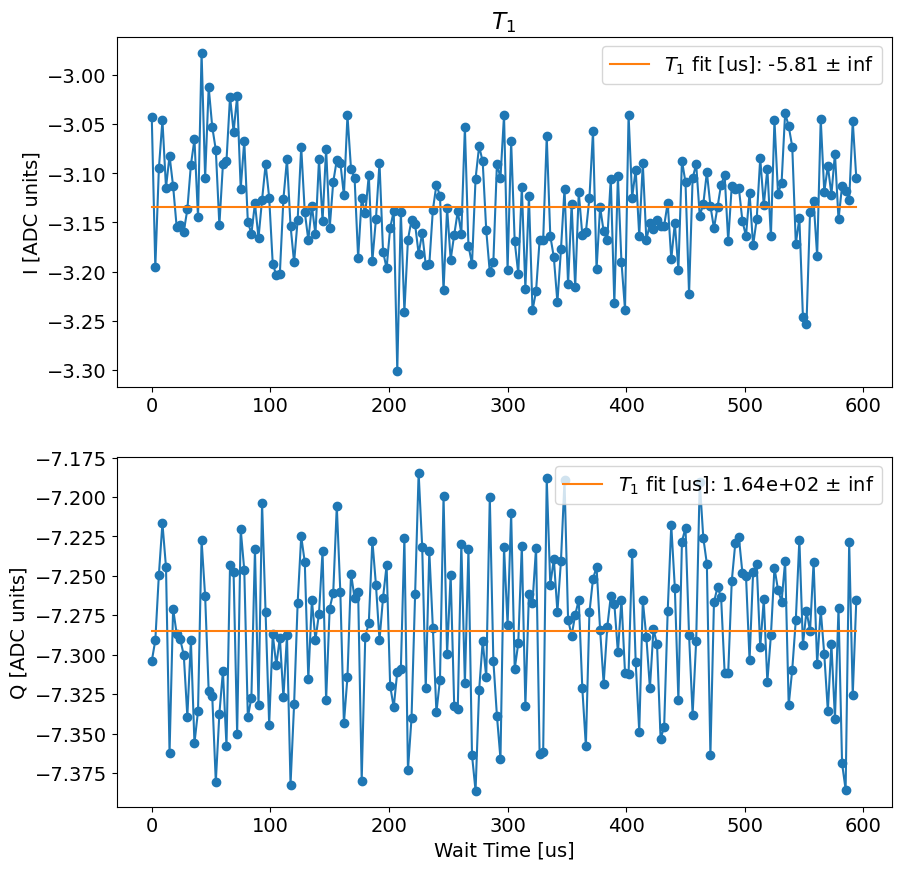

t1_i error:fit ratio= -inf
t1_q error:fit ratio= inf
t1_i is better, saving T1_i to results cfg file
*Set cfg qubit 5 T1 to -5.8141446128099545* us


  0%|          | 0/10000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 2.729067953001727
Fit T1 avgq [us]: 331495.33648640435
Average error ratio has exceeded threshold, stopping continuous T1. Recallibrate qubit.


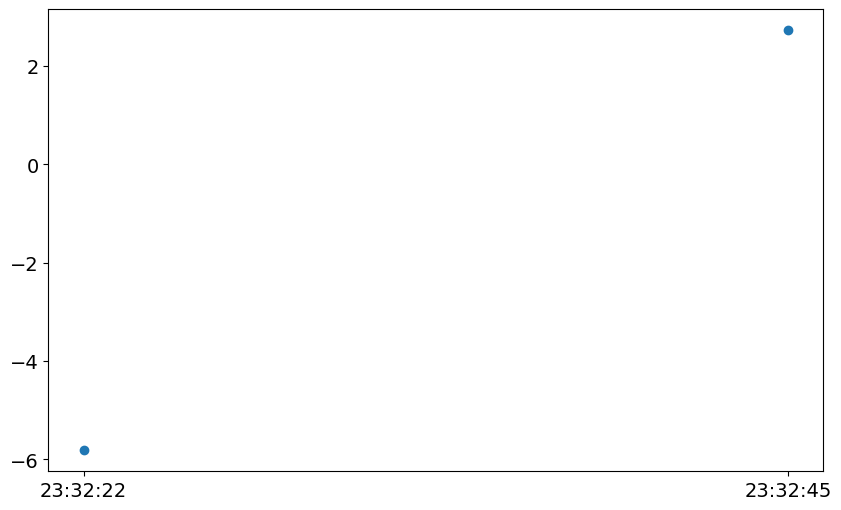

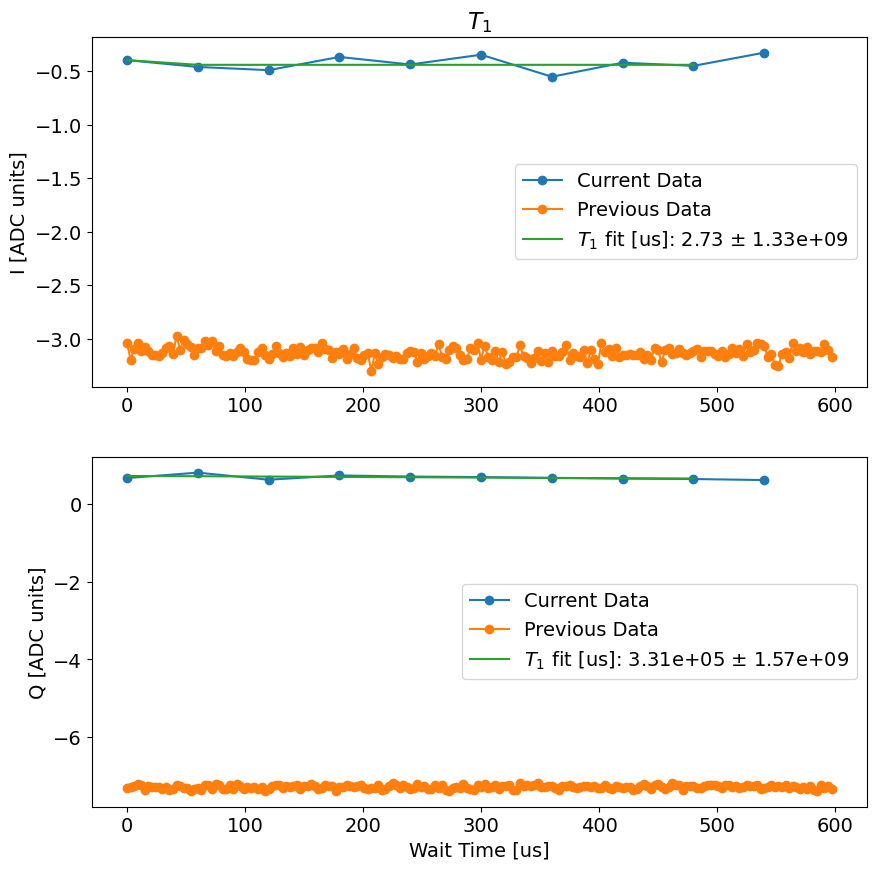

In [118]:
for k in range(len(auto_cfg.device.readout.frequency)): # define how many resonators you have (and thus how many qubits)



      lengthrabi.go(analyze=False, display=False, progress=True, save=False)
 
  lengthrabi.analyze(fit=True)
  lengthrabi.display(fit=True)


  # save the pi pulse length to the results config file
  p = lengthrabi.data['fit_avgi']     
  if p[2] > 180: p[2] = p[2] - 360
  elif p[2] < -180: p[2] = p[2] + 360
  if p[2] < 0: pi_length = (1/2 - p[2]/180)/2/p[1]
  else: pi_length= (3/2 - p[2]/180)/2/p[1]

  # open the results config file 
  with open(cfg_file,'r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary

  auto_cfg.device.qubit.pulses.pi_ge.sigma[qubit_i] = float(pi_length)


  auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True) # dump it 

  # write it: 
  with open('autocalibration_cfg.yml', 'w') as modified_file:
    modified_file.write(auto_cfg)
  # now, open the modified file again 
  with open('autocalibration_cfg.yml','r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 

  print(f'*Set cfg qubit {qubit_i} rabi length to {auto_cfg.device.qubit.pulses.pi_ge.sigma[qubit_i]}* us')


  # ---------------------------------------------------------------------------- #
  # Amplitude Rabi
  amprabi = meas.AmplitudeRabiExperiment(
      soccfg=soc,
      path=expt_path,
      prefix=f"amp_rabi_qubit{qubit_i}",
      config_file=cfg_path,
  )

  span = 2*auto_cfg.device.qubit.pulses.pi_ge.gain[qubit_i]
  npts = 200
  amprabi.cfg.expt = dict(
      # start=0, # qubit gain [dac level]
      # start=2047,
      start=0,
      step=int(span/npts), # [dac level]
      expts=npts,
      reps=100 * 10 ,
      rounds=1,
      sigma_test= auto_cfg.device.qubit.pulses.pi_ge.sigma[qubit_i], # gaussian sigma for pulse length - overrides config [us]
      checkZZ=False,
      checkEF=False, 
      qubits=[qubit_i],
      pulse_type='gauss',
      # pulse_type='const',
      num_pulses = 1, #number of pulses to play, must be an odd number in order to achieve a pi rotation at pi length/ num_pulses 
  )

  import Pyro4.util
  try:
      amprabi.go(analyze=False, display=False, progress=True, save=False)
  except Exception:
      print("Pyro traceback:")
      print("".join(Pyro4.util.getPyroTraceback()))

  amprabi.analyze(fit=True)
  amprabi.display(fit=True)

  p = amprabi.data['fit_avgi']
  if p[2] > 180: p[2] = p[2] - 360
  elif p[2] < -180: p[2] = p[2] + 360
  if p[2] < 0: pi_gain = (1/2 - p[2]/180)/2/p[1]
  else: pi_gain= (3/2 - p[2]/180)/2/p[1]

  # open the results config file 
  with open(cfg_file,'r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary

  auto_cfg.device.qubit.pulses.pi_ge.gain[qubit_i] = int(pi_gain)  # [DAC units]  

  auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True) # dump it 

  # write it: 
  with open('autocalibration_cfg.yml', 'w') as modified_file:
    modified_file.write(auto_cfg)
  # now, open the modified file again 
  with open('autocalibration_cfg.yml','r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 

  print(f'*Set cfg qubit {qubit_i} rabi amplitude to {auto_cfg.device.qubit.pulses.pi_ge.gain[qubit_i]}* DAC units')

  # ---------------------------------------------------------------------------- #
  # T2R Rabi

  t2r = meas.RamseyExperiment(
      soccfg=soc,
      path=expt_path,
      prefix=f"ramsey_qubit{qubit_i}",
      config_file=cfg_path,
  )

  t2r.cfg.expt = dict(
      start=0, # wait time tau [us]
      #step=soc.cycles2us(10), # [us] make sure nyquist freq = 0.5 * (1/step) > ramsey (signal) freq!
      step= 0.5, # [us]
      expts=300,
      ramsey_freq=2.0, # [MHz]
      reps=10 * 20 , # 100 * 20 (on hardware --> on board itself) 
      rounds=1, # set this = 1 (computer asking for 20 rounds --> faster if I don't have to communicate between computer and board)
      qubits=[qubit_i],
      checkZZ=False,
      checkEF=False,
  )

  import Pyro4.util
  try:
      t2r.go(analyze=False, display=False, progress=True, save=False)
  except Exception:
      print("Pyro traceback:")
      print("".join(Pyro4.util.getPyroTraceback()))


  t2r.analyze(fit=True, fit_twofreq=False)
  t2r.display(fit=True, fit_twofreq=False)

  t2r_fit, t2r_fit_err, t2r_adjust = meas.fitting.get_best_fit(t2r.data, get_best_data_params=['f_adjust_ramsey'])

  old_qubit_freq = t2r.cfg.device.qubit.f_ge[qubit_i]

  # open the results config file 
  with open(cfg_file,'r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary


  if t2r_adjust[0] < t2r_adjust[1]:
      print(f'Replacing {old_qubit_freq} with {t2r_adjust[0]+ old_qubit_freq} in results cfg file') 
      auto_cfg.device.qubit.f_ge[qubit_i] = float(old_qubit_freq + t2r_adjust[0])  # [DAC units]
  else:       
      print(f'Replacing {old_qubit_freq} with {t2r_adjust[1] + old_qubit_freq} in results cfg file')
      auto_cfg.device.qubit.f_ge[qubit_i] = float(old_qubit_freq + t2r_adjust[1])  # [DAC units]

auto_cfg = config.save(auto_cfg, cfg_file)

  # ---------------------------------------------------------------------------- #
  # Amplitude Rabi
  amprabi = meas.AmplitudeRabiExperiment(
      soccfg=soc,
      path=expt_path,
      prefix=f"amp_rabi_qubit{qubit_i}",
      config_file=cfg_path,
  )

  span = 3000
  npts = 200
  amprabi.cfg.expt = dict(
      start=100,
      step=int(span/npts), # [dac level]
      expts=npts,
      reps=100*10,
      rounds=1,
      sigma_test= auto_cfg.device.qubit.pulses.pi_ge.sigma[qubit_i], # gaussian sigma for pulse length - overrides config [us]
      checkZZ=False,
      checkEF=False, 
      qubits=[qubit_i],
      pulse_type='gauss',
      num_pulses = 1, 
  )

  import Pyro4.util
  try:
      amprabi.go(analyze=False, display=False, progress=True, save=False)
  except Exception:
      print("Pyro traceback:")
      print("".join(Pyro4.util.getPyroTraceback()))

  amprabi.analyze(fit=True)
  amprabi.display(fit=True)

  p = amprabi.data['fit_avgi']
  if p[2] > 180: p[2] = p[2] - 360
  elif p[2] < -180: p[2] = p[2] + 360
  if p[2] < 0: pi_gain = (1/2 - p[2]/180)/2/p[1]
  else: pi_gain= (3/2 - p[2]/180)/2/p[1]

  # open the results config file 
  with open(cfg_file,'r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary

  auto_cfg.device.qubit.pulses.pi_ge.gain[qubit_i] = int(pi_gain)  # [DAC units]  

  auto_cfg = config.save(auto_cfg, cfg_file)


  print(f'*Set cfg qubit {qubit_i} rabi amplitude to {auto_cfg.device.qubit.pulses.pi_ge.gain[qubit_i]}* DAC units')

  # ---------------------------------------------------------------------------- #
  # T1 
  t1 = meas.T1Experiment(
      soccfg=soc,
      path=expt_path,
      prefix=f"t1_qubit{qubit_i}",
      config_file= cfg_path,
  )

  span = 600 
  npts = 200

  t1.cfg.expt = dict(
    start=0, # wait time [us]
    step=int(span/npts), 
    expts=npts,
    reps=100*10, # number of times we repeat a time point 
    rounds=1, # number of start to finish sweeps to average over
    qubit=qubit_i,
    length_scan = span, # length of the scan in us
    num_saved_points = 10, # number of points to save for the T1 continuous scan 
  )

  t1.go(analyze=False, display=False, progress=True, save=False)
  t1.analyze(fit=True)
  t1.save_T1_Values()
  t1.display()

  t1_err_i = np.sqrt(t1.data['fit_err_avgi'][3][3])
  t1_fit_i =t1.data['fit_avgi'][3]
  err_ratio_i = t1_err_i/t1_fit_i
  print('t1_i error:fit ratio=', err_ratio_i)

  t1_err_q = np.sqrt(t1.data['fit_err_avgq'][3][3])
  t1_fit_q =t1.data['fit_avgq'][3]
  err_ratio_q = t1_err_q/t1_fit_q
  print('t1_q error:fit ratio=', err_ratio_q)

  # open the results config file 
  with open(cfg_file,'r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary

  if err_ratio_i< err_ratio_q:
      print('t1_i is better, saving T1_i to results cfg file') 
      auto_cfg.device.qubit.T1[qubit_i] = float(t1_fit_i)  # [DAC units]  

  else: 
      print('t1_q is better, saving t1_q to results cfg file')
      auto_cfg.device.qubit.T1[qubit_i] = float(t1_fit_q)  # [DAC units]  

  auto_cfg = config.save(auto_cfg, cfg_file)


  print(f'*Set cfg qubit {qubit_i} T1 to {auto_cfg.device.qubit.T1[qubit_i]}* us')

#-------------------------------------------------------------------------# Continuous T1  
# Run Continuous T1 on qubit 0
qubit_i = 0 
time_array = np.array([])
t1_i_array = np.array([])
t1_q_array = np.array([])   
t1_err_ratio_i = np.array([])
t1_err_ratio_q = np.array([]) 


time_array = np.append(time_array, t1.data['time'])
t1_i_array = np.append(t1_i_array, t1.data['fit_avgi'][3]) 
t1_q_array = np.append(t1_q_array, t1.data['fit_avgq'][3])  

plt.ion()
fig, ax = plt.subplots()
line, = ax.plot(time_array, t1_i_array, 'o', label = 't1_i')

while True:
    t1_cont = meas.T1Continuous(
        soccfg=soc,
        path=expt_path,
        prefix=f"t1_continuous_qubit{qubit_i}",
        config_file= cfg_path,
    )

    span = t1.cfg.expt.length_scan 
    npts = t1.cfg.expt.num_saved_points #eventually need to change this to t1.cfg.expt.num_saved_points

    t1_cont.cfg.expt = dict(
        start=0, # wait time [us]
        step=int(span/npts), 
        expts=npts,
        reps=100*10, # number of times we repeat a time point 
        rounds=1, # number of start to finish sweeps to average over
        qubit=qubit_i,
        prev_data_i = t1.data['avgi'],
        prev_data_q = t1.data['avgq'],
        prev_data_x = t1.data['xpts'],
    )

    t1_cont.go(analyze=True, display=True, progress=True, save=False)
    t1_cont.analyze(fit=True)

    # update the arrays
    time_array = np.append(time_array, t1_cont.data['time'])
    t1_i_array = np.append(t1_i_array, t1_cont.data["fit_avgi"][3])
    t1_q_array = np.append(t1_q_array, t1_cont.data["fit_avgq"][3])
    t1_err_ratio_i = np.append(t1_err_ratio_i, t1_cont.data["err_ratio_i"])
    t1_err_ratio_q = np.append(t1_err_ratio_q, t1_cont.data["err_ratio_q"])

    # update the plots to show the new T1 data
    line.set_xdata(time_array)
    line.set_ydata(t1_i_array) 

    # fig.canvas.flush_events()
    ax.relim()
    ax.autoscale_view()
    fig.canvas.draw()
    time.sleep(0.1)


    # figure out if the t1 error ratio has exceeded threshold (0.5*T1error_ratio)
    avg_err_ratio_i = np.mean(t1_err_ratio_i)
    avg_err_ratio_q = np.mean(t1_err_ratio_q)

    if avg_err_ratio_i > (0.5* t1.data["err_ratio_i"]):
        print('Average error ratio has exceeded threshold, stopping continuous T1. Recallibrate qubit.')
        break 

    if avg_err_ratio_q > (0.5* t1.data["err_ratio_q"]):
        print('Average error ratio has exceeded threshold, stopping continuous T1. Recallibrate qubit.')
        break 

## Continuous T1 for 2 Qubits

  0%|          | 0/200000 [00:00<?, ?it/s]

Fit T1 avgi [us]: 177.46967033548438
Fit T1 avgq [us]: 178.23236425325933


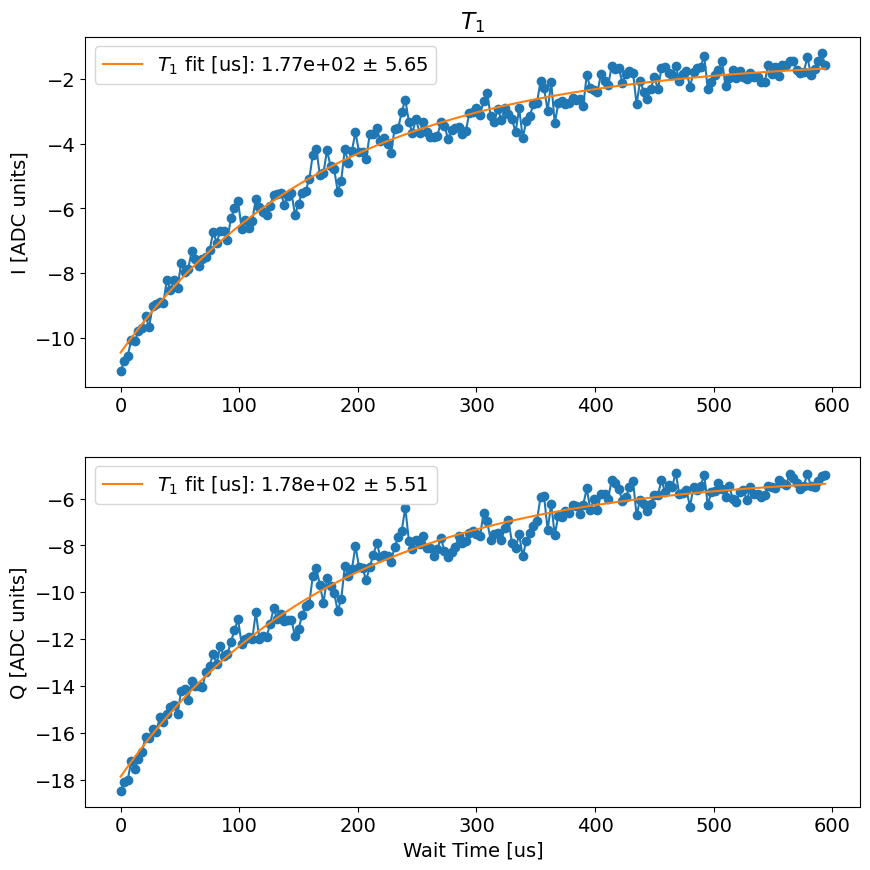

In [221]:
qubit_i = 4
t1 = meas.T1Experiment(
    soccfg=soc,
    path=expt_path,
    prefix=f"t1_qubit{qubit_i}",
    config_file= cfg_path,
)

span = 600 
npts = 200

t1.cfg.expt = dict(
    start=0, # wait time [us]
    step=int(span/npts), 
    expts=npts,
    reps=100*10, # number of times we repeat a time point 
    rounds=1, # number of start to finish sweeps to average over
    qubit=qubit_i,
    length_scan = span, # length of the scan in us
    num_saved_points = 10, # number of points to save for the T1 continuous scan 
)

t1.go(analyze=False, display=False, progress=True, save=False)
t1.analyze(fit=True)
t1.display()

In [222]:
qubit_i = 4
# open the results config file 
with open(cfg_file,'r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary

auto_cfg.device.qubit.T1[qubit_i] = float(t1.data['fit_avgi'][3])  # [DAC units]

# dump it 
auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  False) 

# write it: 
with open('autocalibration_cfg.yml', 'w') as modified_file:
    modified_file.write(auto_cfg)
# now, open the modified file again 
with open('autocalibration_cfg.yml','r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 


In [8]:
import numpy as np
import matplotlib.pyplot as plt
from timeit import default_timer as timer
import yaml

qubit_i = 0 
# Function to run T1 continuous measurement
def run_continuous_t1(qubit_i, t1_raw_i, t1_raw_q, t1_amps):
    t1_cont = meas.T1Continuous(
        soccfg=soc,
        path=expt_path,
        prefix=f"t1_continuous_qubit{qubit_i}",
        config_file=cfg_path,
    )

    span = auto_cfg.device.qubit.T1[qubit_i]
    npts = 1

    t1_cont.cfg.expt = dict(
        start=span / npts,  # wait time [us]
        step=0,
        expts=npts,
        reps= 1000 * 10,  # number of times we repeat a time point
        rounds=1,  # number of start to finish sweeps to average over
        qubit=qubit_i,
    )

    t1_cont.go(analyze=False, display=False, progress=True, save=False)
    t1_raw_i = np.append(t1_raw_i, t1_cont.data['raw_i'])
    t1_raw_q = np.append(t1_raw_q, t1_cont.data['raw_q'])
    t1_amps = np.append(t1_amps, t1_cont.data['raw_amps'])
    return t1_raw_i, t1_raw_q, t1_amps

# Function to run T1 experiment for recalibration
def run_t1_recalibration(qubit_i):
    t1 = meas.T1Experiment(
        soccfg=soc,
        path=expt_path,
        prefix=f"t1_qubit{qubit_i}",
        config_file=cfg_path,
    )

    span = 600
    npts = 100

    t1.cfg.expt = dict(
        start=0,  # wait time [us]
        step=int(span / npts),
        expts=npts,
        reps=100 * 5,  # number of times we repeat a time point
        rounds=1,  # number of start to finish sweeps to average over
        qubit=qubit_i,
        length_scan=span,  # length of the scan in us
        num_saved_points=1,  # number of points to save for the T1 continuous scan
    )

    t1.go(analyze=False, display=False, progress=True, save=False)
    t1.analyze(fit=True)
    t1_err_i = np.sqrt(t1.data['fit_err_avgi'][3][3])
    t1_fit_i =t1.data['fit_avgi'][3]
    err_ratio_i = t1_err_i/t1_fit_i

    t1_err_q = np.sqrt(t1.data['fit_err_avgq'][3][3])
    t1_fit_q =t1.data['fit_avgq'][3]
    err_ratio_q = t1_err_q/t1_fit_q

    # open the results config file 
    with open(cfg_file,'r') as file:
        auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary

    if err_ratio_i< err_ratio_q:
        print('t1_i is better, saving T1_i to results cfg file') 
        auto_cfg.device.qubit.T1[qubit_i] = float(t1_fit_i)  # [DAC units]  

    else: 
        print('t1_q is better, saving t1_q to results cfg file')
        auto_cfg.device.qubit.T1[qubit_i] = float(t1_fit_q)  # [DAC units]  

    auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True) # dump it 

    # write it: 
    with open('autocalibration_cfg.yml', 'w') as modified_file:
        modified_file.write(auto_cfg)
    # now, open the modified file again 
    with open('autocalibration_cfg.yml','r') as file:
        auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary
    

# Main script
qubit_i = 0
t1_raw_i = np.array([])
t1_raw_q = np.array([])     
t1_amps = np.array([])

t1_i = np.array([])
t1_q = np.array([])
t1_amp = np.array([])
start_time = timer()

while True:  # Run continuously
    # Run continuous T1 measurement
    t1_raw_i, t1_raw_q, t1_amps = run_continuous_t1(qubit_i, t1_raw_i, t1_raw_q, t1_amps)
    t1_i = np.append(t1_raw_i, t1_i)
    t1_q = np.append(t1_raw_q, t1_q)
    t1_amp = np.append(t1_amps, t1_amp)
    end_time = timer()
    if end_time - start_time >=1* 30: 
        with open('test.csv', 'a') as file:
            np.savetxt(file, [t1_i], delimiter=',', newline='\n')
        with open('test.csv', 'a') as file:
            np.savetxt(file, [t1_q], delimiter=',', newline='\n')
        with open('test.csv', 'a') as file:
            np.savetxt(file, [t1_amp], delimiter=',', newline='\n')
        
        print( end_time - start_time, 'has passed. Running T1 recalibration.')
        # Run T1 experiment for recalibration
        t1 = run_t1_recalibration(qubit_i)
        start_time = timer()  # Reset the start time after recalibration
        t1_raw_i = np.array([])  # Reset the raw T1 data array after recalibration
        t1_raw_q = np.array([])  # Reset the raw T1 data array after recalibration
        t1_amps = np.array([])


  0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/10000 [00:00<?, ?it/s]

55.00139050002326 has passed. Running T1 recalibration.


  0%|          | 0/50000 [00:00<?, ?it/s]

t1_q is better, saving t1_q to results cfg file


  0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/10000 [00:00<?, ?it/s]

54.941871200018795 has passed. Running T1 recalibration.


  0%|          | 0/50000 [00:00<?, ?it/s]

t1_q is better, saving t1_q to results cfg file


  0%|          | 0/10000 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [19]:
import numpy as np
import matplotlib.pyplot as plt
from timeit import default_timer as timer
import yaml

qubit_i = 0 
# Function to run T1 continuous measurement
def run_continuous_t1(qubit_i):
    t1_cont = meas.T1Continuous(
        soccfg=soc,
        path=expt_path,
        prefix=f"t1_continuous_qubit{qubit_i}",
        config_file=cfg_path,
    )

    span = auto_cfg.device.qubit.T1[qubit_i]
    npts = 1

    t1_cont.cfg.expt = dict(
        start=span / npts,  # wait time [us]
        step=0,
        expts=npts,
        reps= 1000 * 10,  # number of times we repeat a time point
        rounds=1,  # number of start to finish sweeps to average over
        qubit=qubit_i,
    )

    t1_cont.go(analyze=False, display=False, progress=True, save=False)
    t1_raw_i = t1_cont.data['raw_i']
    t1_raw_q = t1_cont.data['raw_q']
    t1_amps = t1_cont.data['raw_amps']
    return t1_raw_i, t1_raw_q, t1_amps

# Function to run T1 experiment for recalibration
def run_t1_recalibration(qubit_i):
    t1 = meas.T1Experiment(
        soccfg=soc,
        path=expt_path,
        prefix=f"t1_qubit{qubit_i}",
        config_file=cfg_path,
    )

    span = 600
    npts = 100

    t1.cfg.expt = dict(
        start=0,  # wait time [us]
        step=int(span / npts),
        expts=npts,
        reps=100 ,  # number of times we repeat a time point
        rounds=1,  # number of start to finish sweeps to average over
        qubit=qubit_i,
        length_scan=span,  # length of the scan in us
        num_saved_points=1,  # number of points to save for the T1 continuous scan
    )

    t1.go(analyze=False, display=False, progress=True, save=False)
    t1.analyze(fit=True)
    t1_err_i = np.sqrt(t1.data['fit_err_avgi'][3][3])
    t1_fit_i =t1.data['fit_avgi'][3]
    err_ratio_i = t1_err_i/t1_fit_i

    t1_err_q = np.sqrt(t1.data['fit_err_avgq'][3][3])
    t1_fit_q =t1.data['fit_avgq'][3]
    err_ratio_q = t1_err_q/t1_fit_q

    # open the results config file 
    with open(cfg_file,'r') as file:
        auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary

    if err_ratio_i< err_ratio_q:
        print('t1_i is better, saving T1_i to results cfg file') 
        auto_cfg.device.qubit.T1[qubit_i] = float(t1_fit_i)  # [DAC units]  

    else: 
        print('t1_q is better, saving t1_q to results cfg file')
        auto_cfg.device.qubit.T1[qubit_i] = float(t1_fit_q)  # [DAC units]  

    auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True) # dump it 

    # write it: 
    with open('autocalibration_cfg.yml', 'w') as modified_file:
        modified_file.write(auto_cfg)
    # now, open the modified file again 
    with open('autocalibration_cfg.yml','r') as file:
        auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary
    

# Main script
qubit_i = 0
t1_raw_i = np.array([])
t1_raw_q = np.array([])     
t1_amps = np.array([])

t1_i = np.array([])
t1_q = np.array([])
t1_amp = np.array([])

t1_i_array = np.array([])
t1_q_array = np.array([])
t1_amp_array = np.array([])
start_time = timer()

while True:  # Run continuously4
    # Run continuous T1 measurement
    t1_raw_i = np.array([])  # Reset the raw T1 data array after recalibration
    t1_raw_q = np.array([])  # Reset the raw T1 data array after recalibration
    t1_amps = np.array([])

    t1_raw_i, t1_raw_q, t1_amps = run_continuous_t1(qubit_i)

    t1_i = np.append(t1_raw_i, t1_i_array)
    t1_q = np.append(t1_raw_q, t1_q_array)
    t1_amp = np.append(t1_amps, t1_amp_array)
    end_time = timer()

    if end_time - start_time >=1* 30: 
        with open('t1_i02.csv', 'a') as file:
            np.savetxt(file, [t1_i_array], delimiter=',', newline='\n')
        with open('t1_q02.csv', 'a') as file:
            np.savetxt(file, [t1_q_array], delimiter=',', newline='\n')
        with open('t1_amp02.csv', 'a') as file:
            np.savetxt(file, [t1_amp_array], delimiter=',', newline='\n')
        
        print( end_time - start_time, 'has passed. Running T1 recalibration.')
        # Run T1 experiment for recalibration
        t1 = run_t1_recalibration(qubit_i)
        start_time = timer()  # Reset the start time after recalibration
        t1_raw_i = np.array([])  # Reset the raw T1 data array after recalibration
        t1_raw_q = np.array([])  # Reset the raw T1 data array after recalibration
        t1_amps = np.array([])

  0%|          | 0/10000 [00:00<?, ?it/s]

  0%|          | 0/10000 [00:00<?, ?it/s]

55.06126139999833 has passed. Running T1 recalibration.


  0%|          | 0/10000 [00:00<?, ?it/s]

KeyboardInterrupt: 

## THIS IS THE ONE THAT ACTUALLY WORKS

In [11]:
import numpy as np
from timeit import default_timer as timer

# Assuming imports for 'meas', 'AttrDict', 'yaml', and relevant configurations

def run_continuous_t1(qubit_i):
    t1_cont = meas.T1Continuous(
        soccfg=soc,
        path=expt_path,
        prefix=f"t1_continuous_qubit{qubit_i}",
        config_file=cfg_path,
    )

    span = auto_cfg.device.qubit.T1[qubit_i]
    npts = 1

    t1_cont.cfg.expt = dict(
        start=span / npts,  # wait time [us]
        step=0,
        expts=npts,
        reps= 10000 * 10,  # number of times we repeat a time point
        rounds=1,  # number of start to finish sweeps to average over
        qubit=qubit_i,
    )

    t1_cont.go(analyze=False, display=False, progress=True, save=False)
    t1_raw_i = t1_cont.data['raw_i']
    t1_raw_q = t1_cont.data['raw_q']
    t1_amps = t1_cont.data['raw_amps']
    return t1_raw_i, t1_raw_q, t1_amps
pass

def run_t1_recalibration(qubit_i):
    t1 = meas.T1Experiment(
        soccfg=soc,
        path=expt_path,
        prefix=f"t1_qubit{qubit_i}",
        config_file=cfg_path,
        )

    span = 600
    npts = 100

    t1.cfg.expt = dict(
        start=0,  # wait time [us]
        step=int(span / npts),
        expts=npts,
        reps=100*5 ,  # number of times we repeat a time point
        rounds=1,  # number of start to finish sweeps to average over
        qubit=qubit_i,
        length_scan=span,  # length of the scan in us
        num_saved_points=1,  # number of points to save for the T1 continuous scan
        )

    t1.go(analyze=False, display=False, progress=True, save=False)
    t1.analyze(fit=True)
    t1_err_i = np.sqrt(t1.data['fit_err_avgi'][3][3])
    t1_fit_i =t1.data['fit_avgi'][3]
    err_ratio_i = t1_err_i/t1_fit_i

    t1_err_q = np.sqrt(t1.data['fit_err_avgq'][3][3])
    t1_fit_q =t1.data['fit_avgq'][3]
    err_ratio_q = t1_err_q/t1_fit_q

    # open the results config file 
    with open(cfg_file,'r') as file:
        auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary

    if err_ratio_i< err_ratio_q:
        print('t1_i is better, saving T1_i to results cfg file') 
        auto_cfg.device.qubit.T1[qubit_i] = float(t1_fit_i)  # [DAC units]  

    else: 
        print('t1_q is better, saving t1_q to results cfg file')
        auto_cfg.device.qubit.T1[qubit_i] = float(t1_fit_q)  # [DAC units]  

    auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True) # dump it 

    # write it: 
    with open('autocalibration_cfg.yml', 'w') as modified_file:
        modified_file.write(auto_cfg)
    # now, open the modified file again 
    with open('autocalibration_cfg.yml','r') as file:
        auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary
    
    pass

# Main script
def main():
    qubit_i = 0
    t1_i, t1_q, t1_amp = np.array([]), np.array([]), np.array([])  # Initialize arrays

    start_time = timer()

    while True:  
        t1_raw_i_data, t1_raw_q_data, t1_amps_data = np.array([]), np.array([]), np.array([])  # Reset data arrays
        t1_raw_i_data, t1_raw_q_data, t1_amps_data = run_continuous_t1(qubit_i)
        
        # Append new data to arrays
        t1_i = np.append(t1_i, t1_raw_i_data)
        t1_q = np.append(t1_q, t1_raw_q_data)
        t1_amp = np.append(t1_amp, t1_amps_data)


        # t1_raw_i_data, t1_raw_q_data, t1_amps_data = np.array([]), np.array([]), np.array([])
        end_time = timer()

        if end_time - start_time >= 30*60: 
            # Save data
            np.savetxt('testi.csv', t1_i, delimiter=',')
            np.savetxt('testq.csv', t1_q, delimiter=',')
            np.savetxt('testamp.csv', t1_amp, delimiter=',')
            
            print(f"{end_time - start_time} seconds have passed. Running T1 recalibration.")
            run_t1_recalibration(qubit_i)
            start_time = timer()  # Reset the start time
            # t1_i, t1_q, t1_amp = np.array([]), np.array([]), np.array([])  # Reset data arrays

if __name__ == "__main__":
    main()


  0%|          | 0/100000 [00:00<?, ?it/s]

KeyboardInterrupt: 

Plot the results of 1 QB continuous measurements: 

Two Qubit T1

In [28]:
import numpy as np
import matplotlib.pyplot as plt
from timeit import default_timer as timer
import yaml

qubit_i = 0
qubit_j = 4
# Function to run T1 continuous measurement
def run_continuous_t1(qubit_i, t1_raw_ia, t1_raw_ib):
    t1_cont = meas.T1_2qbContinuous(
        soccfg=soc,
        path=expt_path,
        prefix=f"t1_continuous_2qubit{qubit_i, qubit_j}",
        config_file=cfg_path,
    )

    spanA = auto_cfg.device.qubit.T1[qubit_i]
    spanB = auto_cfg.device.qubit.T1[qubit_j]
    npts = 1

    t1_cont.cfg.expt = dict(
        startA= spanA / npts,  # wait time [us]
        startB = spanB / npts,  # wait time [us]
        step=0,
        expts=npts,
        reps=100 * 50,  # number of times we repeat a time point
        rounds=1,  # number of start to finish sweeps to average over
        qubits=[qubit_i, qubit_j],
    )

    t1_cont.go(analyze=False, display=False, progress=True, save=False)
    t1_raw_ia = np.append(t1_raw_ia, t1_cont.data['raw_ia'])
    t1_raw_ib = np.append(t1_raw_ib, t1_cont.data['raw_ib'])


    return t1_raw_ia, t1_raw_ib

# Function to run T1 experiment for recalibration
def run_t1_recalibration(qubit_i, qubit_j):
    t1 = meas.T1_2qbExperiment(
        soccfg=soc,
        path=expt_path,
        prefix=f"t1_2qubit{qubit_i, qubit_j}",
        config_file=cfg_path,
    )

    span = 600
    npts = 200

    t1.cfg.expt = dict(
        start=0,  # wait time [us]
        step=int(span / npts),
        expts=npts,
        reps=100 * 10,  # number of times we repeat a time point
        rounds=1,  # number of start to finish sweeps to average over
        qubit= [qubit_i, qubit_j],
        length_scan=span,  # length of the scan in us
        num_saved_points=1,  # number of points to save for the T1 continuous scan
    )

    t1.go(analyze=False, display=False, progress=True, save=False)
    t1.analyze(fit=True)
    t1_fit_ia =t1.data['fit_avgia'][3]
    t1_fit_ib = t1.data['fit_avgib'][3]
    # open the results config file 
    with open(cfg_file,'r') as file:
        auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary

    auto_cfg.device.qubit.T1[qubit_i] = float(t1_fit_ia)  # [DAC units]  
    auto_cfg.device.qubit.T1[qubit_j] = float(t1_fit_ib)  # [DAC units]  

    
    auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  False) # dump it 

    # write it: 
    with open('autocalibration_cfg.yml', 'w') as modified_file:
        modified_file.write(auto_cfg)
    # now, open the modified file again 
    with open('autocalibration_cfg.yml','r') as file:
        auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary
    

# Main script
qubit_i = 0
t1_raw_ia = np.array([])
t1_raw_ib =  np.array([])
start_time = timer()

while True:  # Run continuously
    # Run continuous T1 measurement
    t1_raw_ib, t1_raw_ia = np.append(run_continuous_t1(qubit_i, t1_raw_ia, t1_raw_ib), t1_raw_ia, t1_raw_ib)

    end_time = timer()
    if end_time - start_time >= 30:
        print( end_time - start_time, 'has passed. Running T1 recalibration.')
        # Run T1 experiment for recalibration
        t1 = run_t1_recalibration(qubit_i, qubit_j)
        start_time = timer()  # Reset the start time after recalibration


TypeError: 'int' object is not iterable

## Qubit Calibration 

  0%|          | 0/250 [00:00<?, ?it/s]

From Fit:
	f0: 7097.9896932530455
	kappa[MHz]: 0.2952591750505526


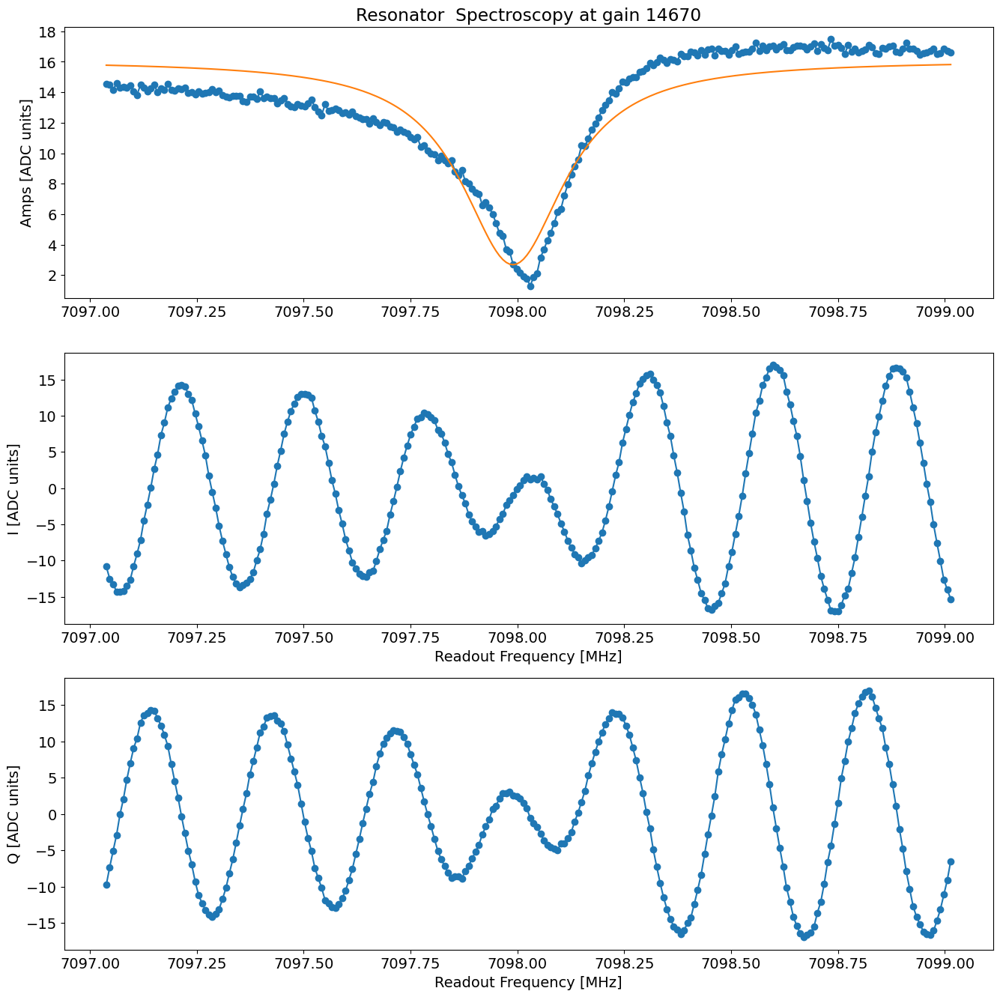

In [20]:
# Resonator Spectroscopy
qubit_i = 0
rspec = meas.ResonatorSpectroscopyExperiment(
    soccfg=soc,
    path=expt_path,
    prefix=f"resonator_spectroscopy_qubit{qubit_i}",
    config_file=cfg_path,   
)
span = 2 # MHz
npts = 250 

rspec.cfg.expt = dict(
    start=rspec.cfg.device.readout.frequency[qubit_i]-span/2, # resonator 
    step=span/npts, # min step ~1 Hz
    expts=npts, # Number experiments stepping from start
    reps= 500, # Number averages per point 500
    pulse_e=False, # add ge pi pulse prior to measurement
    pulse_f=False, # add ef pi pulse prior to measurement
    qubit=qubit_i,
)

rspec.cfg.device.readout.relax_delay = 5 # Wait time between experiments [us]
rspec.go(analyze=False, display=False, progress=True, save=False)

rspec.analyze(fit=True, findpeaks=False)
rspec.display(fit=True, findpeaks=False)





From Fit:
	f0: 7097.9896932530455
	kappa[MHz]: 0.2952591750505526


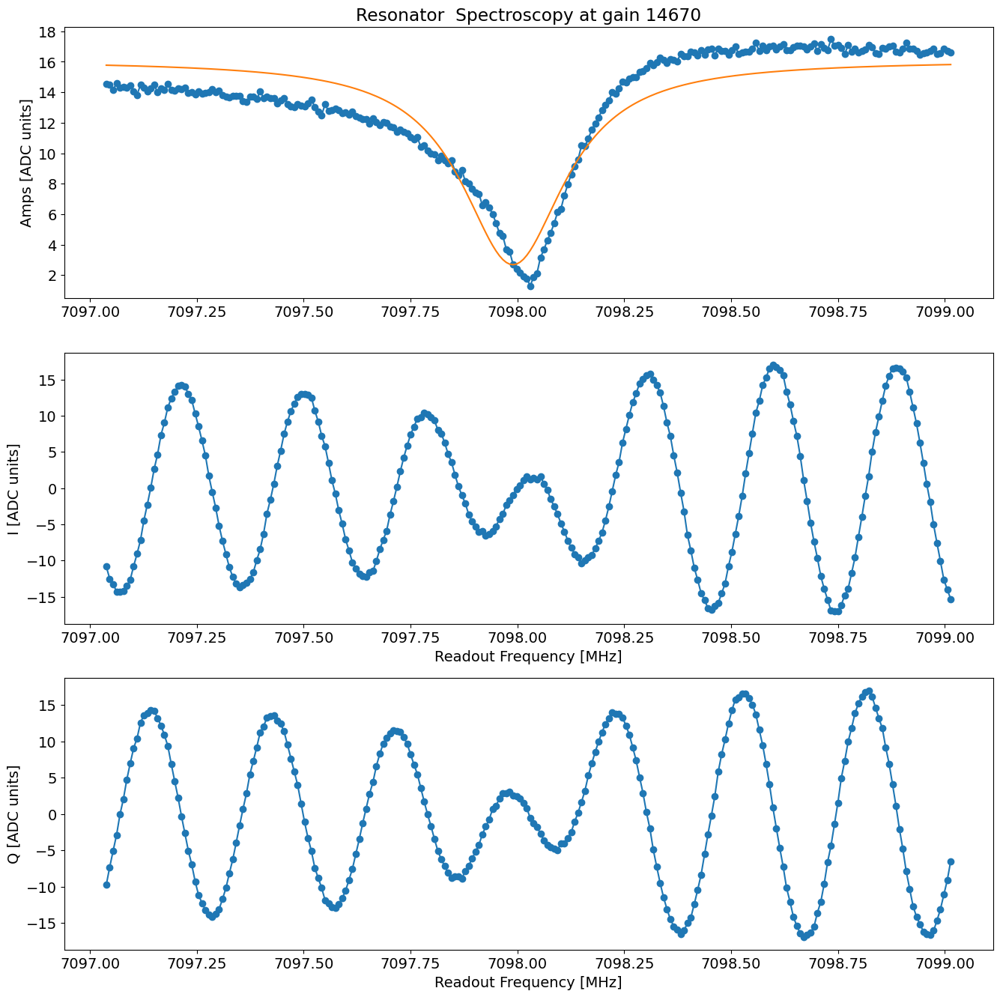

In [21]:
rspec.analyze(fit=True, findpeaks=False)
rspec.display(fit=True, findpeaks=False)

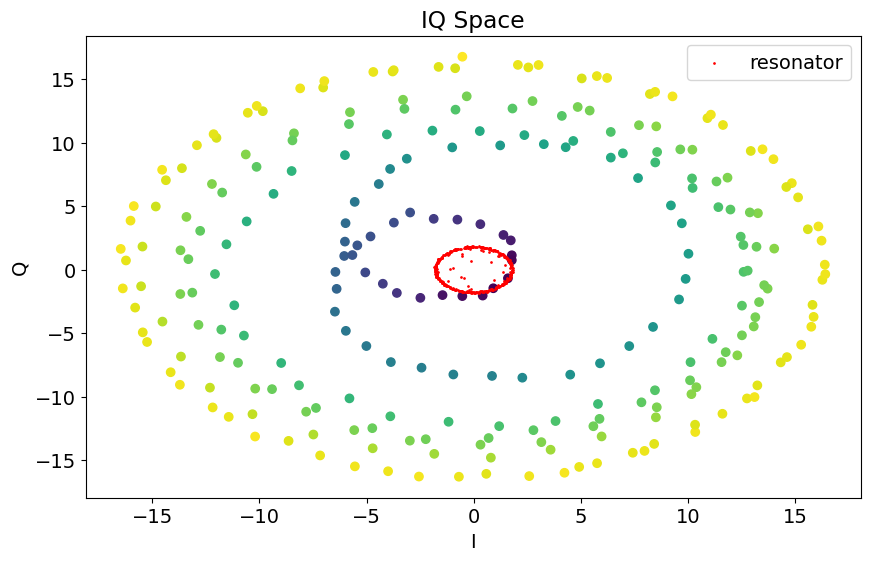

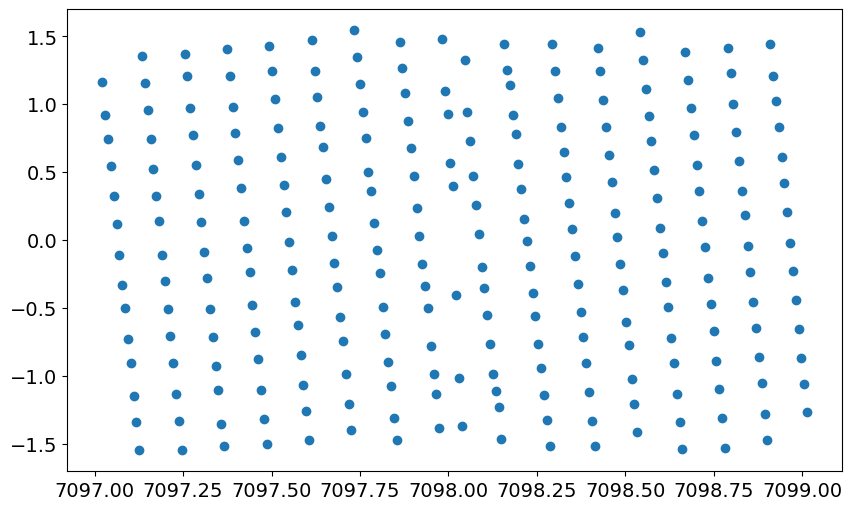

In [78]:
I = rspec.data['avgi']
Q = rspec.data['avgq']  
amp = np.sqrt(I**2 + Q**2)

i_res = []
q_res = []

for i, q in zip(g['avgi'][:], g['avgq'][:]):
    if i**2 + q**2 < 15**2:
        i_res.append(i)
        q_res.append(q)

    
plt.scatter(I, Q, c = amp)
plt.scatter(i_res, q_res, color='r', s = 0.9, label = 'resonator')
plt.xlabel('I')
plt.ylabel('Q')
plt.title('IQ Space')
plt.legend() 

plt.figure() 
phase = (np.arctan(rspec.data['avgq']/rspec.data['avgi']))
plt.plot(rspec.data['xpts'], phase, 'o')

<KeysViewHDF5 ['amps', 'avgi', 'avgq', 'fit', 'fit_err', 'phases', 'xpts']>
(400,)
(400,)
(400,)


C:\Users\slab\AppData\Local\Temp\ipykernel_16996\3476783682.py:50: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(3, 1, 1)


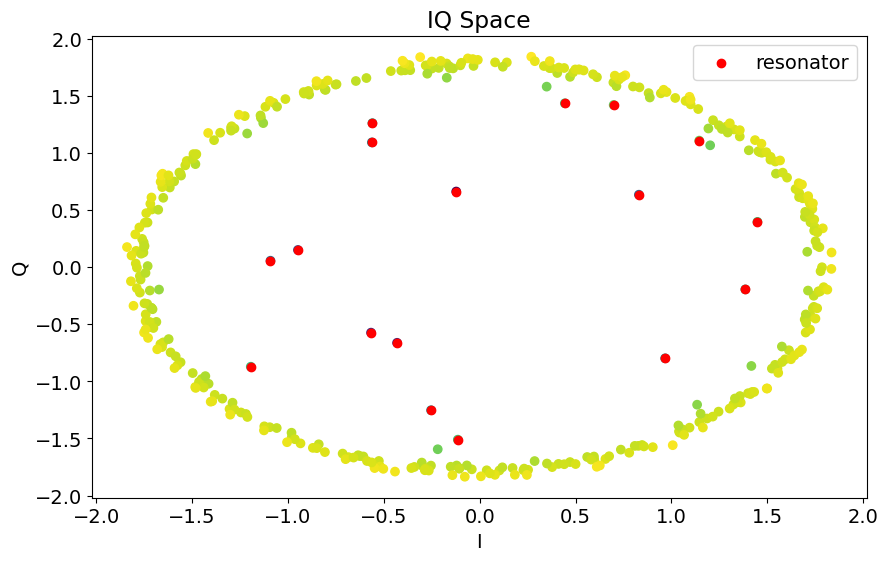

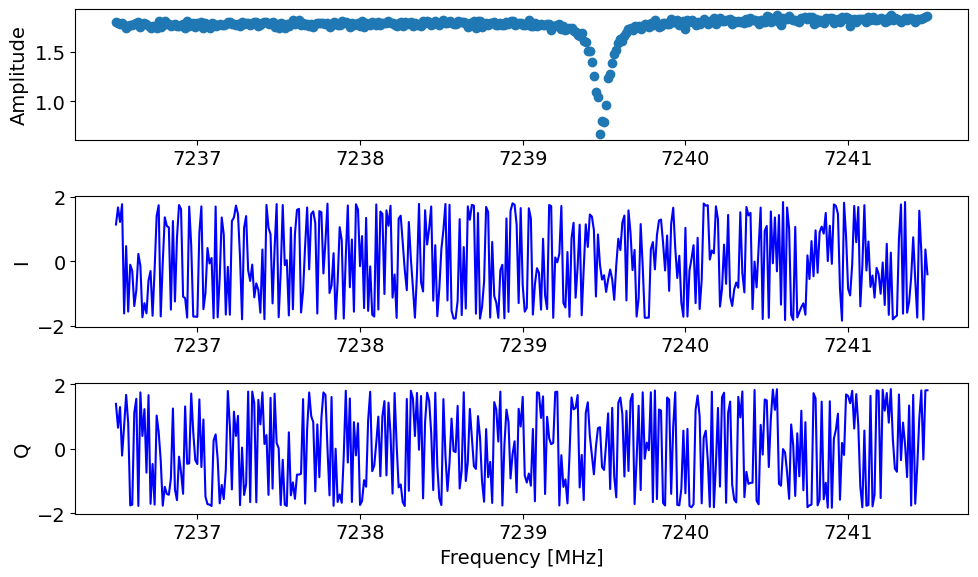

In [76]:
# open h5 file 
import h5py
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm


pth = "C:\\_Lib\\python\\rfsoc\\elaine_rfsoc\\slab_rfsoc_expts\\data\\00000_resonator_spectroscopy_qubit5.h5"

g = h5py.File(pth, 'r')
print(g.keys())

# plt.plot(g['avgi'], g['avgq'], 'o')
print(np.shape(g['avgi']))
print(np.shape(g['avgq']))  
print(np.shape(g['xpts']))

amp = np.sqrt(g['avgi'][:]**2 + g['avgq'][:]**2)

# extract the points that contribute to the resonator peak

i_res = []
q_res = []

for i, q in zip(g['avgi'][:], g['avgq'][:]):
    if i**2 + q**2 < 1.6**2:
        i_res.append(i)
        q_res.append(q)


#colors = cm.rainbow(g['xpts'][:])
#print(colors)

plt.scatter(g['avgi'][:], g['avgq'][:], c =amp)
plt.scatter(i_res, q_res, c='red', label='resonator')
plt.xlabel('I')
plt.ylabel('Q')
plt.title('IQ Space')
plt.legend()

plt.figure()
plt.plot(g['xpts'][:], g['avgi'][:], 'green')
plt.plot(g['xpts'][:], g['avgq'][:], 'blue')


# plt.figure()
# amp = np.sqrt(g['avgi'][:]**2 + g['avgq'][:]**2)
# create a subplot with 1 column and 3 rows 

plt.subplot(3, 1, 1)
plt.plot(g['xpts'][:], amp,  'o')
plt.ylabel('Amplitude')
plt.subplot(3, 1, 2)
plt.plot(g['xpts'][:], g['avgi'][:], 'blue')
plt.ylabel('I')
plt.subplot(3, 1, 3)
plt.plot(g['xpts'][:], g['avgq'][:], 'blue')
plt.xlabel('Frequency [MHz]')
plt.ylabel('Q')
# reshape the subplot to fit the figure
plt.tight_layout()

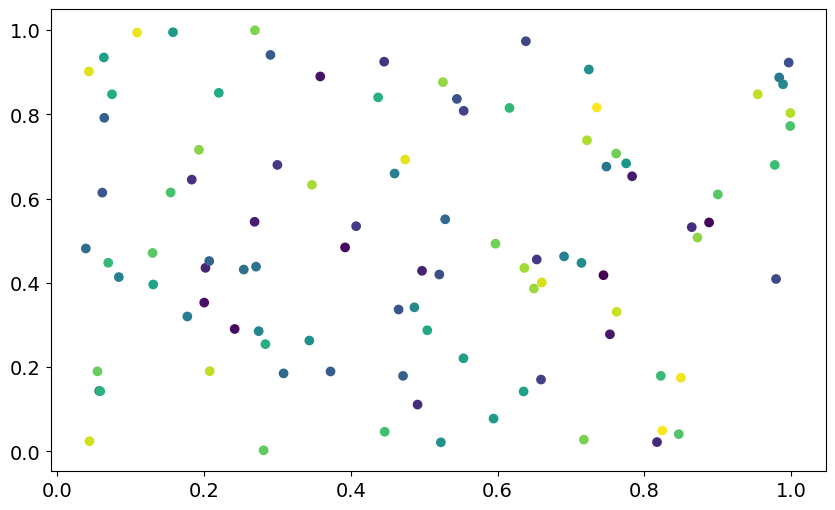

In [51]:
import numpy as np
import matplotlib.pyplot as plt

x = np.random.rand(100)
y = np.random.rand(100)
t = np.arange(100)

plt.scatter(x, y, c=t)
plt.show()

7098.030026730655


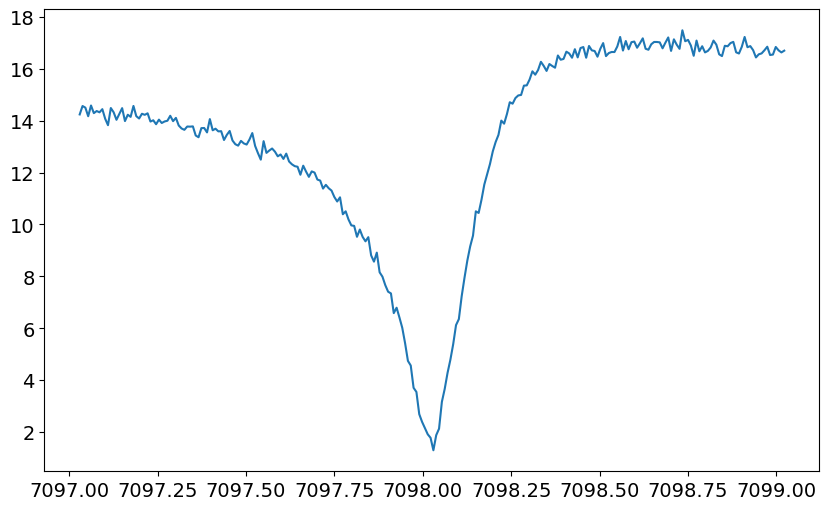

In [22]:
amp_value = np.min(rspec.data['amps'])
frequency = rspec.data['xpts'][np.where(rspec.data['amps'] == amp_value)]

plt.plot(rspec.data['xpts'], rspec.data['amps'])
print(frequency[0])

In [13]:
# open the results config file 
with open(cfg_file,'r') as file:
  auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 

# assign the resonator frequency to the results config file
auto_cfg.device.readout.frequency[qubit_i] = float(rspec.data['lorentz_fit'][2])
auto_cfg.device.readout.kappa[qubit_i] = float(2*rspec.data['lorentz_fit'][3])  

auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True)

# write it: 
with open('autocalibration_cfg.yml', 'w') as modified_file:
  modified_file.write(auto_cfg)
# now, open the modified file again 
with open('autocalibration_cfg.yml','r') as file:
  auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 

print(f'*Set cfg res {qubit_i} freq to {auto_cfg.device.readout.frequency[qubit_i]} Mhz*')
print(f'*Set cfg res {qubit_i} kappa to {auto_cfg.device.readout.kappa[qubit_i]} MHz*')

*Set cfg res 0 freq to 7098.094026730655 Mhz*
*Set cfg res 0 kappa to 0.2759034888460681 MHz*


  0%|          | 0/250000 [00:00<?, ?it/s]

Found peak in amps at [MHz] 3570.6280533122963, HWHM 0.1936569998456466
Found peak in I at [MHz] 3570.6282630442897, HWHM 0.1951452858523585
Found peak in Q at [MHz] 3570.6169339775834, HWHM 0.16194641646471378


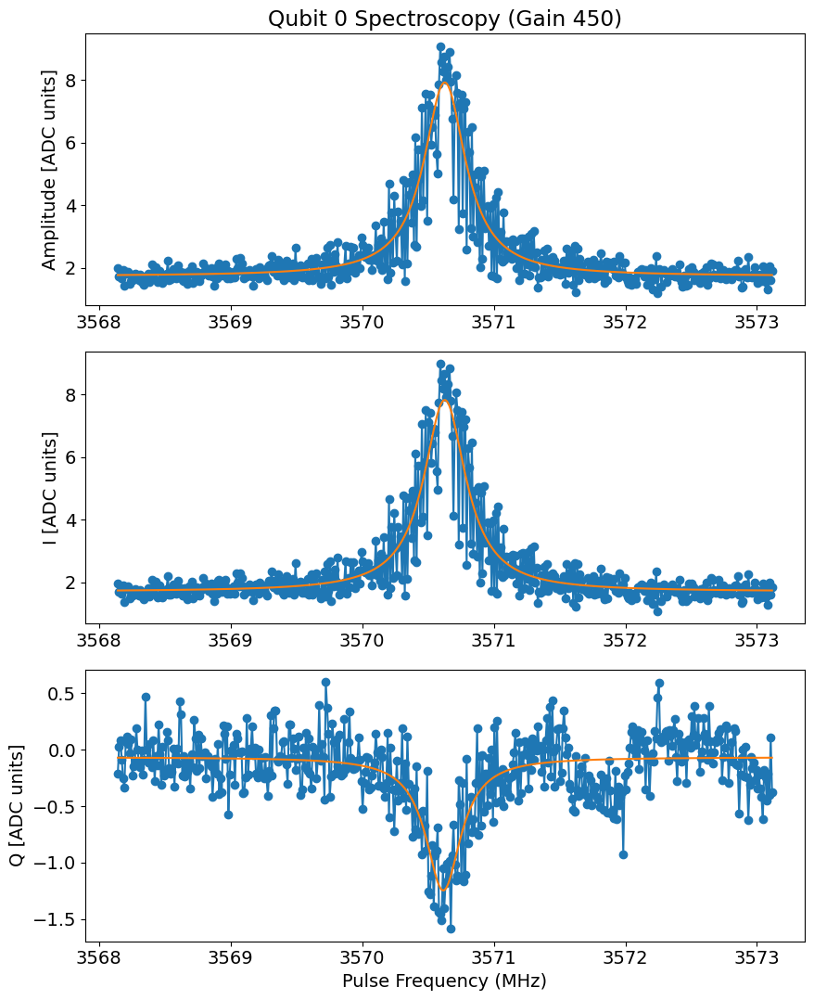

In [23]:
qspec = meas.PulseProbeSpectroscopyExperiment(
    soccfg=soc,
    path = expt_path, 
    prefix = f"qubit_spectroscopy_qubit{qubit_i}",
    config_file=cfg_path,
    )

span = 5 
npts = 500

qspec.cfg.expt = dict(
    start= qspec.cfg.device.qubit.f_ge[qubit_i]-span/2, # qubit frequency to be mixed up [MHz]
    step = span/npts, # min step ~1 Hz
    expts = npts, # Number experiments stepping from start
    reps = 500, # Number averages per point
    rounds = 1, #Number of start to finish sweeps to average over 
    length = 50, # qubit probe constant pulse length [us]
    gain = 450, #qubit pulse gain  
    pulse_type = 'const', 
    #pulse_type = 'gauss',  
    qubit = qubit_i,
) 

qspec.cfg.device.readout.relax_delay = 10 # Wait time between experiments [us]
qspec.go(analyze=False, display=False, progress=True, save=False)

qspec.analyze(fit=True, signs = [1,-1,1])
qspec.display(fit=True, signs= [1, -1, 1])


In [24]:
# open the results config file 
with open(cfg_file,'r') as file:
  auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 

# assign the qubit frequency to the results config file
auto_cfg.device.qubit.f_ge[qubit_i] = float(qspec.data["fit_amps"][2])
auto_cfg.device.qubit.kappa[qubit_i] = float(2*qspec.data["fit_amps"][3])
auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True) # dump it 

# write it:
with open('autocalibration_cfg.yml', 'w') as modified_file:
  modified_file.write(auto_cfg)
# now, open the modified file again 
with open('autocalibration_cfg.yml','r') as file:
  auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 


print(f'*Set cfg qubit {qubit_i} freq to {auto_cfg.device.qubit.f_ge[qubit_i]} MHz*')
print(f'*Set cfg qubit {qubit_i} kappa to {auto_cfg.device.qubit.kappa[qubit_i]} MHz*')

*Set cfg qubit 0 freq to 3570.6280533122963 MHz*
*Set cfg qubit 0 kappa to 0.3873139996912932 MHz*


  0%|          | 0/300 [00:00<?, ?it/s]

Attempted to init fitparam 1 to 184.11451505016723, which is out of bounds 0.14432214765100673 to 21.648322147651008. Instead init to 10.896322147651007
Attempted to init fitparam 1 to 184.11451505016723, which is out of bounds 0.14432214765100673 to 21.648322147651008. Instead init to 10.896322147651007
Decay from avgi [us] 0.2078683035714286
Pi length from avgi data [us]: 0.07975045647424701
	Pi/2 length from avgi data [us]: 0.03987522823712351

Decay from avgq [us] 0.6368214498697397
Pi length from avgq data [us]: 0.16401944995271794
Pi/2 length from avgq data [us]: 0.08200972497635897


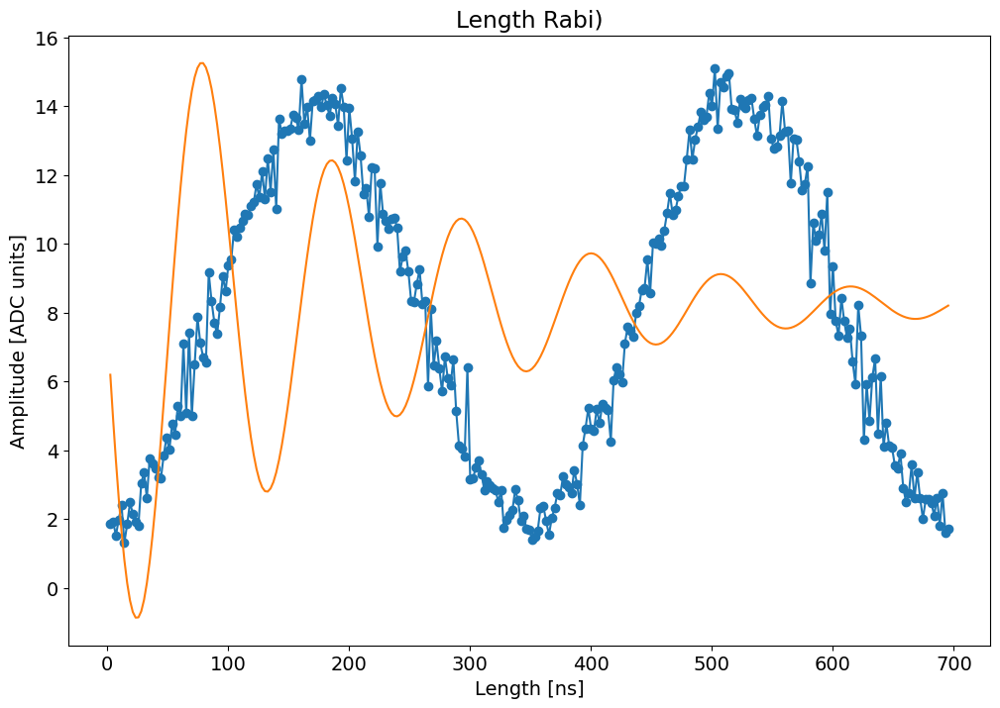

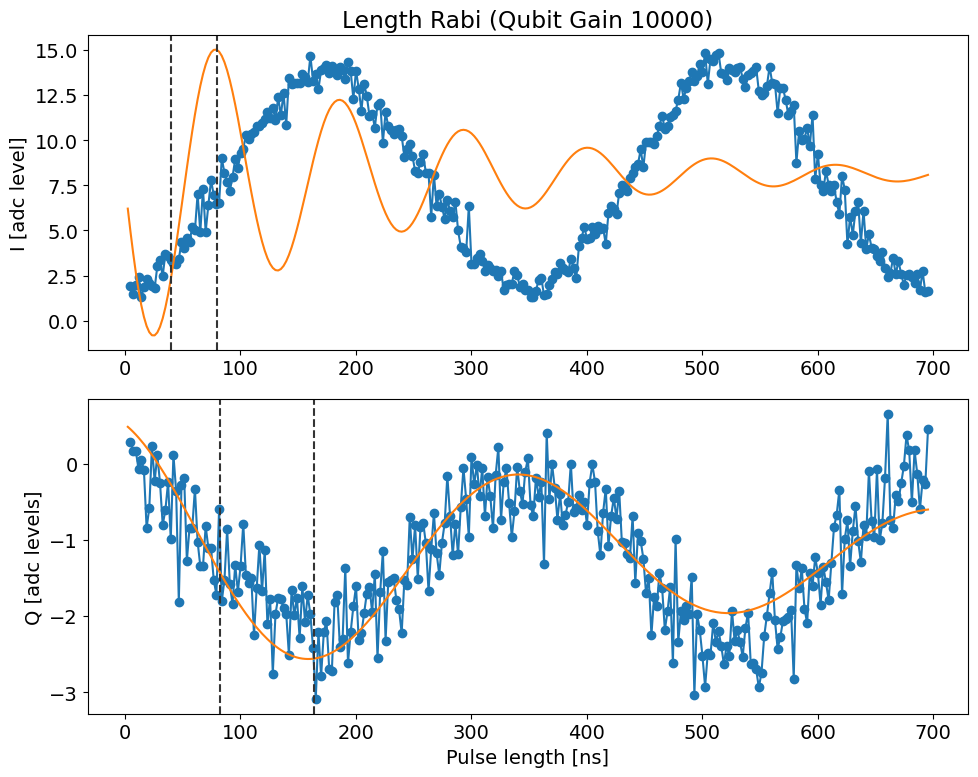

In [25]:
# Length Rabi

lengthrabi = meas.LengthRabiExperiment(
    soccfg=soc,
    path=expt_path,
    prefix=f"length_rabi_qubit{qubit_i}",
    config_file=cfg_path,
)

lengthrabi.cfg.expt = dict(
    start =  0.0025, 
    step=  soc.cycles2us(1), # [us] this is the samllest possible step size (size of clock cycle)
    expts= 300 , #51 #number of experiments stepping from start to end 
    reps= 100, #2000
    gain = 10000, #qubit gain [DAC units]
    #gain=lengthrabi.cfg.device.qubit.pulses.pi_ge.gain[qubit_i],
    pulse_type='gauss',
    # pulse_type='const',
    checkZZ=False,
    checkEF=False, 
    qubits=[qubit_i],
    num_pulses = 1, #number of pulses to play, must be an odd number 
)

import Pyro4.util
try:
    lengthrabi.go(analyze=False, display=False, progress=True, save=False)
except Exception:
    print("Pyro traceback:")
    print("".join(Pyro4.util.getPyroTraceback()))

lengthrabi.analyze(fit=True)
lengthrabi.display(fit=True)


***NOTE: NEED TO FIND BETTER WAY TO SAVE THE PI LENGTH (MAKE SURE NOT SAVING A CRAPPY PI LENGTH --> LOOK AT ERROR RATIO BETWEEN PI LENGTH AND I / Q DATA)

In [26]:

# save the pi pulse length to the results config file
p = lengthrabi.data['fit_avgi']     
if p[2] > 180: p[2] = p[2] - 360
elif p[2] < -180: p[2] = p[2] + 360
if p[2] < 0: pi_lengthi = (1/2 - p[2]/180)/2/p[1]
else: pi_lengthi= (3/2 - p[2]/180)/2/p[1]

p = lengthrabi.data['fit_avgq']     
if p[2] > 180: p[2] = p[2] - 360
elif p[2] < -180: p[2] = p[2] + 360
if p[2] < 0: pi_lengthq = (1/2 - p[2]/180)/2/p[1]
else: pi_lengthq= (3/2 - p[2]/180)/2/p[1]

# open the results config file 
with open(cfg_file,'r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary

auto_cfg.device.qubit.pulses.pi_ge.sigma[qubit_i] = float(pi_lengthq)  # [us] (pi pulse length)


auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True) # dump it 

# write it: 
with open('autocalibration_cfg.yml', 'w') as modified_file:
    modified_file.write(auto_cfg)
# now, open the modified file again 
with open('autocalibration_cfg.yml','r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 

print(f'*Set cfg qubit {qubit_i} rabi length to {auto_cfg.device.qubit.pulses.pi_ge.sigma[qubit_i]}* us')



*Set cfg qubit 0 rabi length to 0.16401944995271794* us


qTest =  0.16401944995271794
gauss


  0%|          | 0/20000 [00:00<?, ?it/s]

Pi gain from amps data [dac units]: 10582
	Pi/2 gain from amps data [dac units]: 5291
Pi gain from avgi data [dac units]: 10579
	Pi/2 gain from avgi data [dac units]: 5289
Pi gain from avgq data [dac units]: 10315
	Pi/2 gain from avgq data [dac units]: 5157


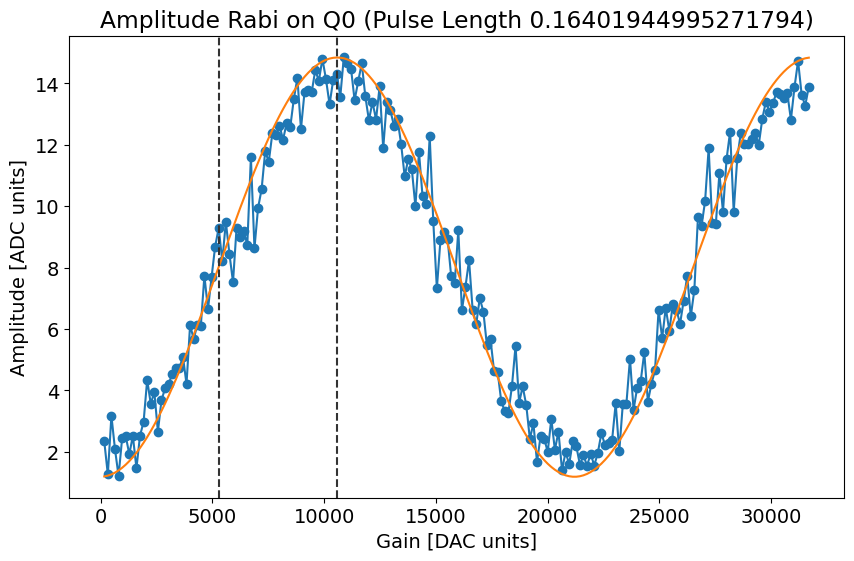

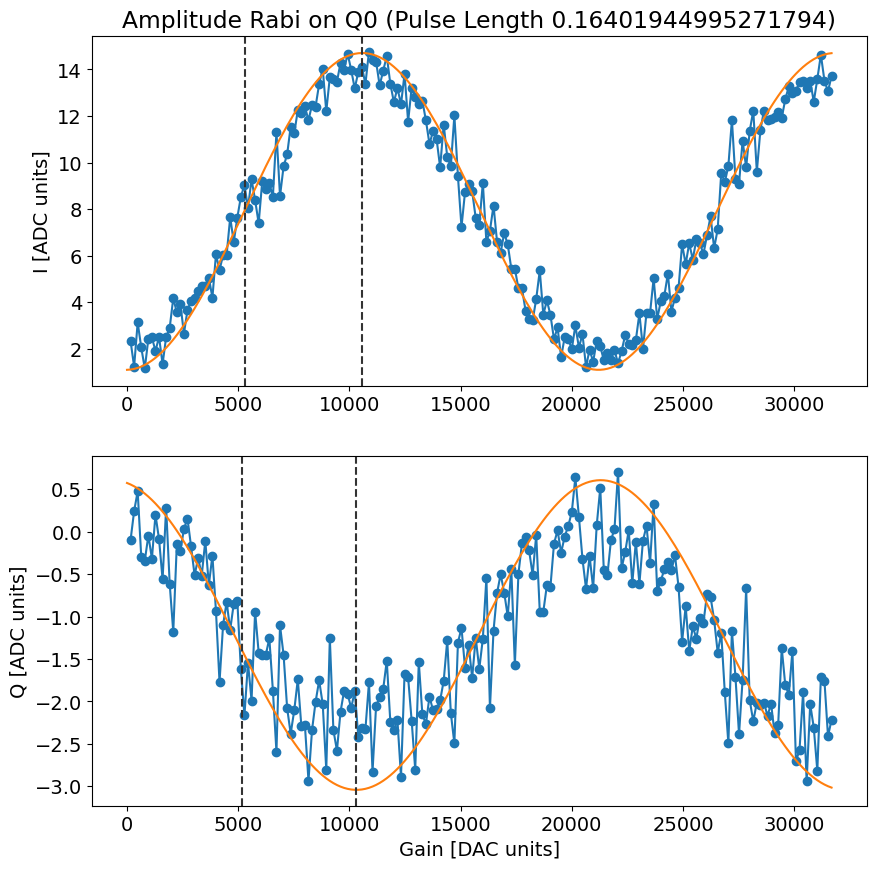

In [27]:
# Amplitude Rabi
amprabi = meas.AmplitudeRabiExperiment(
    soccfg=soc,
    path=expt_path,
    prefix=f"amp_rabi_qubit{qubit_i}",
    config_file=cfg_path,
)

span = 32000
npts = 200
amprabi.cfg.expt = dict(
    start= 0,
    step=int(span/npts), # [dac level]
    expts=npts,
    reps=100,
    rounds=1,
    sigma_test= auto_cfg.device.qubit.pulses.pi_ge.sigma[qubit_i], # gaussian sigma for pulse length - overrides config [us]
    checkZZ=False,
    checkEF=False, 
    qubits=[qubit_i],
    pulse_type='gauss',
    # pulse_type='const',
    num_pulses = 1, #number of pulses to play, must be an odd number in order to achieve a pi rotation at pi length/ num_pulses 
)

import Pyro4.util
try:
    amprabi.go(analyze=False, display=False, progress=True, save=False)
except Exception:
    print("Pyro traceback:")
    print("".join(Pyro4.util.getPyroTraceback()))

amprabi.analyze(fit=True)
amprabi.display(fit=True)

***NOTE: NEED TO FIND BETTER WAY TO SAVE THE PI LENGTH (MAKE SURE NOT SAVING A CRAPPY PI LENGTH --> LOOK AT ERROR RATIO BETWEEN PI LENGTH AND I / Q DATA)

In [28]:
p = amprabi.data['fit_avgi']
if p[2] > 180: p[2] = p[2] - 360
elif p[2] < -180: p[2] = p[2] + 360
if p[2] < 0: pi_gaini = (1/2 - p[2]/180)/2/p[1]
else: pi_gaini= (3/2 - p[2]/180)/2/p[1]

p = amprabi.data['fit_avgq']
if p[2] > 180: p[2] = p[2] - 360
elif p[2] < -180: p[2] = p[2] + 360
if p[2] < 0: pi_gainq = (1/2 - p[2]/180)/2/p[1]
else: pi_gainq = (3/2 - p[2]/180)/2/p[1]


# open the results config file 
with open(cfg_file,'r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary

auto_cfg.device.qubit.pulses.pi_ge.gain[qubit_i] = int(pi_gaini)  # [DAC units]  

auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True) # dump it 

# write it: 
with open('autocalibration_cfg.yml', 'w') as modified_file:
    modified_file.write(auto_cfg)
# now, open the modified file again 
with open('autocalibration_cfg.yml','r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 

print(f'*Set cfg qubit {qubit_i} rabi amplitude to {auto_cfg.device.qubit.pulses.pi_ge.gain[qubit_i]}* DAC units')


*Set cfg qubit 0 rabi amplitude to 10579* DAC units


In [98]:
shot = meas.HistogramExperiment(
    soccfg=soc,
    path=expt_path,
    prefix=f"single_shot_qubit{qubit_i}",
    config_file= cfg_path,
)

shot.cfg.expt = dict(
    reps=1000,
    check_e = True, 
    check_f=False,
    qubit=0,
)

shot.go(analyze=False, display=False, progress=True, save=True)

using phase reset
<Pyro4.core.Proxy at 0x28c75720b80; not connected; for PYRO:obj_e0a12d402d674a73a40b28fdfe13addf@192.168.137.233:40721>


  0%|          | 0/1000 [00:00<?, ?it/s]

using phase reset


  0%|          | 0/1000 [00:00<?, ?it/s]

Saving c:\_Lib\python\rfsoc\elaine_rfsoc\slab_rfsoc_expts\00024_single_shot_qubit0.h5


Unrotated:
Ig 1.0257535021932926 +/- 3.475207311378478 	 Qg 0.5237017121833876 +/- 3.4123942188501752 	 Amp g 1.1517090477223912
Ie 10.15579453799349 +/- 4.504049684394578 	 Qe 0.7135276637894439 +/- 3.345041258135371 	 Amp e 10.180829260179705
Rotated:
Ig 1.0435913677812225 +/- 3.475207311378478 	 Qg 0.48359910448801846 +/- 3.4123942188501752 	 Amp g 1.1501960862257774
Ie 10.167057818819263 +/- 4.504049684394578 	 Qe 0.44851408927363967 +/- 3.345041258135371 	 Amp e 10.176945984896001


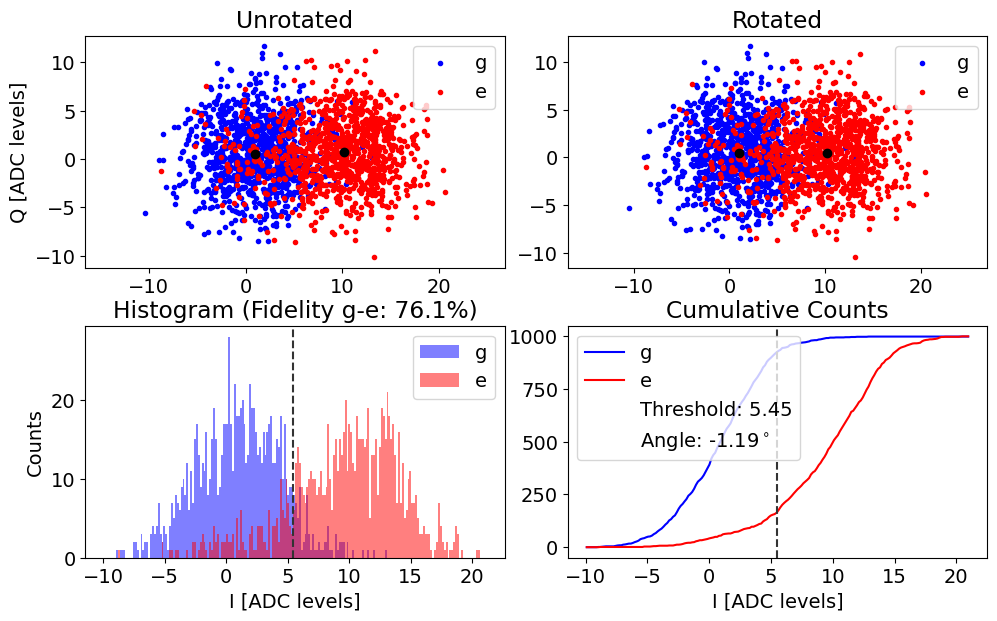

ge fidelity (%): 76.13806903451726
rotation angle (deg): -1.1910854550489562
threshold ge: 5.450241817147646


In [99]:
# # TESTING
shot.analyze(verbose=False)
shot.display(verbose=True, p








































lot_f=False)

In [97]:
with open(cfg_file,'r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary

auto_cfg.device.readout.phase[qubit_i] = 9.9115919221181 # degrees
# auto_cfg.device.readout.threshold[qubit_i] = 57.221847452942725 # [DAC units]
    
auto_cfg.device.readout.gain[qubit_i] = 10000 # [DAC units]
auto_cfg.device.readout.readout_length[qubit_i] = 23 # [us]
# auto_cfg.device.readout.frequency[qubit_i] = 7098.022026730655

auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True) # dump it 

# write it: 
with open('autocalibration_cfg.yml', 'w') as modified_file:
    modified_file.write(auto_cfg)
# now, open the modified file again 
with open('autocalibration_cfg.yml','r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary

In [53]:
qubit_i = 0

  0%|          | 0/25000 [00:00<?, ?it/s]

Saving c:\_Lib\python\rfsoc\elaine_rfsoc\slab_rfsoc_expts\00000_t1_qubit0.h5
Fit T1 avgi [us]: 140.79570726285655
Fit T1 avgq [us]: 128.76147413623656


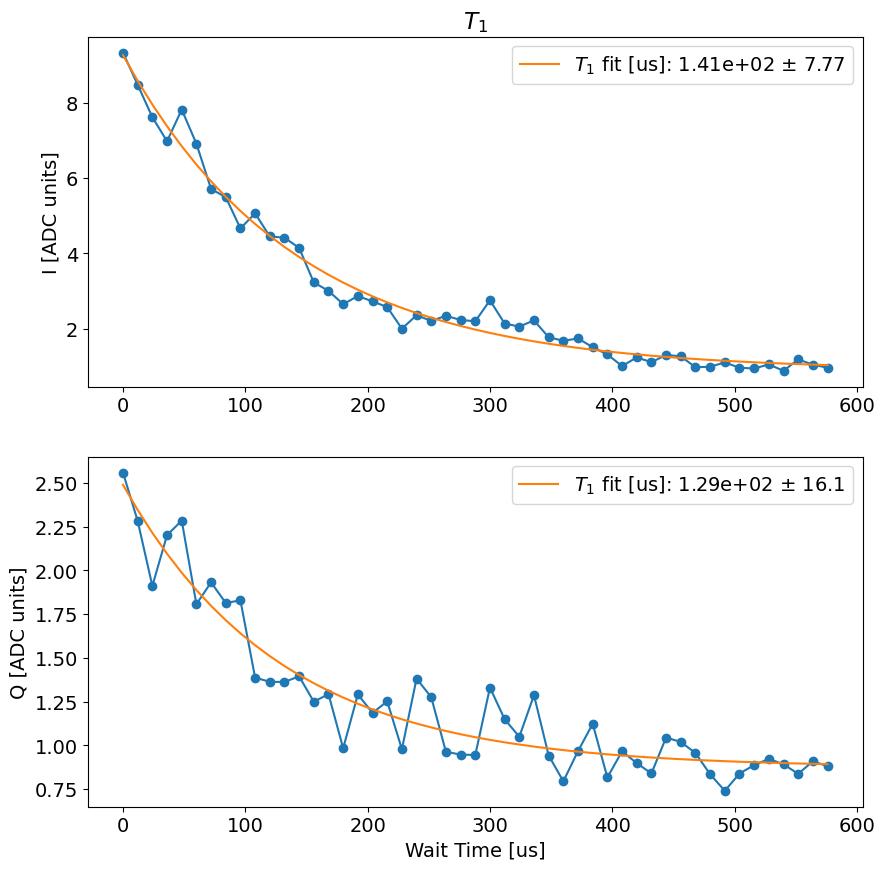

In [100]:
# T1 
t1 = meas.T1Experiment(
    soccfg=soc,
    path=expt_path,
    prefix=f"t1_qubit{qubit_i}",
    config_file= cfg_path,
)

span = 600 
npts = 50

t1.cfg.expt = dict(
    start=0, # wait time [us]
    step=int(span/npts), 
    expts=npts,
    reps=5*100, # number of times we repeat a time point 
    rounds=1, # number of start to finish sweeps to average over
    qubit=qubit_i,
    length_scan = span, # length of the scan in us
    num_saved_points = 0, # number of points to save for the T1 continuous scan 
)

t1.go(analyze=False, display=False, progress=True, save=True)
t1.analyze(fit=True)
t1.display()

In [101]:
t1_err_i = np.sqrt(t1.data['fit_err_avgi'][3][3])
t1_fit_i =t1.data['fit_avgi'][3]
err_ratio_i = t1_err_i/t1_fit_i
print('t1_i error:fit ratio=', err_ratio_i)

t1_err_q = np.sqrt(t1.data['fit_err_avgq'][3][3])
t1_fit_q =t1.data['fit_avgq'][3]
err_ratio_q = t1_err_q/t1_fit_q
print('t1_q error:fit ratio=', err_ratio_q)

# open the results config file 
with open(cfg_file,'r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary

if err_ratio_i< err_ratio_q:
    print('t1_i is better, saving T1_i to results cfg file') 
    auto_cfg.device.qubit.T1[qubit_i] = float(t1_fit_i)  # [DAC units]  

else: 
    print('t1_q is better, saving t1_q to results cfg file')
    auto_cfg.device.qubit.T1[qubit_i] = float(t1_fit_q)  # [DAC units]  

auto_cfg= yaml.safe_dump(auto_cfg.to_dict(), default_flow_style=  True) # dump it 

# write it: 
with open('autocalibration_cfg.yml', 'w') as modified_file:
    modified_file.write(auto_cfg)
# now, open the modified file again 
with open('autocalibration_cfg.yml','r') as file:
    auto_cfg=AttrDict(yaml.safe_load(file)) # turn it into an attribute dictionary 

print(f'*Set cfg qubit {qubit_i} T1 to {auto_cfg.device.qubit.T1[qubit_i]}* us')

t1_i error:fit ratio= 0.05517387309068736
t1_q error:fit ratio= 0.12527723868882668
t1_i is better, saving T1_i to results cfg file
*Set cfg qubit 0 T1 to 140.79570726285655* us


In [18]:
print(np.shape(t1.data['avgi']))

(200,)


Readout Optimization

In [23]:
shotopt = meas.SingleShotOptExperiment(
    soccfg=soc,
    path=expt_path,
    prefix=f"single_shot_opt_qubit{qubit_i}",
    config_file=cfg_path,
)

span_f = 1 # MHz
npts_f = 5

span_gain = 0.07
# npts_gain = 2
npts_gain = 7

span_len = 9 # us
npts_len = 3

shotopt.cfg.expt = dict(
    reps=100000,
    qubit=qubit_i,

    start_f=shotopt.cfg.device.readout.frequency[qubit_i] - 0.5*span_f,
    step_f=span_f/npts_f,
    expts_f=npts_f,

    start_gain=0.01,
    step_gain=span_gain/npts_gain,
    expts_gain=npts_gain,

    start_len=3,
    step_len=span_len/npts_len,
    expts_len=npts_len,
)

print(shotopt.cfg)

shotopt.go(analyze=False, display=False, progress=True, save=False)

{'aliases': {'readout_LO': 'SC_26C1', 'soc': 'Qick233'}, 'device': {'qubit': {'T1': [119.64880616178345, 100, 100, 100, 177.46967033548438, 100], 'f_EgGf': [2000, 2000, 2000, 2000, 2000, 2000], 'f_ef': [4000, 4000, 4000, 4000, 4000, 4000], 'f_ge': [3571.1876956515216, 3309, 3300, 3300, 3267.9508134627254, 3300], 'kappa': [0.2304026448276766, 0, 0, 0, 0.5450565427872616, 0], 'pulses': {'hpi_ge': {'gain': [500, 500, 500, 500, 500, 500], 'sigma': [0.05889005791993152, 0.2, 0.2, 0.2, 0.05344152043448767, 0.2], 'type': ['gauss', 'gauss', 'gauss', 'gauss', 'gauss', 'gauss']}, 'pi_EgGf': {'gain': 10000, 'sigma': 0.1, 'type': ['gauss', 'gauss', 'gauss', 'gauss', 'gauss', 'gauss']}, 'pi_ef': {'gain': 10000, 'sigma': 0.1, 'type': ['gauss', 'gauss', 'gauss', 'gauss', 'gauss', 'gauss']}, 'pi_ge': {'gain': [18342, 1000, 1000, 1000, 15070, 1000], 'sigma': [0.09828914459485547, 0.01, 0.01, 0.01, 0.10688304086897533, 0.01], 'type': ['gauss', 'gauss', 'gauss', 'gauss', 'gauss', 'gauss']}}}, 'readout': 

  0%|          | 0/5 [00:00<?, ?it/s]

TypeError: ufunc 'left_shift' not supported for the input types, and the inputs could not be safely coerced to any supported types according to the casting rule ''safe''